# Load packages

In [1]:
# Loading the required packages to run this notebook
from src.visualisation.SummaryModels import SummaryModels
import src.utils.utils as utils
from src.visualisation.VisualiseTrajectories import VisualiseTrajectories
from src.data.Datasets import AISDataset
from pathlib import Path
import pandas as pd

# Define the region to look into
region = "Bornholm"
zoom = 8
n = 10

In [2]:
# Use the SummaryModels class for everything related to the reconstructions
file_name = "RegionBornholm_01062019_30092019_Fish_14400_86400_600"
generative_dist = "Diagonal"
learning_rate = 0.003
scheduler_gamma = [0.6, 0.6, 0.5, 0.6, 0.6, 0.5, 0.5]
scheduler_milestones = [25, 50, 100, 150, 200, 250, 400]
use_generative_bias = True

# Use the SummaryModels class
summary_models = SummaryModels(file_name, generative_dist=generative_dist, learning_rate=learning_rate,
                               scheduler_gamma=scheduler_gamma, scheduler_milestones=scheduler_milestones,
                               use_generative_bias=use_generative_bias)

In [3]:
# Use the VisualiseTrajectories class for geographically visualising trajectories 
fig_size = (10, 10)
visualise_trajectories = VisualiseTrajectories(region, save_figures=False, plot_figures=True, fig_size=fig_size, zoom=zoom)
processed_data_dir =  visualise_trajectories.processed_data_dir

# Read the info file to know how to read the data file
data_file = processed_data_dir / ("data_" + file_name + ".pkl")
data_info_file = processed_data_dir / ("datasetInfo_" + file_name + ".pkl")
data_info = utils.read_data_info_file(data_info_file)

# Load the static Google Map image for the RIO
img = visualise_trajectories.read_static_map()

In [4]:
# Function that plots the actual and reconstructed side by side
def plot_actual_reconstructed(idx):
    # Setup for the plotting
    fig_size_tmp = visualise_trajectories.fig_size
    visualise_trajectories.fig_size = (20,10)
    fig, ax = visualise_trajectories.visualise_static_map(img, subplots=[1, 2])
    plot_figures_tmp = visualise_trajectories.plot_figures
    visualise_trajectories.plot_figures = False
        
    # For plotting a single complete vessel trajectory on the static map
    index = df_n.iloc[idx]["Index"]
    data_set = AISDataset(file_name, data_info=data_info, indicies=[index], discrete=False)
    df_actual = utils.get_tracks_from_dataset(data_set, continuous_representation=True)
    
    # For plotting the corresponding model reconstruction
    index = df_n.iloc[idx]["Data set Index"]
    data_set = train_evaluate.validation_dataloader.dataset
    reconstruction = train_evaluate.track_reconstructions(data_set, index)
    
    df_recon = reconstruction["Reconstruction"][2:]
    
    # Setup actual and reconstruction data frames
    df_speed = utils.concat_actual_recon(df_actual, df_recon, "Speed")
    df_course = utils.concat_actual_recon(df_actual, df_recon, "Course")
    df_speed["Type"] = df_speed["Type"].str.replace("Actual", "Actual speed")
    df_course["Type"] = df_course["Type"].str.replace("Actual", "Actual course")
    
    # Do the actual plotting
    visualise_trajectories.plot_single_track(df_actual, ax[0], use_cmap=True, df_speed=df_speed,
                                                      df_course=df_course, fig=fig, rect=[0.15, 0.72, 0.12, 0.12], 
                                                      rect2=[0.575, 0.72, 0.12, 0.12])
    visualise_trajectories.plot_figures = plot_figures_tmp
    visualise_trajectories.plot_single_track(df_recon, ax[1], use_cmap=True)
    visualise_trajectories.fig_size = fig_size_tmp
    print(df_recon)
    return {"Actual trajectory": df_actual, "Reconstructed trajectory": df_recon,
            "Speed data frame": df_speed, "Course data frame": df_course}

# Fishing Reconstruction Example

In [5]:
# Get some trajectories to show an example from 
data = summary_models.run_evaluation_get_n(n=100, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Diagonal_GBT_lr0003_S2550100150200250400_06060506060505.pth


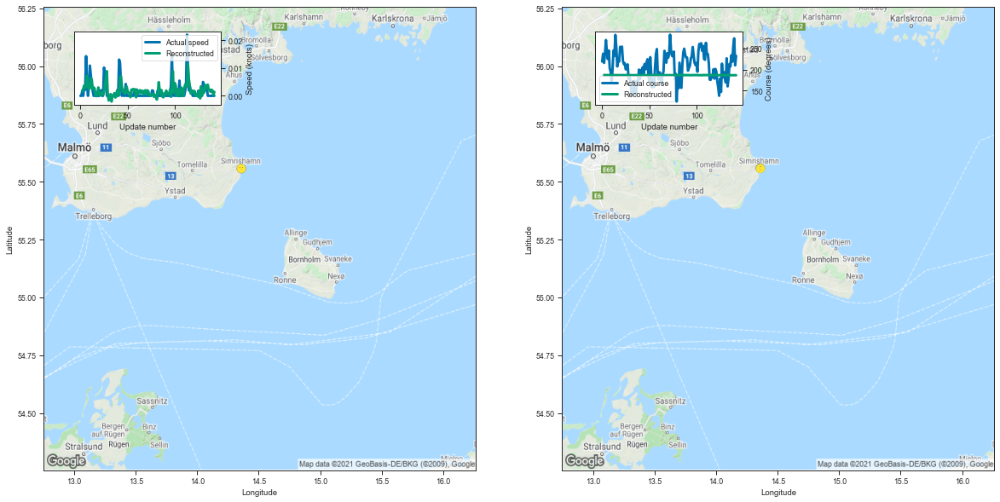

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.359711  55.558292  0.001493  186.878250         0.001575   
3    14.359583  55.558277  0.002588  186.797150         0.001166   
4    14.360686  55.557556  0.003665  186.755554         0.001044   
5    14.360396  55.558144  0.002867  186.518967         0.000800   
6    14.360403  55.558094  0.003846  186.823685         0.001072   
..         ...        ...       ...         ...              ...   
138  14.360437  55.558010  0.001443  186.428879         0.000694   
139  14.360615  55.557560  0.002215  186.446106         0.000707   
140  14.360633  55.558147  0.001879  186.587906         0.000823   
141  14.360331  55.558250  0.000273  186.454453         0.000722   
142  14.360492  55.557495  0.001431  186.412613         0.000683   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001528     0.010435     91.909400  
3          0.001086     0.009201     96.912599  
4          0.000962     0.008332    

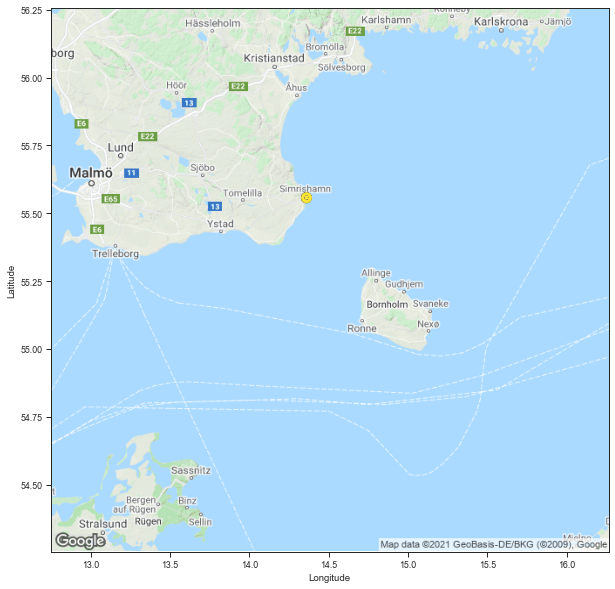

     Data set Index    Index       MMSI  Longitude   Latitude     Speed  \
0                 0  6685896  265759000  14.359031  55.556702  0.000000   
1                 0  6685896  265759000  14.359023  55.556713  0.000000   
2                 0  6685896  265759000  14.359054  55.556709  0.001923   
3                 0  6685896  265759000  14.359044  55.556709  0.000000   
4                 0  6685896  265759000  14.359061  55.556709  0.003571   
..              ...      ...        ...        ...        ...       ...   
138               0  6685896  265759000  14.359066  55.556721  0.000000   
139               0  6685896  265759000  14.359043  55.556709  0.000000   
140               0  6685896  265759000  14.359036  55.556713  0.000000   
141               0  6685896  265759000  14.359025  55.556694  0.000000   
142               0  6685896  265759000  14.359023  55.556709  0.000000   

         Course Ship type  Track length          Time stamp  
0    219.074280   Fishing           1

,Longitude,Latitude,Speed,Course,Longitude sigma,Latitude sigma,Speed sigma,Course sigma
2,14.359711,55.558292,0.001493,186.878250,0.001575,0.001528,0.010435,91.909400
3,14.359583,55.558277,0.002588,186.797150,0.001166,0.001086,0.009201,96.912599
4,14.360686,55.557556,0.003665,186.755554,0.001044,0.000962,0.008332,98.380157
5,14.360396,55.558144,0.002867,186.518967,0.000800,0.000756,0.003704,97.898215
6,14.360403,55.558094,0.003846,186.823685,0.001072,0.000967,0.010972,99.782694
...,...,...,...,...,...,...,...,...
138,14.360437,55.558010,0.001443,186.428879,0.000694,0.000652,0.002655,98.787384
139,14.360615,55.557560,0.002215,186.446106,0.000707,0.000662,0.002825,98.858421
140,14.360633,55.558147,0.001879,186.587906,0.000823,0.000758,0.004739,99.336382
141,14.360331,55.558250,0.000273,186.454453,0.000722,0.000678,0.002950,98.648638


In [6]:
# Plot the actual and reconstructed trajectories side by side
tracks = plot_actual_reconstructed(3)

# Plot them on the same figure
visualise_trajectories.fig_size = fig_size
plot_figures_tmp = visualise_trajectories.plot_figures
fig, ax = visualise_trajectories.visualise_static_map(img)
visualise_trajectories.plot_figures = False
visualise_trajectories.plot_single_track(tracks["Actual trajectory"], ax, use_cmap=True)
visualise_trajectories.plot_figures = plot_figures_tmp
visualise_trajectories.plot_single_track(tracks["Reconstructed trajectory"], ax, use_cmap=True)

print(tracks['Actual trajectory'])
tracks['Reconstructed trajectory']

# Best Fishing Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Diagonal_GBT_lr0003_S2550100150200250400_06060506060505.pth


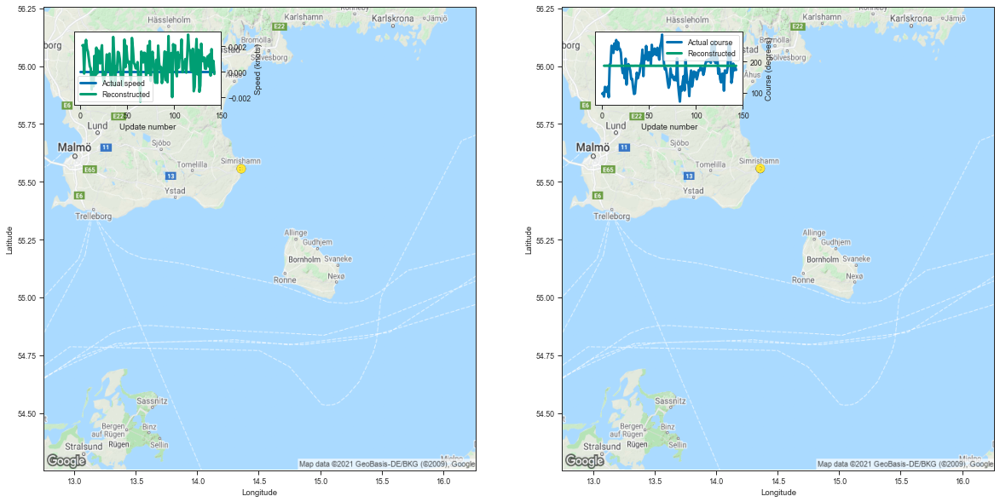

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.358908  55.556812  0.002059  186.637207         0.001216   
3    14.358236  55.557114  0.002103  186.478210         0.000812   
4    14.359012  55.558517 -0.000134  186.568069         0.000837   
5    14.359756  55.557545  0.001982  186.786758         0.001029   
6    14.359164  55.558071  0.002499  186.607101         0.000869   
..         ...        ...       ...         ...              ...   
139  14.359665  55.557159 -0.000294  186.665359         0.000883   
140  14.359592  55.557095  0.001776  186.505981         0.000761   
141  14.358975  55.558399  0.000114  186.555603         0.000799   
142  14.359613  55.557549  0.000849  186.511612         0.000763   
143  14.359516  55.557785 -0.000167  186.477951         0.000732   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001210     0.004498     91.195692  
3          0.000778     0.002983     96.391617  
4          0.000780     0.004273    

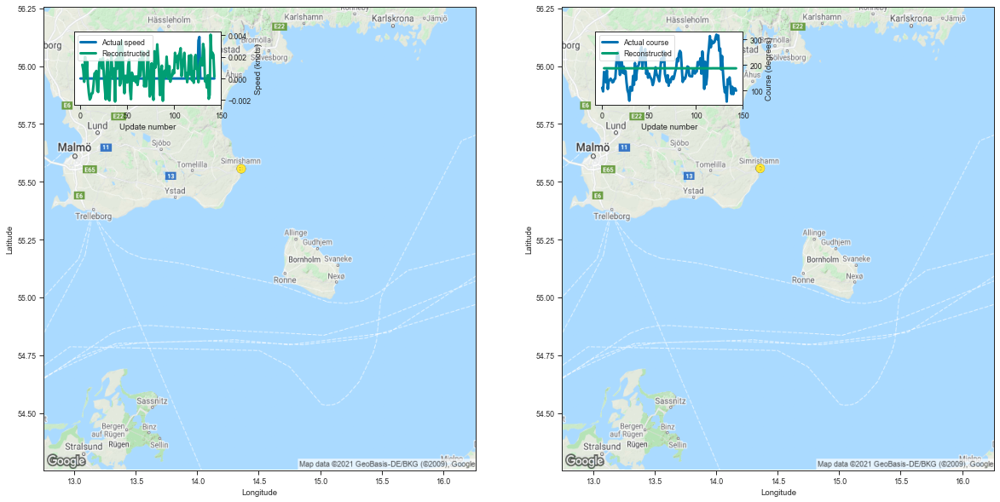

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.358311  55.557789  0.001277  186.670639         0.001258   
3    14.358240  55.558403  0.000809  186.508041         0.000846   
4    14.359631  55.556820 -0.000309  186.666367         0.000928   
5    14.358991  55.557419  0.002013  186.592453         0.000853   
6    14.359170  55.557590  0.000227  186.461380         0.000732   
..         ...        ...       ...         ...              ...   
139  14.358320  55.557724  0.004064  186.602036         0.000825   
140  14.359247  55.557995  0.001912  186.433350         0.000702   
141  14.358096  55.557880  0.002383  186.500870         0.000744   
142  14.359661  55.557549  0.002188  186.592758         0.000825   
143  14.359324  55.557953  0.000169  186.437347         0.000704   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001249     0.005061     91.268828  
3          0.000812     0.003265     96.156671  
4          0.000855     0.006067    

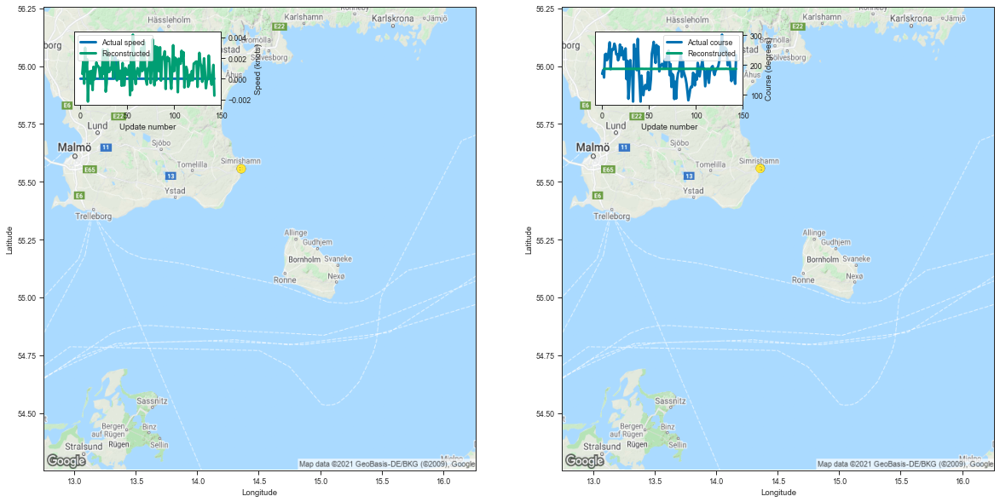

     Longitude   Latitude         Speed      Course  Longitude sigma  \
2    14.359582  55.558086  4.737377e-04  186.710022         0.001332   
3    14.358850  55.557407  1.661777e-03  186.640686         0.000976   
4    14.359053  55.558186 -4.825592e-04  186.705383         0.000982   
5    14.359733  55.557560  3.005505e-03  186.750900         0.001019   
6    14.358975  55.557770  7.138252e-04  186.616867         0.000879   
..         ...        ...           ...         ...              ...   
139  14.358823  55.557514  4.768372e-07  186.453735         0.000713   
140  14.358835  55.557457 -5.815029e-04  186.507309         0.000753   
141  14.359777  55.556862  1.275539e-04  186.414154         0.000684   
142  14.358977  55.557247  1.340628e-03  186.487732         0.000734   
143  14.358704  55.557480 -1.640558e-03  186.409561         0.000678   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001323     0.005804     91.038260  
3          0.000922     0.005284     

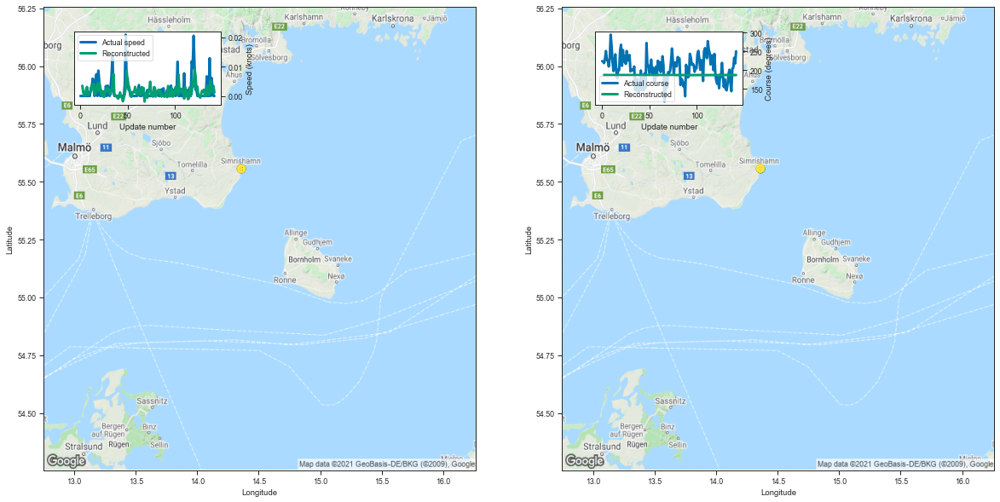

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.361118  55.556320  0.003479  186.954620         0.001701   
3    14.359093  55.557648  0.001188  186.564499         0.000918   
4    14.360439  55.557713  0.000310  186.740677         0.001011   
5    14.360127  55.557819  0.000112  186.511261         0.000791   
6    14.360578  55.556900  0.002197  186.527847         0.000784   
..         ...        ...       ...         ...              ...   
138  14.360076  55.556965  0.005228  186.406006         0.000676   
139  14.359846  55.557682  0.001272  186.608368         0.000836   
140  14.359321  55.558281  0.001314  186.416885         0.000693   
141  14.360276  55.557270  0.003432  186.608200         0.000838   
142  14.360340  55.557259  0.001174  186.572388         0.000817   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001629     0.013733     92.379176  
3          0.000881     0.004026     95.863112  
4          0.000931     0.007820    

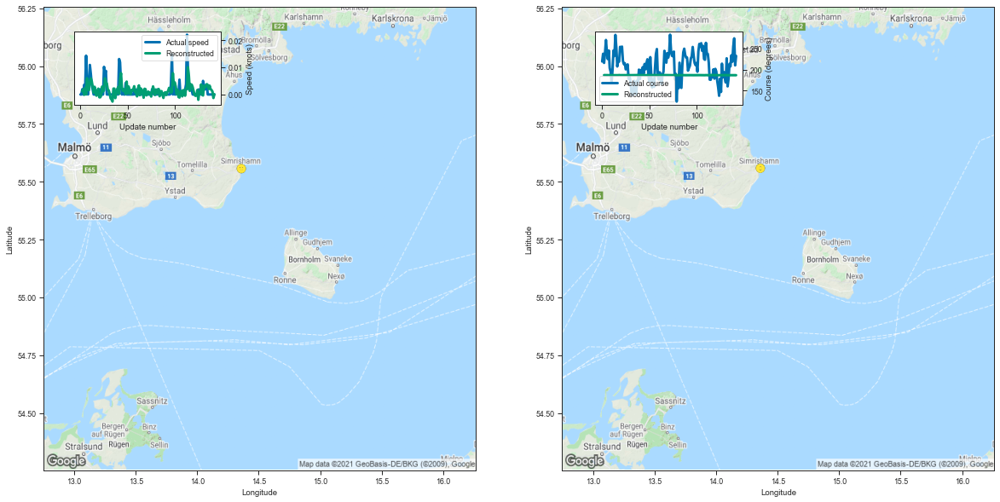

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.359883  55.558765  0.001214  186.612534         0.001195   
3    14.359744  55.558437  0.001869  186.541519         0.000873   
4    14.359616  55.558968 -0.000109  186.555832         0.000832   
5    14.360381  55.558388  0.002410  186.516907         0.000785   
6    14.360159  55.558014  0.000002  186.497299         0.000759   
..         ...        ...       ...         ...              ...   
138  14.360899  55.558254  0.001982  186.714966         0.000947   
139  14.360487  55.557598  0.001636  186.502640         0.000765   
140  14.360807  55.557980  0.001064  186.480957         0.000739   
141  14.359840  55.559059 -0.001297  186.417297         0.000688   
142  14.359796  55.558258  0.000073  186.411346         0.000681   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001200     0.004075     90.802396  
3          0.000834     0.003676     96.386049  
4          0.000781     0.004070    

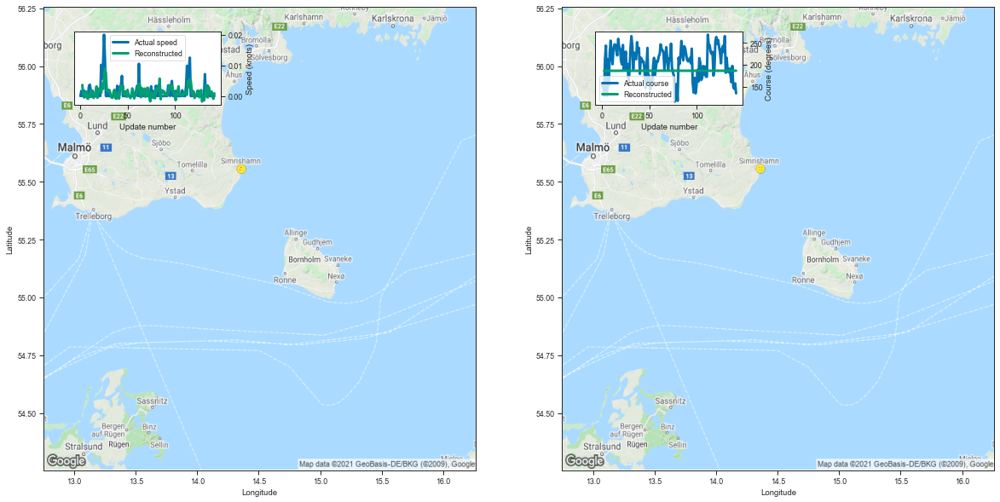

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.360295  55.556091  0.003606  186.683853         0.001283   
3    14.360265  55.556427  0.000654  186.569214         0.000900   
4    14.359711  55.557018 -0.000484  186.442276         0.000740   
5    14.360349  55.556835  0.001066  186.685425         0.000923   
6    14.360803  55.556385  0.001457  186.536224         0.000793   
..         ...        ...       ...         ...              ...   
138  14.360298  55.556072  0.000982  186.432632         0.000705   
139  14.360100  55.557167  0.001456  186.736969         0.000965   
140  14.361241  55.555916 -0.000099  186.531296         0.000786   
141  14.360672  55.556244 -0.000888  186.417084         0.000688   
142  14.360117  55.556557  0.000900  186.510406         0.000757   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001274     0.005232     91.186633  
3          0.000855     0.004084     96.541993  
4          0.000704     0.002693    

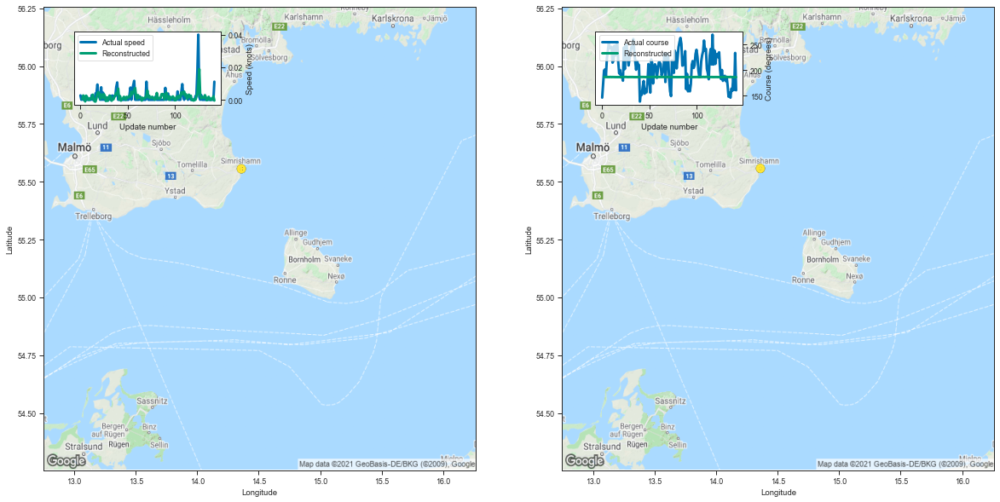

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.360329  55.557240  0.000467  186.610321         0.001190   
3    14.360025  55.557804  0.002658  186.664886         0.000995   
4    14.360186  55.557613  0.001982  186.517288         0.000806   
5    14.360110  55.557796 -0.000983  186.523788         0.000787   
6    14.360520  55.556744  0.002553  186.523773         0.000782   
..         ...        ...       ...         ...              ...   
138  14.360115  55.557735 -0.000123  186.596741         0.000827   
139  14.359214  55.557907  0.000797  186.418823         0.000694   
140  14.360393  55.558216  0.000223  186.561005         0.000801   
141  14.360205  55.557083  0.002194  186.469147         0.000730   
142  14.360145  55.557606 -0.000468  186.438461         0.000703   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001192     0.004020     90.869240  
3          0.000936     0.005731     96.848152  
4          0.000761     0.003544    

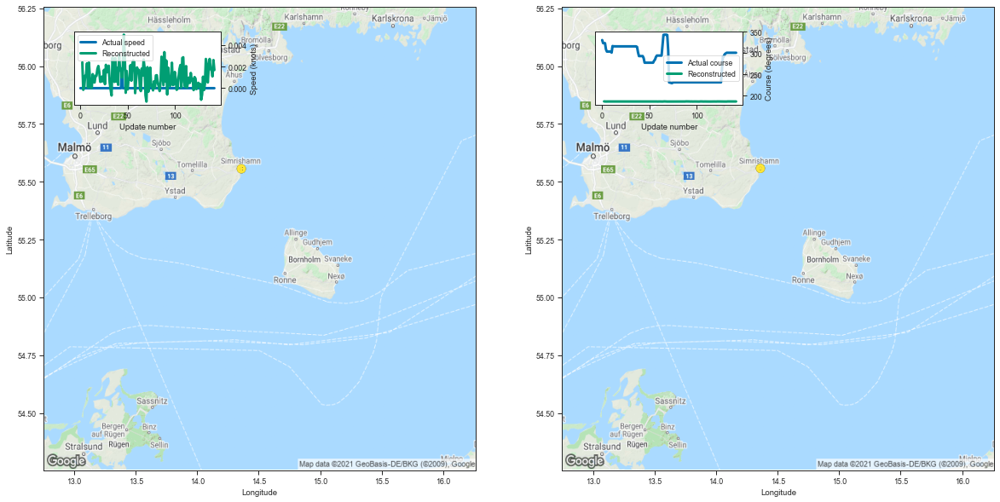

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.360061  55.557987  0.002395  186.805618         0.001454   
3    14.360451  55.557209 -0.000154  186.570663         0.000909   
4    14.360725  55.557625  0.000085  186.489532         0.000777   
5    14.361399  55.556942  0.001139  186.631592         0.000885   
6    14.360485  55.557457  0.001289  186.584946         0.000845   
..         ...        ...       ...         ...              ...   
138  14.360120  55.557587  0.001778  186.682877         0.000931   
139  14.360566  55.557289  0.001727  186.635574         0.000884   
140  14.359969  55.557751  0.001092  186.630524         0.000873   
141  14.360455  55.556999  0.002611  186.554398         0.000811   
142  14.360182  55.557762  0.001684  186.625076         0.000860   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001430     0.008087     91.545791  
3          0.000871     0.004202     96.265786  
4          0.000737     0.003263    

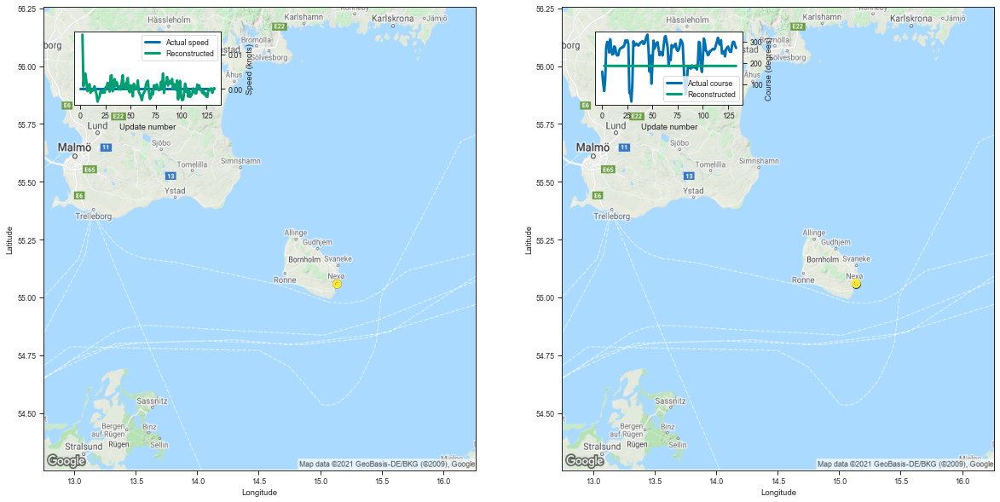

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.140325  55.056839  0.015697  186.785736         0.002167   
3    15.139471  55.058140  0.000699  186.710785         0.001493   
4    15.139053  55.059269  0.004309  186.643631         0.001314   
5    15.138394  55.058907  0.004372  186.546280         0.001170   
6    15.138532  55.058861  0.001895  186.384598         0.000966   
..         ...        ...       ...         ...              ...   
129  15.138886  55.059292 -0.000344  186.424957         0.000969   
130  15.138889  55.059216  0.000106  186.304764         0.000862   
131  15.138637  55.059513 -0.001199  186.314758         0.000861   
132  15.138729  55.059013  0.000027  186.348038         0.000895   
133  15.137862  55.059952  0.000144  186.312241         0.000863   

     Latitude sigma  Speed sigma  Course sigma  
2          0.002030     0.023828     94.251135  
3          0.001343     0.022722    101.028543  
4          0.001180     0.018788    

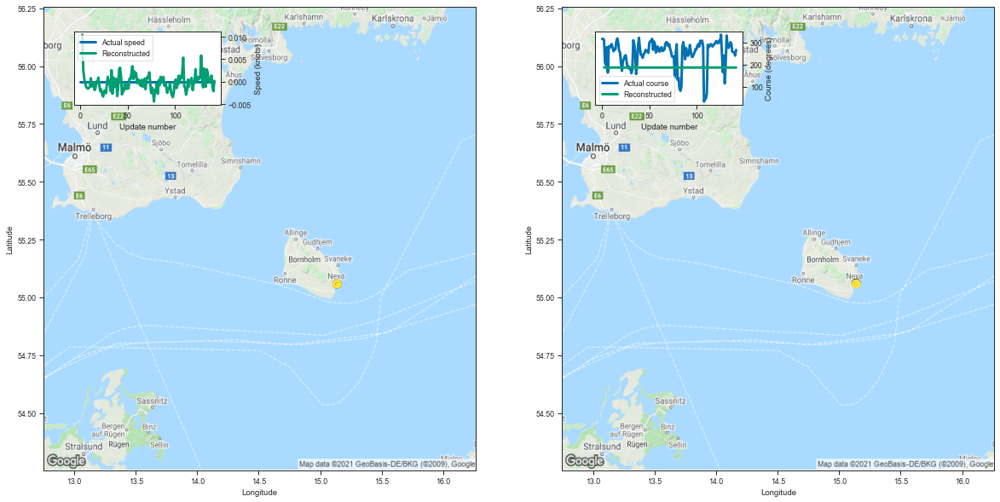

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.138402  55.061249  0.010465  186.757492         0.002083   
3    15.138256  55.059647  0.002580  186.455994         0.001164   
4    15.137571  55.061005  0.000732  186.336487         0.000933   
5    15.138249  55.060551 -0.000398  186.362961         0.000925   
6    15.138704  55.059372 -0.001149  186.453445         0.001009   
..         ...        ...       ...         ...              ...   
138  15.138395  55.059040  0.000089  186.358459         0.000900   
139  15.138898  55.059204  0.001349  186.268311         0.000826   
140  15.138912  55.059349 -0.001239  186.356110         0.000898   
141  15.138502  55.059296 -0.002141  186.268875         0.000824   
142  15.139087  55.058746  0.000175  186.287903         0.000834   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001962     0.021638     94.336835  
3          0.001086     0.009025     99.519372  
4          0.000868     0.006115    

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
25,25,7292936,266054000,Fishing,144,1347.185791,9.355457
34,34,7237328,266054000,Fishing,144,1346.718750,9.352214
44,44,7135380,266054000,Fishing,144,1329.587158,9.233244
29,29,6787151,265759000,Fishing,143,1309.575928,9.157874
17,17,6685896,265759000,Fishing,143,1292.442017,9.038056
74,74,6962046,265759000,Fishing,143,1291.986572,9.034871
60,60,6869996,265759000,Fishing,143,1271.773804,8.893523
42,42,5972813,265754000,Fishing,143,1248.924194,8.733736
109,109,609266,211474000,Fishing,134,1164.737183,8.692069
15,15,803075,211474000,Fishing,143,1241.526733,8.682005


In [7]:
# Focus on the n best cargo reconstructions
data = summary_models.run_evaluation_get_n(n=n, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(n): 
    tracks = plot_actual_reconstructed(idx)
df_n

# Worst Fishing Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Diagonal_GBT_lr0003_S2550100150200250400_06060506060505.pth


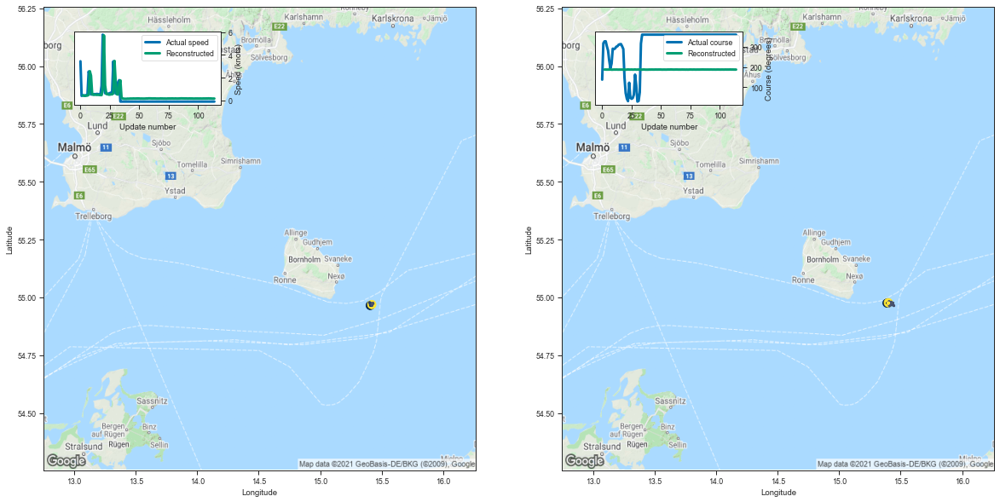

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.389572  54.975319  0.433699  187.516174         0.008928   
3    15.399436  54.975159  0.415096  187.529617         0.006917   
4    15.399230  54.976631  0.396733  187.230865         0.004754   
5    15.402888  54.974522  0.424283  187.384827         0.005285   
6    15.403570  54.974262  0.427243  187.313812         0.005039   
..         ...        ...       ...         ...              ...   
110  15.399437  54.974834  0.170956  187.452789         0.005112   
111  15.400536  54.974384  0.173631  187.562057         0.005458   
112  15.399590  54.975372  0.162995  187.380737         0.004542   
113  15.400514  54.976311  0.162194  187.313339         0.004101   
114  15.400190  54.976841  0.164405  187.304260         0.004004   

     Latitude sigma  Speed sigma  Course sigma  
2          0.006979     0.764537     94.201569  
3          0.005229     0.907950    100.360434  
4          0.003698     0.414798    

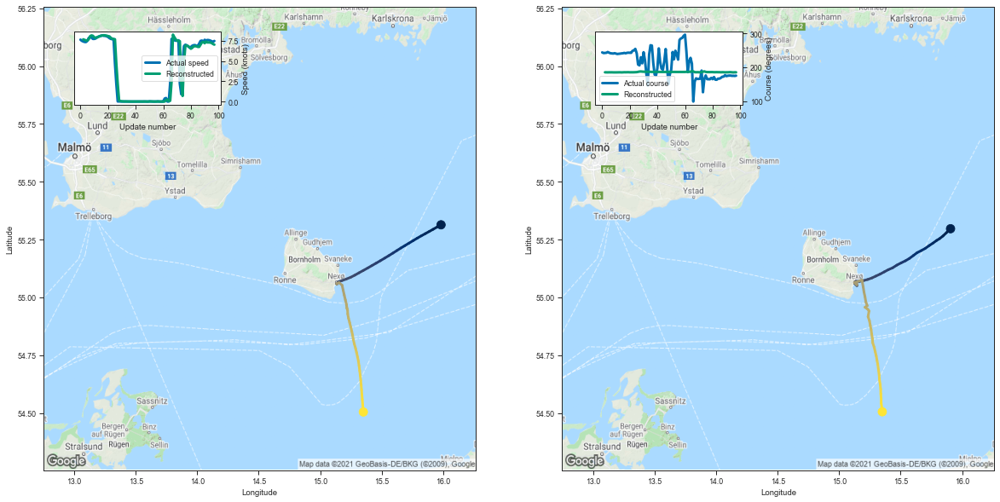

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.905796  55.296814  7.701210  185.230087         0.025602   
3   15.872375  55.279659  7.630446  185.139496         0.017765   
4   15.843971  55.265236  7.561607  185.023758         0.014149   
5   15.817213  55.254055  7.561949  185.212036         0.016141   
6   15.792621  55.246040  7.707023  185.144058         0.015635   
..        ...        ...       ...         ...              ...   
93  15.339134  54.582119  7.318278  185.685074         0.013978   
94  15.341653  54.560612  7.300767  185.229691         0.008940   
95  15.341921  54.542255  7.246899  184.971268         0.006417   
96  15.347191  54.522446  7.123384  185.283340         0.008168   
97  15.350953  54.505112  7.041455  185.229370         0.007662   

    Latitude sigma  Speed sigma  Course sigma  
2         0.016054     1.019153     87.610954  
3         0.011061     0.884681     92.370787  
4         0.008898     0.638667     93.388009  
5  

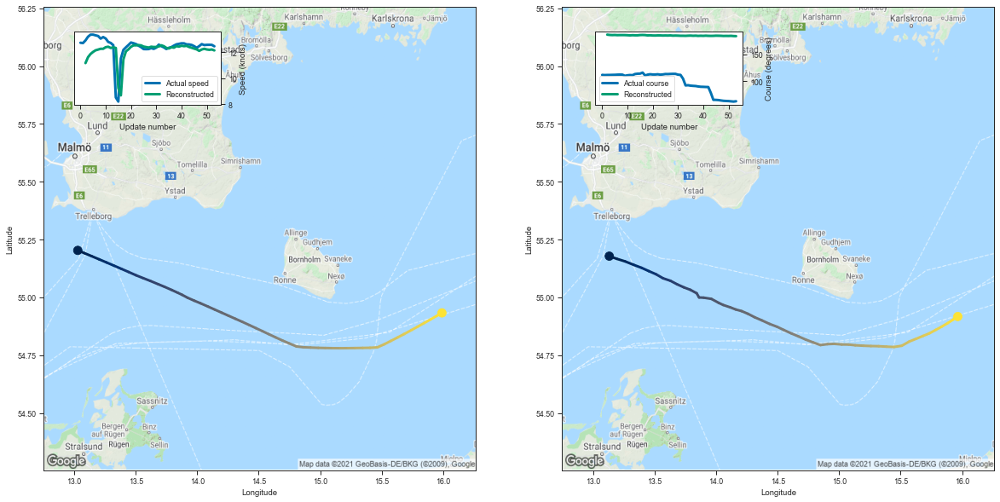

    Longitude   Latitude      Speed      Course  Longitude sigma  \
2   13.131657  55.178188  11.151297  186.609039         0.033781   
3   13.194315  55.166412  11.605463  186.025238         0.019362   
4   13.260562  55.155411  11.850794  185.789764         0.016542   
5   13.330328  55.140514  12.010633  185.961929         0.021510   
6   13.394767  55.127602  12.134731  185.667343         0.017585   
7   13.453266  55.113407  12.190813  185.777115         0.020680   
8   13.511539  55.099918  12.249763  185.790176         0.022136   
9   13.569223  55.082317  12.250156  185.757294         0.022573   
10  13.628653  55.071716  12.373396  185.523010         0.019286   
11  13.683169  55.056362  12.408190  185.224319         0.014904   
12  13.739119  55.042999  12.313187  185.553452         0.020777   
13  13.790448  55.032639  12.361406  185.343445         0.017832   
14  13.842155  55.017677  12.314358  185.341553         0.018141   
15  13.861547  54.999466   9.239035  185.822952 

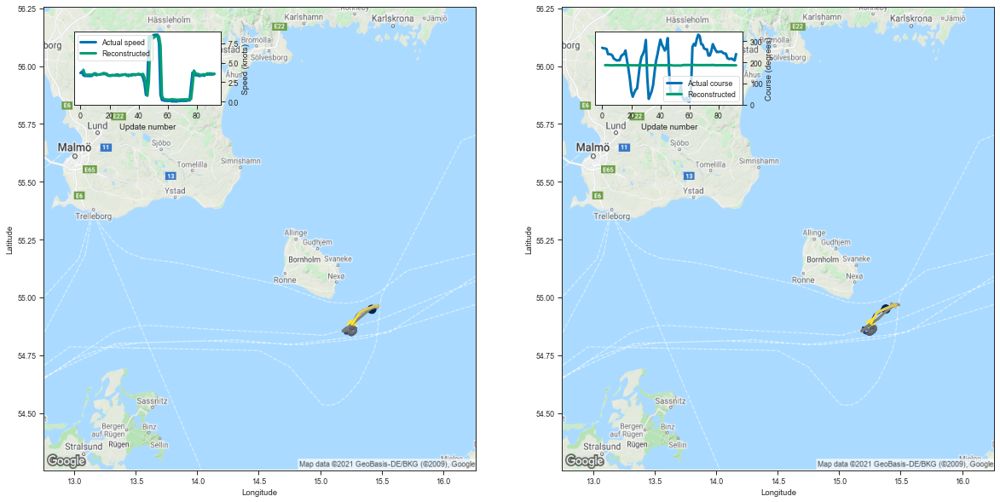

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.380031  54.949692  4.096732  186.701706         0.019098   
3   15.368097  54.948597  3.558458  186.918732         0.015795   
4   15.350639  54.948895  3.431459  186.790039         0.012648   
5   15.334598  54.939659  3.471668  186.386581         0.008075   
6   15.320037  54.934078  3.465129  186.043915         0.005217   
..        ...        ...       ...         ...              ...   
88  15.292477  54.917957  3.615880  186.226105         0.006481   
89  15.282908  54.910713  3.635519  186.123260         0.005566   
90  15.272861  54.904335  3.617899  186.359085         0.006744   
91  15.265841  54.897312  3.575444  186.338608         0.006718   
92  15.258191  54.887444  3.594968  185.897263         0.004299   

    Latitude sigma  Speed sigma  Course sigma  
2         0.011860     1.529868     93.539117  
3         0.009604     1.848263     98.681909  
4         0.007864     1.391203     98.746163  
5  

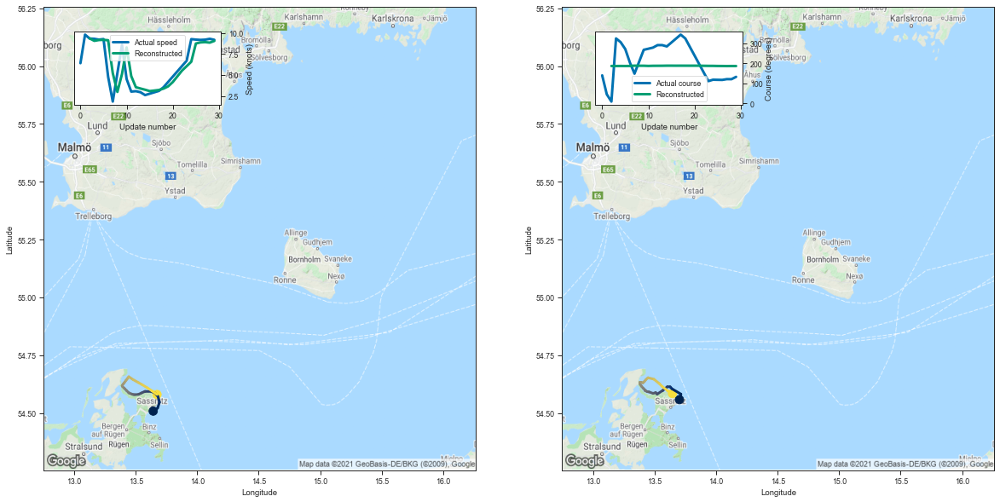

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   13.701862  54.557800  9.351126  186.494507         0.025972   
3   13.714039  54.581589  9.059782  186.296371         0.016319   
4   13.640601  54.604713  9.157871  186.565994         0.019755   
5   13.626292  54.613125  9.179531  186.355408         0.015923   
6   13.603449  54.613434  9.127630  186.696640         0.021290   
7   13.564702  54.596527  5.215037  188.047440         0.022289   
8   13.565576  54.597206  2.977515  187.716202         0.007637   
9   13.520340  54.581280  5.111947  187.686279         0.014652   
10  13.508780  54.588406  8.273273  186.821411         0.017358   
11  13.488066  54.584576  4.865995  187.451828         0.010354   
12  13.454423  54.591076  3.538426  187.571976         0.007312   
13  13.440056  54.592258  3.383296  187.703354         0.007786   
14  13.423144  54.596325  3.237820  188.108307         0.010935   
15  13.426458  54.596878  3.078185  188.120758         0.01075

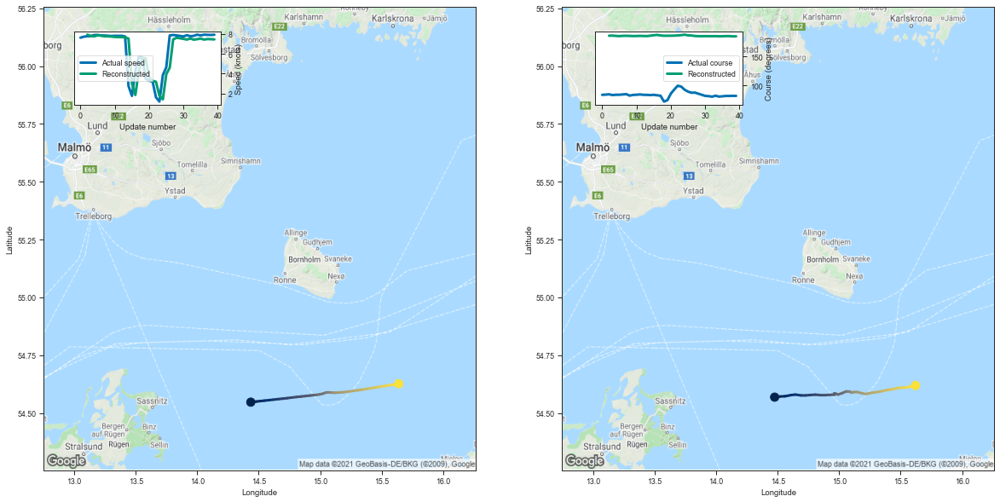

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.475801  54.568394  7.931404  186.139267         0.019170   
3   14.518153  54.571251  7.804535  186.324615         0.019031   
4   14.560846  54.572357  7.756064  185.845795         0.011699   
5   14.608099  54.577156  7.862621  185.470581         0.008242   
6   14.642950  54.579491  7.825883  185.927505         0.012733   
7   14.691134  54.575909  7.762952  186.024246         0.014555   
8   14.727949  54.575966  7.760155  185.811935         0.012261   
9   14.770839  54.577896  7.735329  185.584961         0.009807   
10  14.807867  54.579136  7.697151  185.689789         0.010825   
11  14.849945  54.577045  7.685886  185.845581         0.013023   
12  14.888208  54.577034  7.676342  185.674240         0.011442   
13  14.926780  54.578568  7.662385  185.526352         0.009988   
14  14.962326  54.578865  7.531218  186.156189         0.017958   
15  14.960692  54.585056  2.992305  186.946198         0.00780

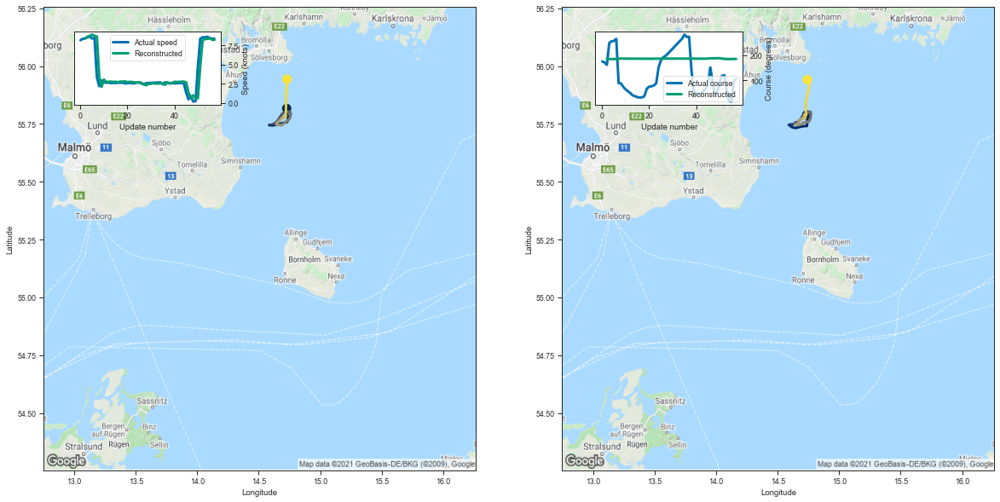

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.735939  55.789295  8.408333  185.700775         0.020659   
3   14.741387  55.757412  8.613173  185.134796         0.009972   
4   14.738009  55.741268  8.741655  185.326904         0.011372   
5   14.700306  55.739574  8.886471  185.441223         0.012978   
6   14.647168  55.732460  8.717764  185.391220         0.011270   
7   14.620955  55.734913  8.642576  186.404785         0.029169   
8   14.591514  55.745781  3.404406  187.349792         0.014782   
9   14.608437  55.747814  2.116382  186.976562         0.006553   
10  14.624785  55.747707  3.051633  187.018524         0.008735   
11  14.645107  55.755329  2.755669  186.745010         0.006125   
12  14.657804  55.756477  2.759986  186.630737         0.005276   
13  14.669820  55.762592  2.795715  186.700592         0.005641   
14  14.683106  55.766693  2.749314  186.463257         0.004371   
15  14.689749  55.771343  2.764804  186.852448         0.00647

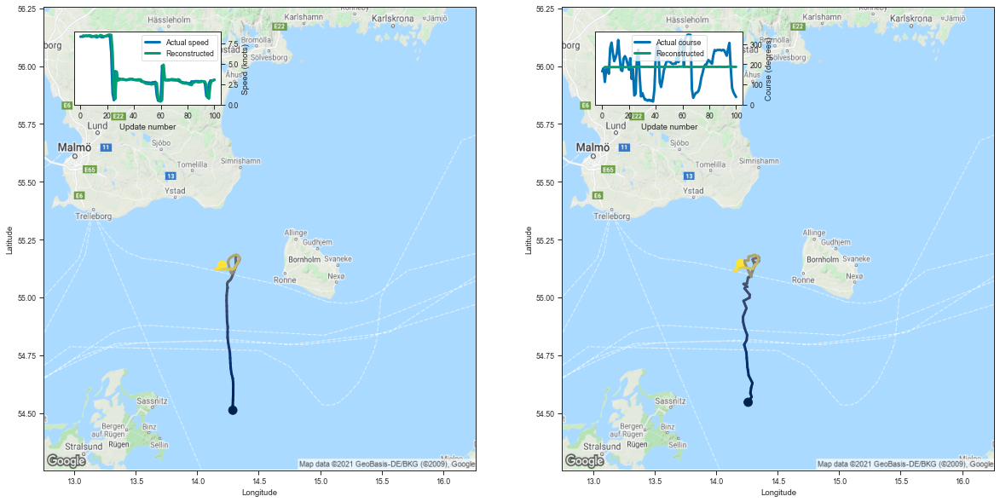

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.260600  54.546284  8.461539  186.258698         0.022500   
3    14.288675  54.569744  8.385874  186.142395         0.016762   
4    14.278563  54.585693  8.426971  185.802979         0.011533   
5    14.284536  54.608250  8.441401  185.729340         0.010428   
6    14.295361  54.629543  8.424591  185.615707         0.009182   
..         ...        ...       ...         ...              ...   
96   14.164324  55.115925  0.728181  188.580322         0.010404   
97   14.157510  55.120834  2.423527  187.609940         0.008488   
98   14.176641  55.134411  2.922802  187.269882         0.006916   
99   14.189367  55.139370  2.926328  186.859558         0.004485   
100  14.199411  55.146229  3.031515  187.162903         0.006049   

     Latitude sigma  Speed sigma  Course sigma  
2          0.012619     1.300314     98.034094  
3          0.009417     1.163785    101.659151  
4          0.006790     0.567710    

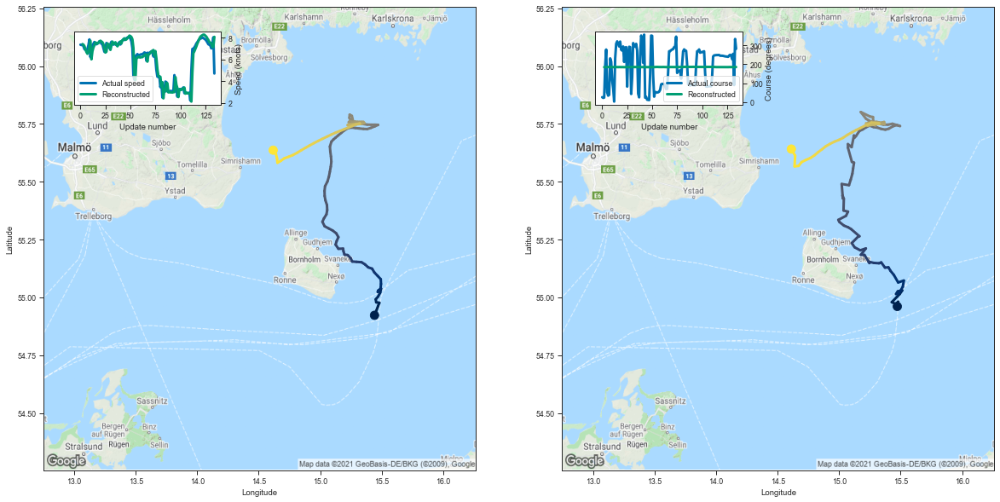

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.472968  54.960613  7.406676  185.370605         0.016608   
3    15.479877  54.980949  7.370996  185.296921         0.012149   
4    15.460389  54.971149  7.223094  185.267670         0.010825   
5    15.428152  54.979279  6.939854  185.601334         0.012851   
6    15.470473  55.002350  6.692822  185.973602         0.017892   
..         ...        ...       ...         ...              ...   
130  14.694690  55.584862  7.552423  185.609833         0.009576   
131  14.670330  55.568443  7.455474  185.448639         0.007790   
132  14.637547  55.566399  7.159826  185.634918         0.008150   
133  14.642718  55.612724  7.155740  186.142700         0.013385   
134  14.611449  55.641228  8.088885  185.760315         0.012862   

     Latitude sigma  Speed sigma  Course sigma  
2          0.010287     0.703191     92.370401  
3          0.007437     0.668244     97.139277  
4          0.006687     0.557881    

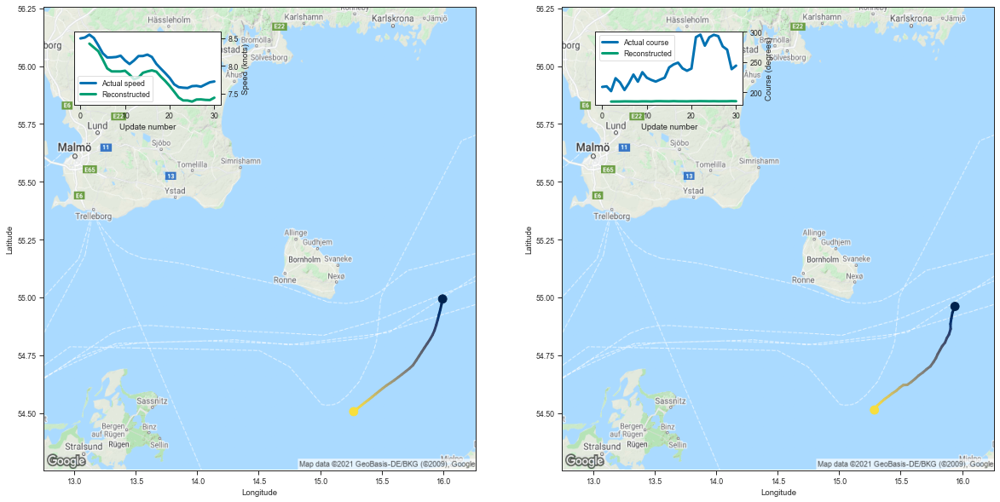

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.941431  54.960804  8.398290  184.726028         0.018634   
3   15.921161  54.934410  8.329083  184.801422         0.015256   
4   15.912256  54.909042  8.261874  184.836029         0.014658   
5   15.905336  54.884834  8.111893  185.062943         0.017132   
6   15.906519  54.863407  7.950402  185.000275         0.015317   
7   15.892682  54.839001  7.896430  184.914764         0.013441   
8   15.875287  54.823414  7.896227  184.849976         0.012087   
9   15.861079  54.804497  7.896026  185.089844         0.014915   
10  15.837298  54.788773  7.907940  185.071182         0.014623   
11  15.819292  54.771511  7.838215  184.906296         0.011823   
12  15.800758  54.753918  7.753194  185.321548         0.016721   
13  15.786738  54.736988  7.784910  185.372879         0.018162   
14  15.767212  54.720242  7.871356  185.231812         0.016051   
15  15.741861  54.701530  7.896006  185.153656         0.01442

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
56,56,4380691,261017210,Fishing,115,-595.816101,-5.181010
105,105,4108573,261004260,Fishing,98,-420.138214,-4.287125
36,36,7969192,273352230,Fishing,54,-160.121613,-2.965215
78,78,140882,211314800,Fishing,93,-261.263092,-2.809281
73,73,1113112,211542610,Fishing,30,-70.742889,-2.358096
67,67,1070020,211474000,Fishing,40,-85.336212,-2.133405
38,38,4942336,265593190,Fishing,58,-93.996277,-1.620625
48,48,4303656,261007170,Fishing,101,-157.032928,-1.554781
49,49,1557318,219021428,Fishing,135,-204.074326,-1.511662
1,1,4547326,261061000,Fishing,31,-38.233673,-1.233344


In [8]:
# Focus on the n worst cargo reconstructions
data = summary_models.run_evaluation_get_n(n=n, worst=True)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(n): 
    tracks = plot_actual_reconstructed(idx)
    print(list(tracks["Reconstructed trajectory"]["Speed"])[:4])
df_n

# Best 100 Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Diagonal_GBT_lr0003_S2550100150200250400_06060506060505.pth


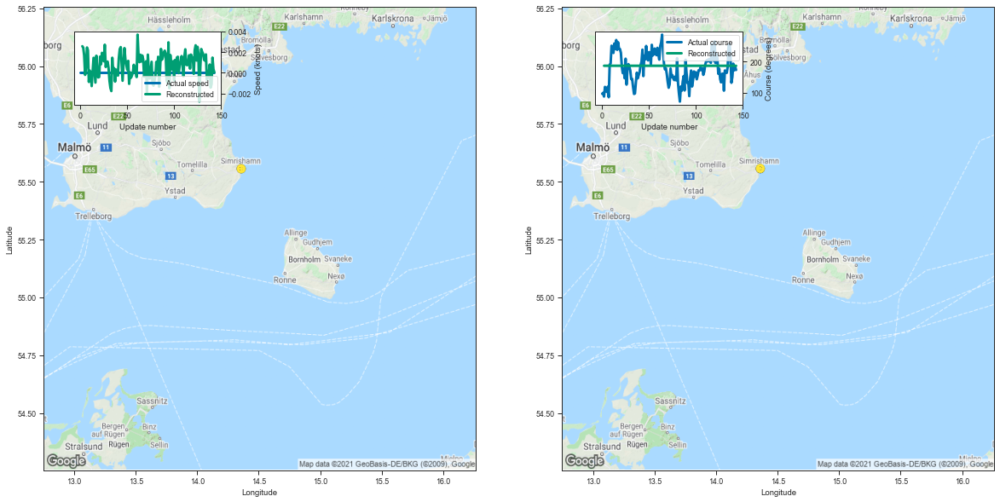

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.359192  55.556515  0.002575  186.595947         0.001150   
3    14.357581  55.557224  0.002434  186.598038         0.000920   
4    14.358746  55.558075  0.001669  186.502136         0.000783   
5    14.358564  55.558235 -0.000205  186.454346         0.000728   
6    14.359047  55.557728  0.000639  186.473648         0.000732   
..         ...        ...       ...         ...              ...   
139  14.359228  55.557384 -0.001437  186.446960         0.000702   
140  14.358850  55.557762 -0.001101  186.462067         0.000714   
141  14.359388  55.557327  0.001468  186.501801         0.000750   
142  14.359156  55.557701  0.000343  186.509521         0.000754   
143  14.359523  55.557159  0.000031  186.479782         0.000733   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001145     0.003842     91.329065  
3          0.000867     0.004570     96.927581  
4          0.000737     0.003342    

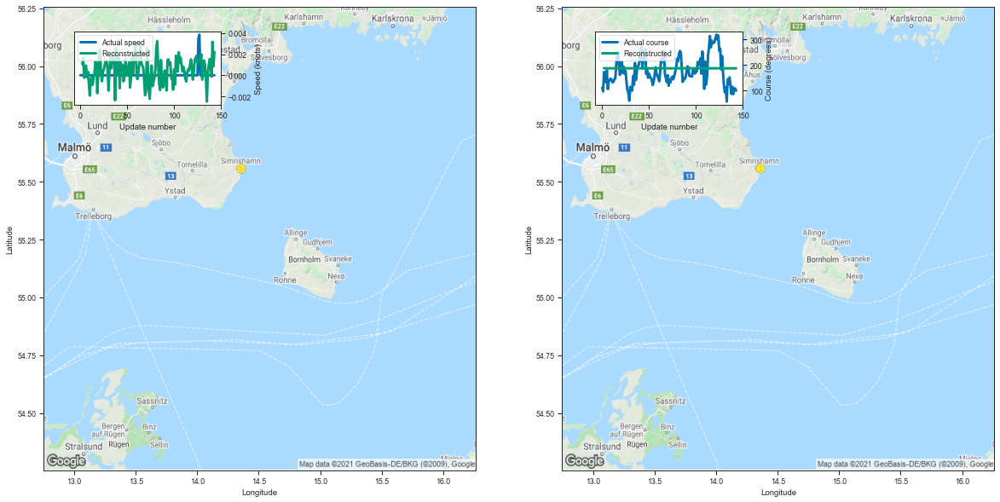

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.358532  55.557426  0.001059  186.690384         0.001297   
3    14.358953  55.557301  0.001622  186.498856         0.000840   
4    14.359394  55.557152 -0.000230  186.489212         0.000771   
5    14.358914  55.557896  0.000316  186.502869         0.000765   
6    14.358872  55.558037  0.000914  186.418625         0.000696   
..         ...        ...       ...         ...              ...   
139  14.357795  55.557724  0.001339  186.410721         0.000680   
140  14.359558  55.557678 -0.000125  186.512512         0.000752   
141  14.358377  55.557178  0.003169  186.493576         0.000740   
142  14.359111  55.558243  0.000838  186.533310         0.000772   
143  14.359675  55.557484  0.002213  186.514572         0.000762   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001290     0.005413     91.050295  
3          0.000807     0.003169     96.084120  
4          0.000728     0.003209    

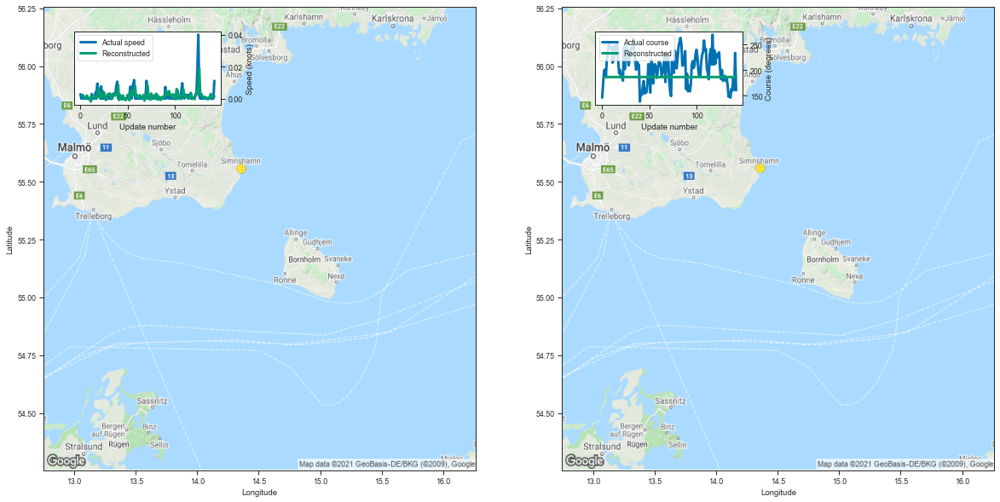

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.359999  55.557690  0.002043  186.606506         0.001175   
3    14.359356  55.557922  0.002112  186.717896         0.001053   
4    14.359448  55.558430 -0.000070  186.519897         0.000811   
5    14.359750  55.558041  0.000618  186.428070         0.000713   
6    14.359892  55.557571  0.001237  186.588470         0.000833   
..         ...        ...       ...         ...              ...   
138  14.360498  55.556950  0.002898  186.743652         0.000980   
139  14.360539  55.556889  0.001822  186.481720         0.000751   
140  14.360802  55.557331  0.001248  186.509201         0.000758   
141  14.360297  55.556664  0.001662  186.601517         0.000835   
142  14.360055  55.557728  0.001360  186.489426         0.000750   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001173     0.003966     91.094248  
3          0.000981     0.006902     97.163019  
4          0.000767     0.003578    

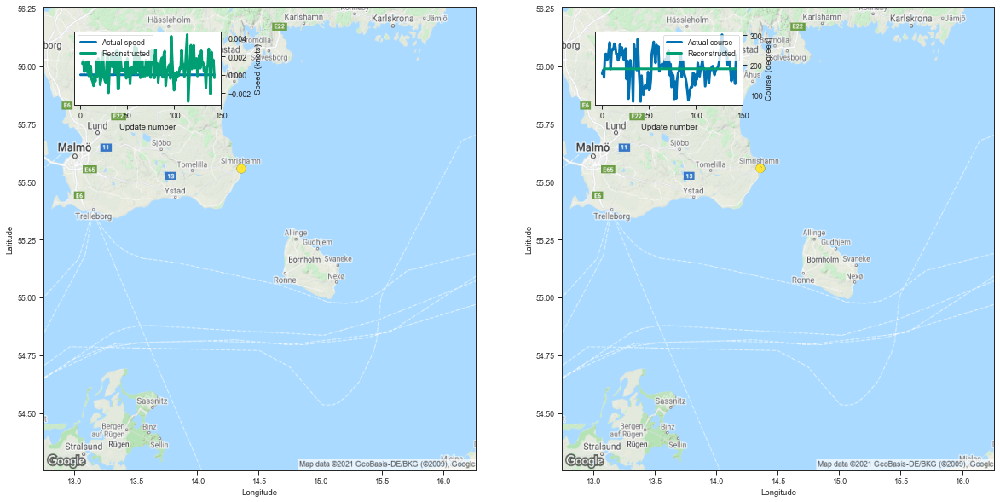

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.359995  55.557983  0.001204  186.888138         0.001580   
3    14.358992  55.557373  0.001585  186.664307         0.001014   
4    14.358836  55.557804  0.000334  186.566513         0.000848   
5    14.359091  55.558250  0.000714  186.561554         0.000824   
6    14.359467  55.557026  0.001369  186.438293         0.000716   
..         ...        ...       ...         ...              ...   
139  14.359224  55.556877 -0.002102  186.452606         0.000712   
140  14.358932  55.558079  0.002468  186.816910         0.001039   
141  14.360106  55.557365  0.001175  186.756927         0.001002   
142  14.359448  55.557144  0.001607  186.705307         0.000955   
143  14.359226  55.557491 -0.000329  186.704544         0.000944   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001527     0.010780     92.130835  
3          0.000959     0.005812     96.482279  
4          0.000796     0.004198    

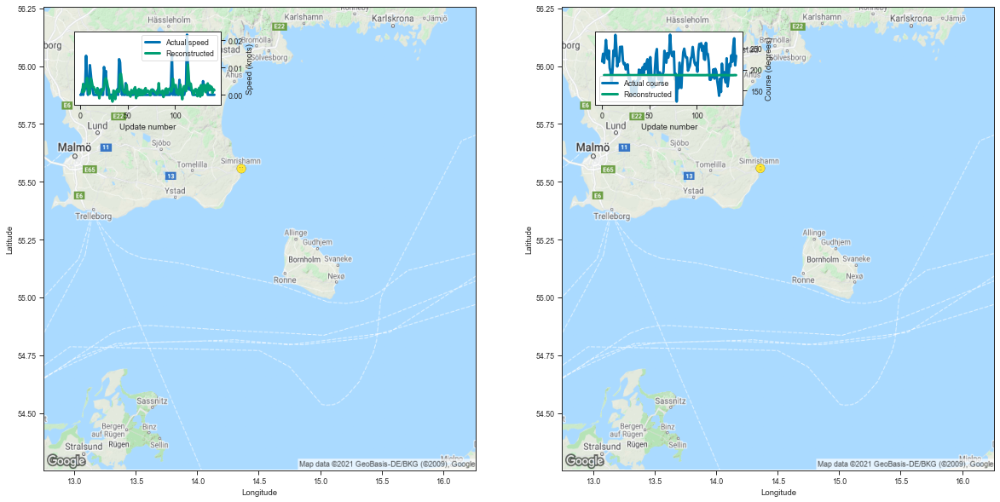

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.359863  55.557968  0.000968  186.627747         0.001204   
3    14.359983  55.557728  0.003990  186.507645         0.000845   
4    14.360097  55.558193  0.001254  186.484344         0.000770   
5    14.360802  55.557930  0.003392  186.478348         0.000750   
6    14.360418  55.558071  0.003085  186.547333         0.000800   
..         ...        ...       ...         ...              ...   
138  14.360084  55.558235  0.001859  186.421234         0.000689   
139  14.360501  55.557217  0.002928  186.408554         0.000679   
140  14.360170  55.558567  0.000674  186.646622         0.000873   
141  14.360485  55.558285  0.002070  186.497406         0.000757   
142  14.360060  55.558048  0.001690  186.558670         0.000800   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001202     0.004265     91.102449  
3          0.000808     0.003283     96.299536  
4          0.000727     0.003135    

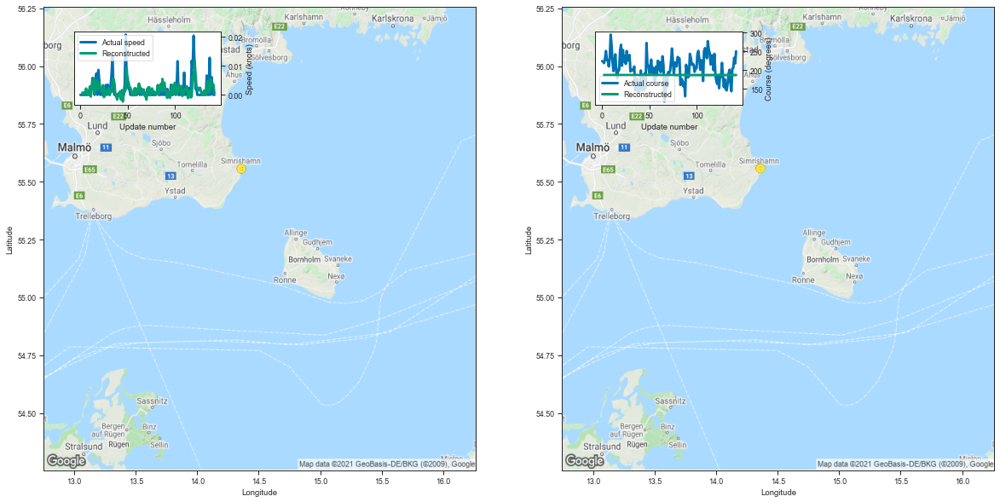

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.359659  55.557884  0.000764  186.819916         0.001507   
3    14.360036  55.557041  0.000294  186.548187         0.000892   
4    14.360453  55.557518  0.000846  186.570206         0.000851   
5    14.360447  55.557209  0.000735  186.681091         0.000931   
6    14.360607  55.556732  0.002181  186.580139         0.000840   
..         ...        ...       ...         ...              ...   
138  14.360531  55.556702  0.005403  186.470749         0.000726   
139  14.360164  55.557423  0.003170  186.508835         0.000760   
140  14.360133  55.557583  0.003279  186.602417         0.000840   
141  14.361070  55.557003  0.003607  186.462769         0.000729   
142  14.360286  55.557507  0.000575  186.631500         0.000863   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001481     0.008554     91.209869  
3          0.000856     0.003785     96.020028  
4          0.000798     0.004346    

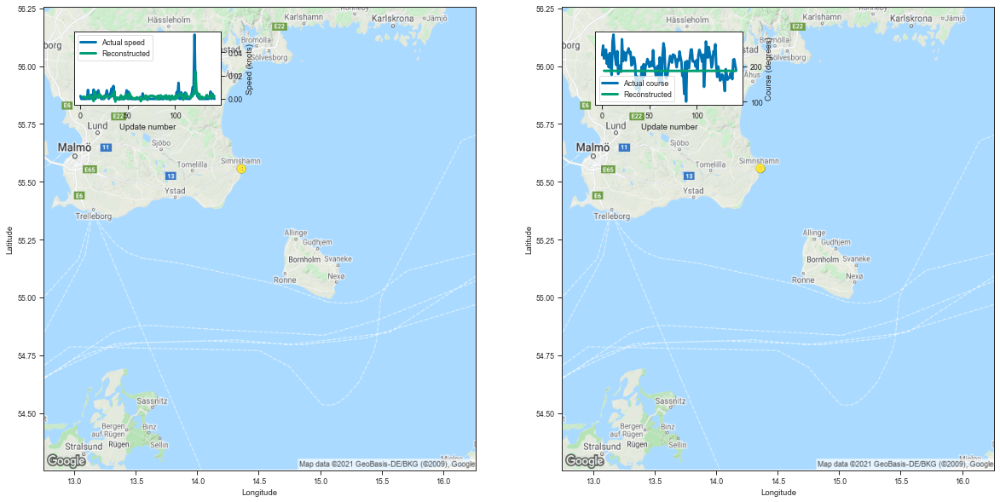

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.360972  55.557110  0.001393  186.911728         0.001658   
3    14.360617  55.556683  0.001932  186.645737         0.000994   
4    14.361086  55.557198  0.001758  186.708847         0.000987   
5    14.360168  55.557423  0.001269  186.670486         0.000933   
6    14.360475  55.557335  0.001452  186.614990         0.000872   
..         ...        ...       ...         ...              ...   
138  14.360669  55.557987  0.002913  186.682587         0.000904   
139  14.359868  55.557537  0.004290  186.529221         0.000786   
140  14.360381  55.557125  0.000916  186.477524         0.000735   
141  14.360334  55.557087  0.003035  186.576447         0.000811   
142  14.359813  55.557972  0.002248  186.463287         0.000728   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001609     0.012265     91.764128  
3          0.000945     0.005400     96.261160  
4          0.000911     0.007066    

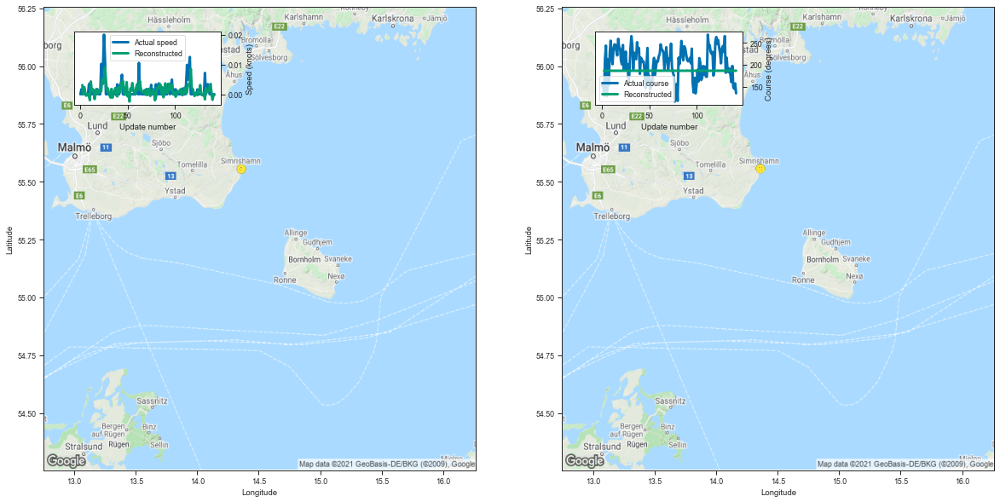

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.359939  55.556793  0.003082  186.764404         0.001403   
3    14.359830  55.557346  0.000019  186.712067         0.001057   
4    14.360241  55.556259  0.002397  186.522339         0.000816   
5    14.360269  55.556286  0.000696  186.430496         0.000715   
6    14.360960  55.556305 -0.000474  186.600250         0.000837   
..         ...        ...       ...         ...              ...   
138  14.360313  55.555962  0.003477  186.659988         0.000893   
139  14.360748  55.556526  0.000319  186.554306         0.000806   
140  14.360054  55.557228 -0.001859  186.541641         0.000783   
141  14.360566  55.556358 -0.000354  186.470901         0.000728   
142  14.360453  55.555984 -0.000205  186.586411         0.000821   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001374     0.007084     91.579110  
3          0.000989     0.006922     96.947624  
4          0.000772     0.003647    

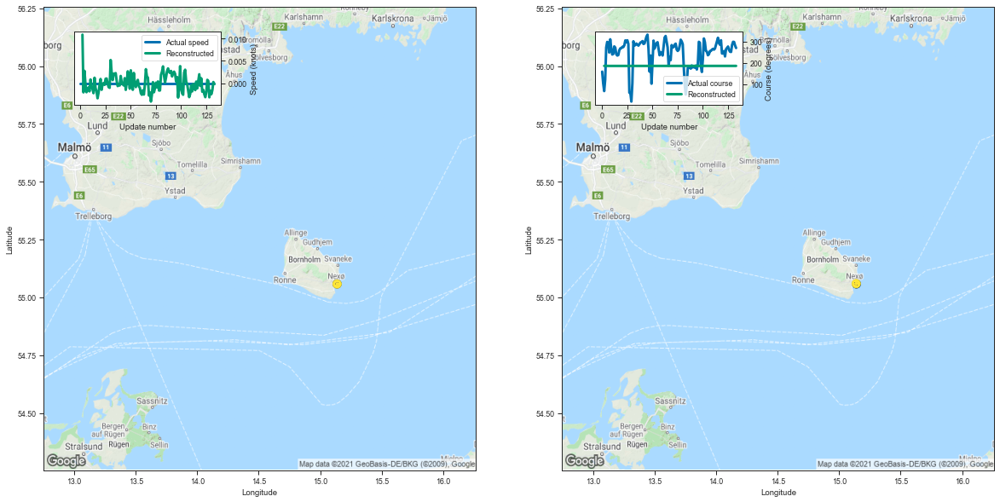

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.140349  55.058079  0.010846  186.656067         0.001895   
3    15.139784  55.058071 -0.002034  186.529251         0.001216   
4    15.139339  55.059135  0.002776  186.459686         0.001061   
5    15.137810  55.059326 -0.000242  186.323715         0.000902   
6    15.137815  55.059967 -0.001999  186.380371         0.000934   
..         ...        ...       ...         ...              ...   
129  15.139664  55.058613 -0.001695  186.261398         0.000808   
130  15.138048  55.059849 -0.002441  186.270416         0.000815   
131  15.138891  55.059292 -0.001541  186.262589         0.000810   
132  15.138260  55.059406  0.000272  186.284561         0.000831   
133  15.138762  55.059345 -0.000181  186.437561         0.000979   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001802     0.015479     93.843719  
3          0.001114     0.011916    100.674483  
4          0.000969     0.009820    

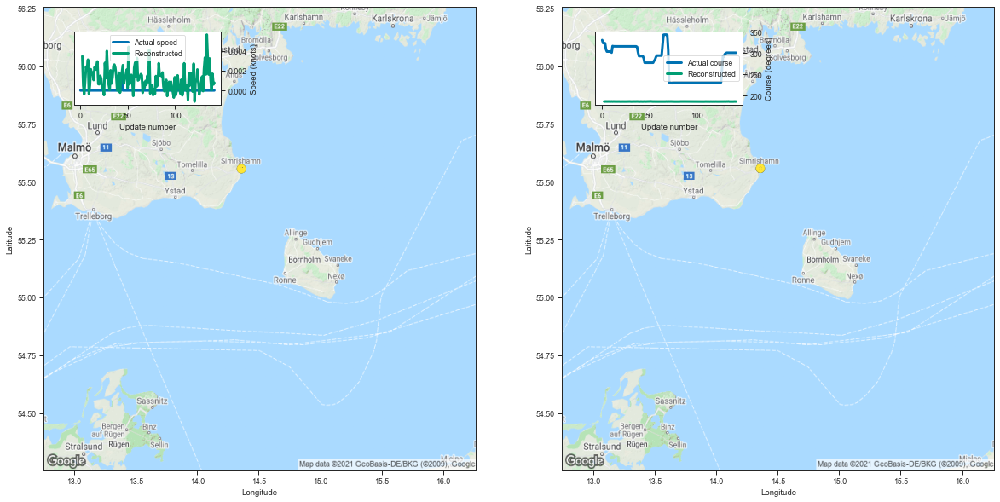

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.359640  55.557423  0.003464  186.662811         0.001258   
3    14.360989  55.556614  0.000484  186.564590         0.000895   
4    14.360946  55.557636 -0.000375  186.754745         0.001028   
5    14.361031  55.557133  0.001039  186.601624         0.000876   
6    14.360313  55.557461  0.002409  186.699799         0.000947   
..         ...        ...       ...         ...              ...   
138  14.359640  55.557835  0.001130  186.518829         0.000766   
139  14.360141  55.557533  0.000037  186.436890         0.000704   
140  14.360154  55.557541  0.001692  186.661850         0.000887   
141  14.360458  55.557514  0.000601  186.658905         0.000901   
142  14.359921  55.557911  0.000769  186.536163         0.000792   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001255     0.004955     91.060420  
3          0.000852     0.004100     96.567359  
4          0.000940     0.008490    

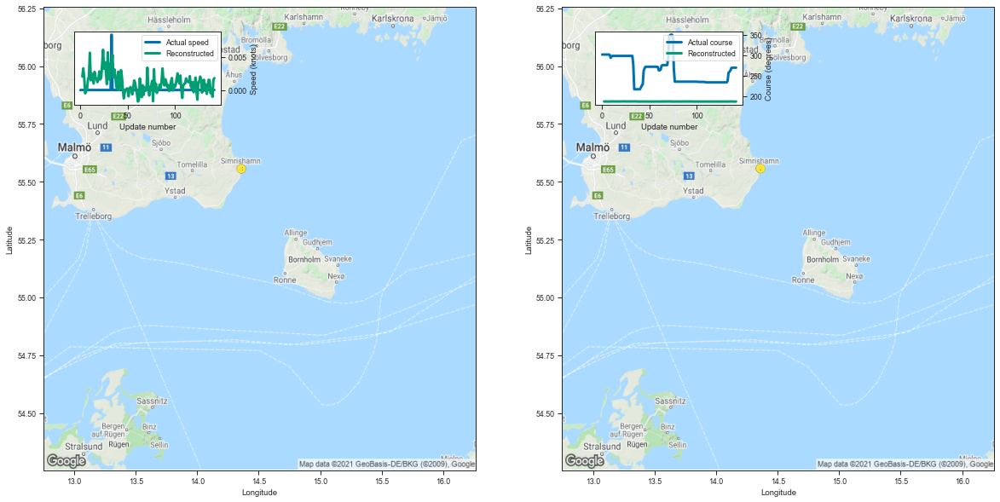

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.360559  55.557022  0.002022  186.611221         0.001178   
3    14.360672  55.557041  0.003263  186.696976         0.001026   
4    14.360935  55.557442  0.001949  186.602753         0.000884   
5    14.360944  55.557060 -0.000498  186.597580         0.000858   
6    14.360054  55.557518 -0.000244  186.560989         0.000817   
..         ...        ...       ...         ...              ...   
138  14.360809  55.557453 -0.000490  186.514984         0.000770   
139  14.360804  55.557396  0.000173  186.549103         0.000792   
140  14.360472  55.558346 -0.001018  186.419525         0.000693   
141  14.360878  55.557724  0.001522  186.556198         0.000795   
142  14.361485  55.557167  0.001795  186.525558         0.000777   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001176     0.004048     91.177727  
3          0.000960     0.006537     97.172617  
4          0.000827     0.004868    

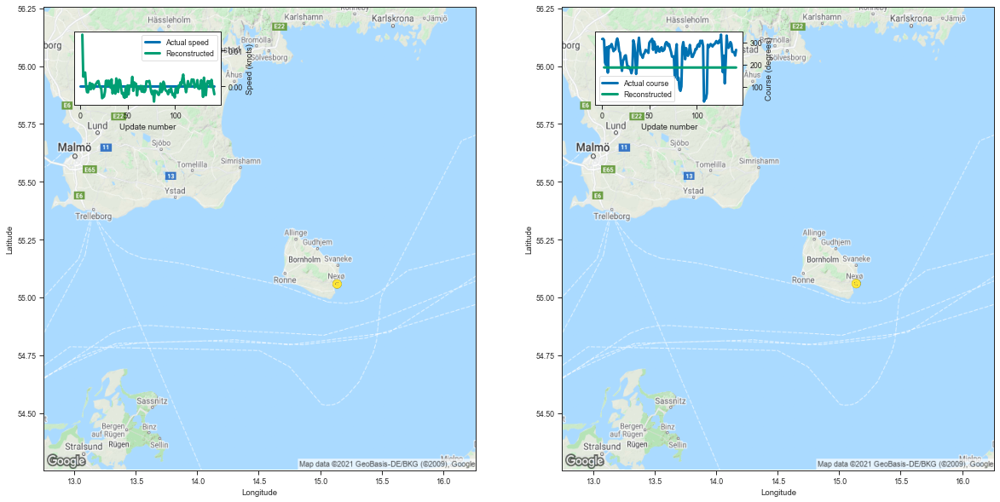

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.139219  55.059563  0.014462  186.743546         0.002048   
3    15.138165  55.060177  0.002730  186.649628         0.001430   
4    15.138052  55.060921  0.003725  186.549179         0.001199   
5    15.137960  55.060627  0.003891  186.550858         0.001161   
6    15.138352  55.059704 -0.000026  186.460556         0.001043   
..         ...        ...       ...         ...              ...   
138  15.138581  55.059315 -0.000159  186.269501         0.000824   
139  15.137893  55.059704  0.001838  186.266251         0.000817   
140  15.138763  55.059330 -0.000005  186.293884         0.000839   
141  15.139025  55.059101 -0.000737  186.303070         0.000848   
142  15.138397  55.059364 -0.002181  186.280075         0.000827   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001931     0.020925     94.318003  
3          0.001304     0.018190    100.247389  
4          0.001092     0.013430    

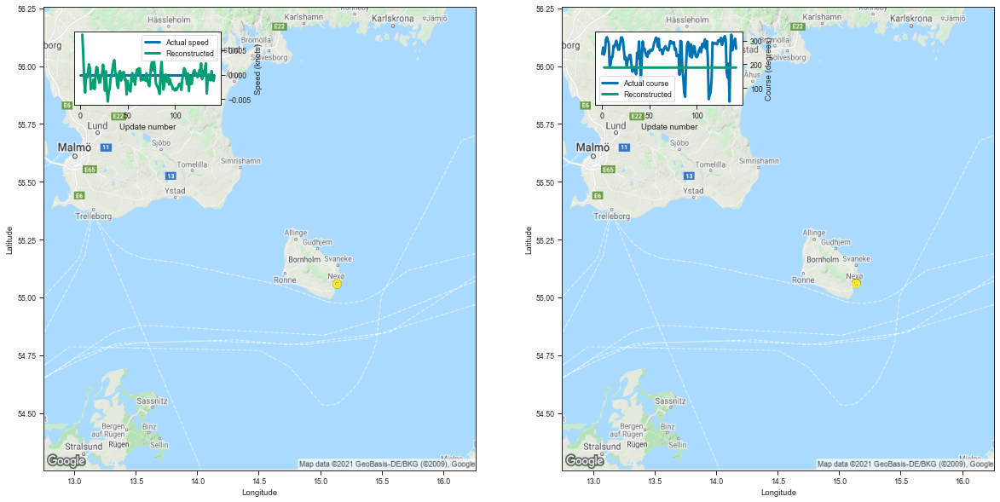

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.139334  55.061287  0.008107  186.869308         0.002396   
3    15.140131  55.058720  0.004048  186.469650         0.001199   
4    15.138171  55.060253 -0.001190  186.441971         0.001051   
5    15.137907  55.059917 -0.003645  186.419464         0.000989   
6    15.139065  55.058914  0.000046  186.430664         0.001000   
..         ...        ...       ...         ...              ...   
138  15.140025  55.058693 -0.001171  186.288071         0.000845   
139  15.138577  55.058949  0.000720  186.304733         0.000853   
140  15.137389  55.060139 -0.000806  186.268295         0.000820   
141  15.138180  55.059547 -0.001277  186.297241         0.000841   
142  15.138955  55.059265 -0.000542  186.418777         0.000962   

     Latitude sigma  Speed sigma  Course sigma  
2          0.002238     0.031203     94.031203  
3          0.001119     0.009238     99.119621  
4          0.000965     0.008937    

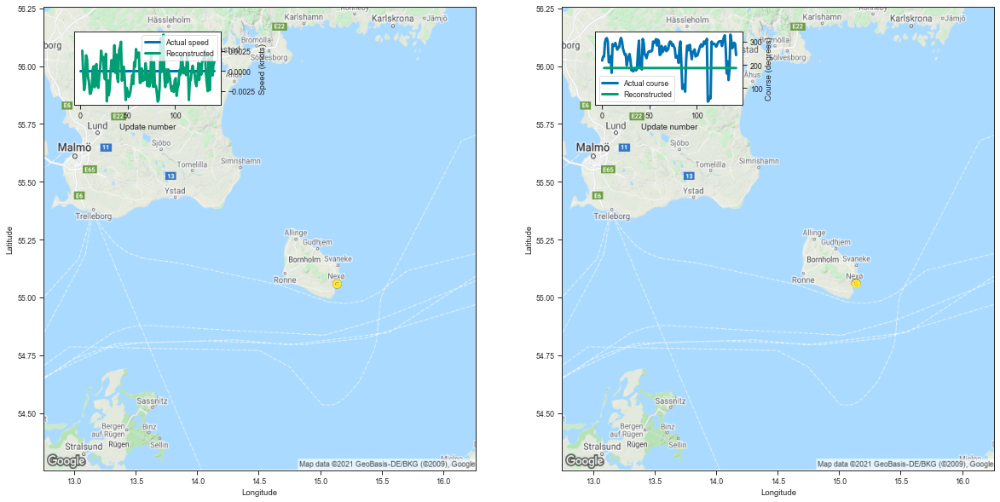

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.137336  55.061073  0.002531  186.638672         0.001864   
3    15.139366  55.059254 -0.000546  186.363174         0.001042   
4    15.138155  55.059727 -0.002379  186.441620         0.001029   
5    15.138515  55.059566 -0.001569  186.526474         0.001113   
6    15.138325  55.060036  0.001949  186.477859         0.001059   
..         ...        ...       ...         ...              ...   
138  15.138288  55.059879  0.000542  186.296127         0.000855   
139  15.138298  55.059406  0.001697  186.270172         0.000824   
140  15.137728  55.060322 -0.000566  186.267578         0.000817   
141  15.138103  55.060024  0.000742  186.375076         0.000919   
142  15.138545  55.059128  0.001110  186.294266         0.000849   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001787     0.013772     93.353327  
3          0.000978     0.006231     99.401878  
4          0.000939     0.008783    

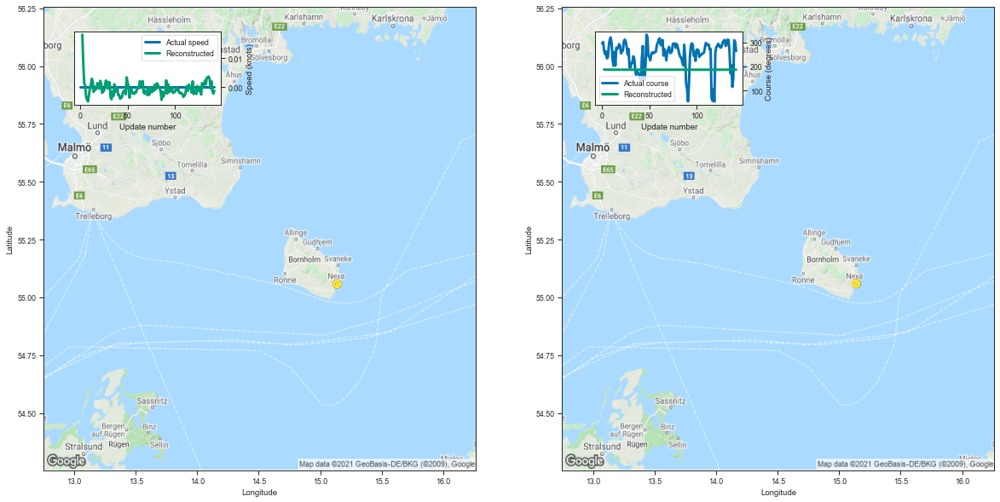

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.139771  55.059315  0.018038  186.978256         0.002661   
3    15.139028  55.059483  0.008369  186.590088         0.001381   
4    15.139118  55.058933  0.001308  186.469193         0.001101   
5    15.138305  55.059563  0.000736  186.368210         0.000951   
6    15.138465  55.059509 -0.003246  186.296844         0.000859   
..         ...        ...       ...         ...              ...   
138  15.137481  55.060246 -0.000427  186.290985         0.000843   
139  15.139263  55.058979  0.001982  186.418671         0.000947   
140  15.138785  55.059517 -0.001439  186.282013         0.000835   
141  15.138441  55.059525 -0.002184  186.299713         0.000846   
142  15.138397  55.059406 -0.001209  186.268280         0.000819   

     Latitude sigma  Speed sigma  Course sigma  
2          0.002439     0.046464     94.912043  
3          0.001275     0.014444     99.307175  
4          0.001013     0.010029    

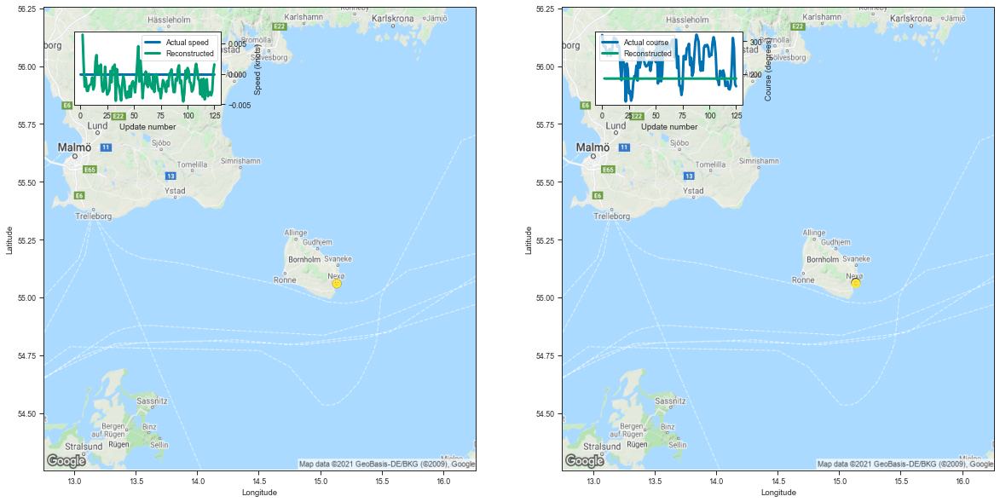

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.135626  55.063763  0.006456  186.694092         0.001987   
3    15.136720  55.061649  0.001457  186.505463         0.001216   
4    15.136099  55.061443 -0.002114  186.315430         0.000915   
5    15.136537  55.061295 -0.000623  186.371719         0.000936   
6    15.136213  55.061581 -0.002788  186.286865         0.000849   
..         ...        ...       ...         ...              ...   
121  15.137258  55.060265 -0.002972  186.259735         0.000802   
122  15.137872  55.060043 -0.003541  186.336838         0.000873   
123  15.137495  55.060368 -0.002895  186.293793         0.000840   
124  15.136744  55.060928  0.000301  186.265488         0.000816   
125  15.136775  55.060425  0.001554  186.324707         0.000861   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001892     0.017254     93.538778  
3          0.001127     0.010509     99.742388  
4          0.000852     0.005636    

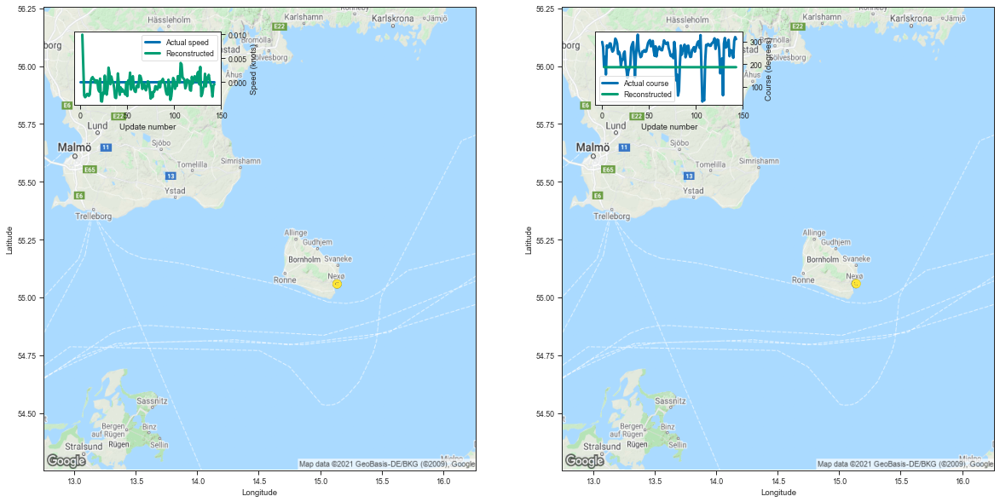

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.137053  55.059246  0.009974  186.754532         0.002047   
3    15.137930  55.060036  0.003261  186.396317         0.001090   
4    15.138078  55.059750 -0.002779  186.374908         0.000964   
5    15.139337  55.059284 -0.003145  186.293915         0.000857   
6    15.138617  55.059067 -0.002938  186.275269         0.000831   
..         ...        ...       ...         ...              ...   
139  15.138834  55.059113 -0.000354  186.270447         0.000824   
140  15.138841  55.059414 -0.001113  186.360840         0.000899   
141  15.138759  55.059475 -0.003005  186.449020         0.000995   
142  15.138493  55.060200 -0.000704  186.274445         0.000838   
143  15.138962  55.059132 -0.000433  186.362885         0.000905   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001921     0.020441     94.516817  
3          0.001022     0.007067     99.321123  
4          0.000890     0.006882    

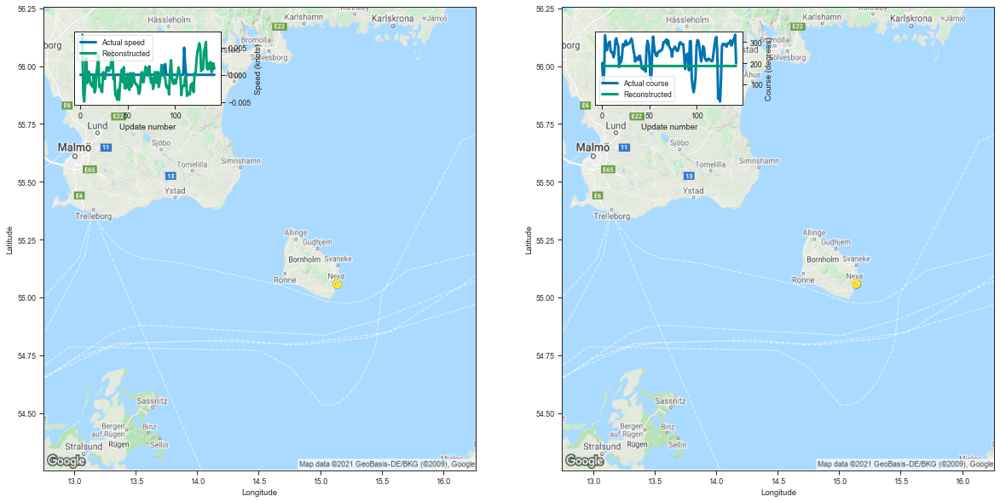

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.141200  55.058105  0.007405  186.632034         0.001816   
3    15.140186  55.059105 -0.003505  186.389145         0.001058   
4    15.139502  55.058399 -0.004934  186.379608         0.000963   
5    15.137624  55.059917 -0.001846  186.520554         0.001092   
6    15.138652  55.059479  0.003085  186.286911         0.000867   
..         ...        ...       ...         ...              ...   
138  15.137961  55.059826  0.002363  186.507721         0.001056   
139  15.138095  55.060089  0.000464  186.332840         0.000900   
140  15.139289  55.058708  0.000900  186.305161         0.000857   
141  15.139412  55.058762  0.002100  186.337463         0.000888   
142  15.139295  55.059055  0.001118  186.318817         0.000871   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001729     0.013985     94.049002  
3          0.000988     0.006867     99.793473  
4          0.000887     0.007123    

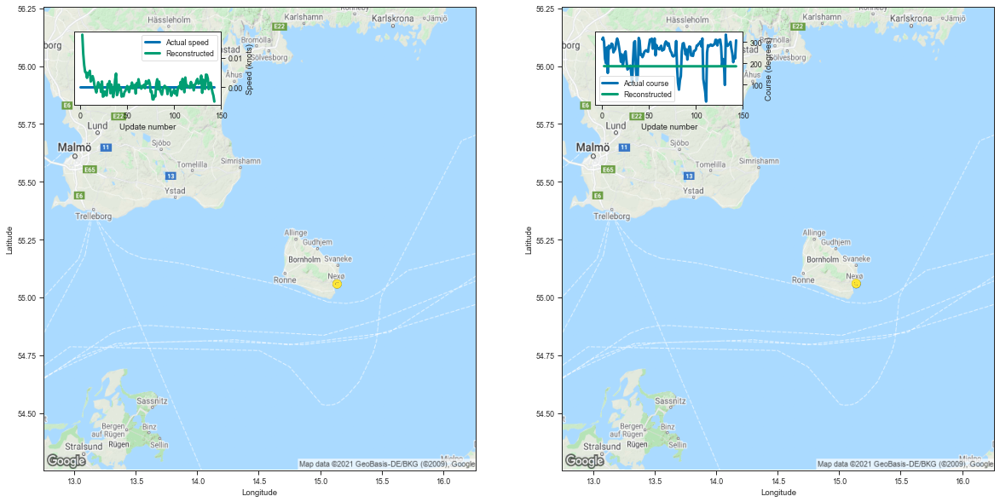

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.139120  55.059067  0.017819  187.013672         0.002764   
3    15.138210  55.060619  0.011268  187.075073         0.002274   
4    15.139162  55.059917  0.007493  186.743500         0.001552   
5    15.138075  55.060555  0.005201  186.666702         0.001357   
6    15.138784  55.059727  0.004998  186.811554         0.001527   
..         ...        ...       ...         ...              ...   
139  15.138617  55.058743  0.001570  186.270248         0.000824   
140  15.138338  55.059551 -0.000185  186.271225         0.000821   
141  15.138007  55.060375 -0.001769  186.331833         0.000870   
142  15.138163  55.060246 -0.002873  186.265976         0.000817   
143  15.138375  55.059811 -0.004876  186.263748         0.000809   

     Latitude sigma  Speed sigma  Course sigma  
2          0.002515     0.053423     95.149600  
3          0.001980     0.077275    101.234253  
4          0.001397     0.027094    

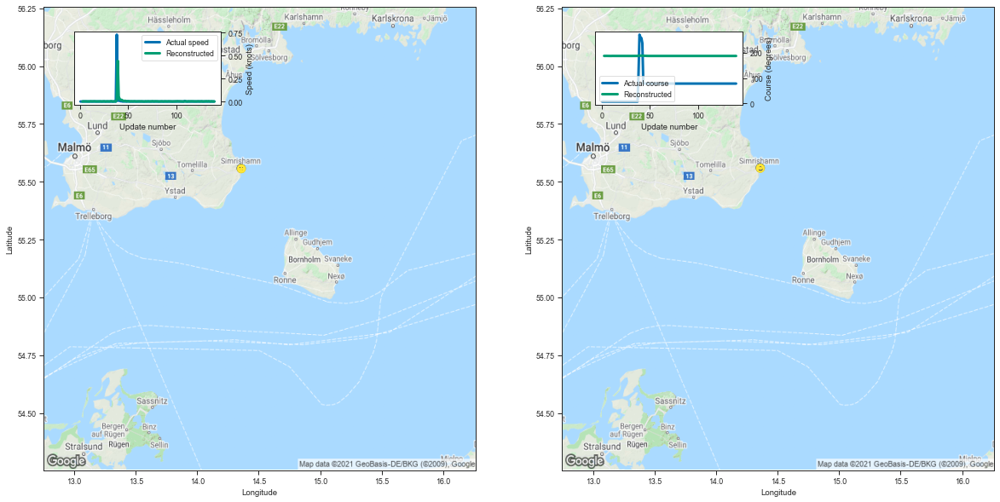

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.358772  55.559734  0.000167  186.730682         0.001310   
3    14.359606  55.558708  0.001996  186.463348         0.000790   
4    14.359421  55.559292  0.001604  186.726990         0.000972   
5    14.358902  55.559422  0.001580  186.614502         0.000868   
6    14.358768  55.559013  0.001878  186.521637         0.000772   
..         ...        ...       ...         ...              ...   
136  14.359228  55.558201  0.000150  186.445984         0.000708   
137  14.359975  55.557655  0.002515  186.540619         0.000778   
138  14.359858  55.557781  0.000789  186.561920         0.000799   
139  14.359843  55.557747  0.001145  186.411240         0.000682   
140  14.359491  55.558533  0.000583  186.458557         0.000712   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001283     0.006660     92.245215  
3          0.000758     0.003001     96.740845  
4          0.000886     0.007969    

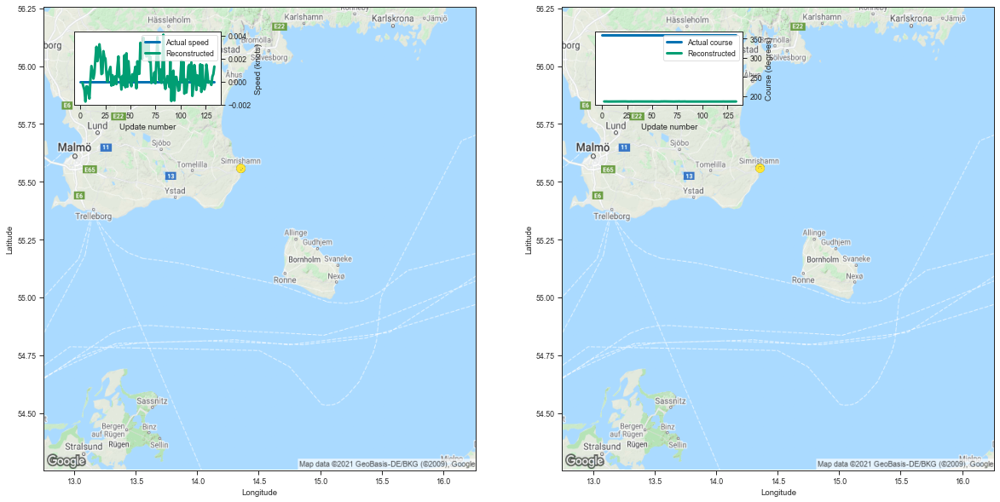

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.356845  55.558952 -0.000103  186.695419         0.001310   
3    14.356801  55.558434 -0.000450  186.544006         0.000869   
4    14.357806  55.558174 -0.000741  186.658768         0.000923   
5    14.356548  55.559162 -0.001744  186.449387         0.000732   
6    14.357476  55.558147 -0.000426  186.427124         0.000700   
..         ...        ...       ...         ...              ...   
130  14.357346  55.558113 -0.000052  186.508804         0.000753   
131  14.356518  55.558811 -0.000299  186.418945         0.000688   
132  14.357052  55.558273  0.000427  186.612518         0.000841   
133  14.357272  55.558029  0.000645  186.494904         0.000755   
134  14.357169  55.558151  0.001303  186.571121         0.000812   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001307     0.005719     91.016981  
3          0.000832     0.003818     96.518305  
4          0.000855     0.006057    

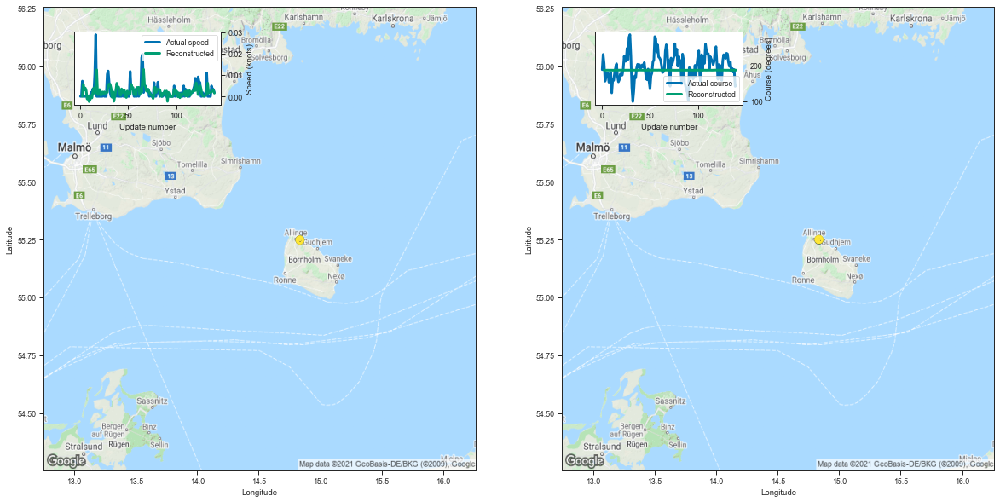

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.836049  55.248539 -0.000023  186.564529         0.001424   
3    14.837245  55.249798  0.005657  186.395615         0.000931   
4    14.837039  55.248348  0.002935  186.345276         0.000812   
5    14.837644  55.248528  0.003926  186.564865         0.000997   
6    14.837370  55.249290  0.002701  186.586090         0.001020   
..         ...        ...       ...         ...              ...   
136  14.837015  55.250496  0.001769  186.373306         0.000800   
137  14.837128  55.249943  0.002187  186.389771         0.000812   
138  14.837370  55.249756  0.002689  186.452026         0.000869   
139  14.837512  55.249958  0.002910  186.424713         0.000849   
140  14.835881  55.250038  0.001500  186.550430         0.000968   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001391     0.006332     92.703134  
3          0.000877     0.004216     98.293868  
4          0.000756     0.003726    

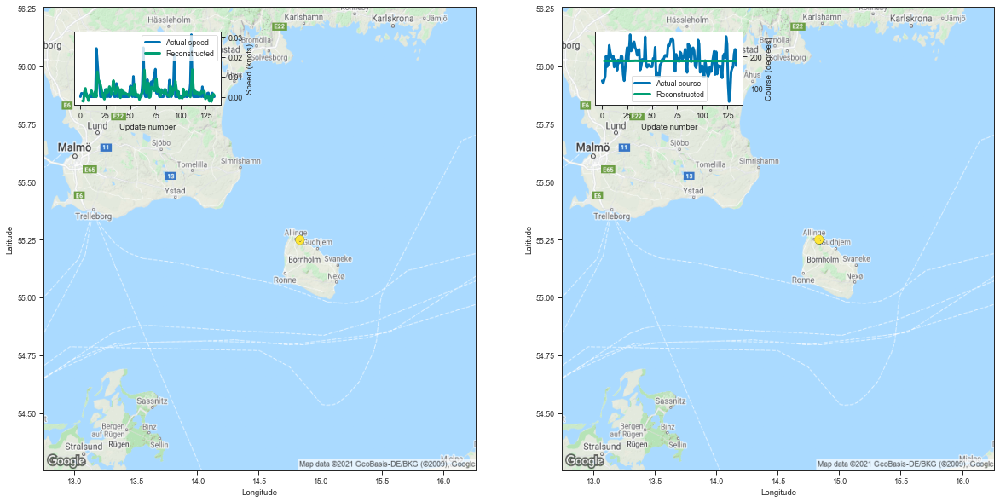

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.838363  55.248344 -0.002094  186.759460         0.001793   
3    14.836649  55.250027 -0.002283  186.606186         0.001181   
4    14.836797  55.248764  0.002663  186.361069         0.000843   
5    14.837512  55.249115  0.004191  186.531738         0.000968   
6    14.837007  55.249561  0.000180  186.476074         0.000916   
..         ...        ...       ...         ...              ...   
130  14.836961  55.248646  0.000127  186.492584         0.000913   
131  14.836840  55.249332 -0.002410  186.400070         0.000830   
132  14.837328  55.249210 -0.000618  186.528824         0.000947   
133  14.836423  55.249886  0.001331  186.426254         0.000862   
134  14.836266  55.249790  0.000671  186.511719         0.000929   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001720     0.012743     92.886918  
3          0.001092     0.009002     98.643366  
4          0.000789     0.004000    

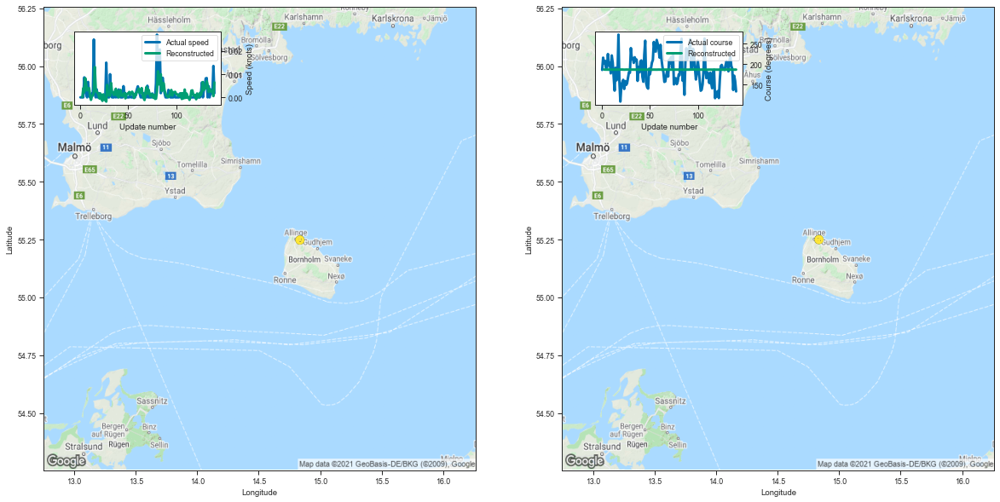

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.835454  55.250092  0.000146  186.544189         0.001394   
3    14.837409  55.249672  0.003923  186.454132         0.000985   
4    14.836789  55.249897  0.002263  186.371979         0.000843   
5    14.837666  55.249939  0.008299  186.379318         0.000825   
6    14.837033  55.250282  0.005438  186.394287         0.000832   
..         ...        ...       ...         ...              ...   
136  14.837564  55.249279  0.002508  186.407654         0.000842   
137  14.837085  55.250378  0.002681  186.488373         0.000908   
138  14.836993  55.249016  0.002905  186.390442         0.000821   
139  14.836895  55.249393  0.000554  186.499741         0.000919   
140  14.836315  55.249870  0.006434  186.490601         0.000918   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001365     0.005930     92.627198  
3          0.000921     0.005153     98.601807  
4          0.000784     0.004108    

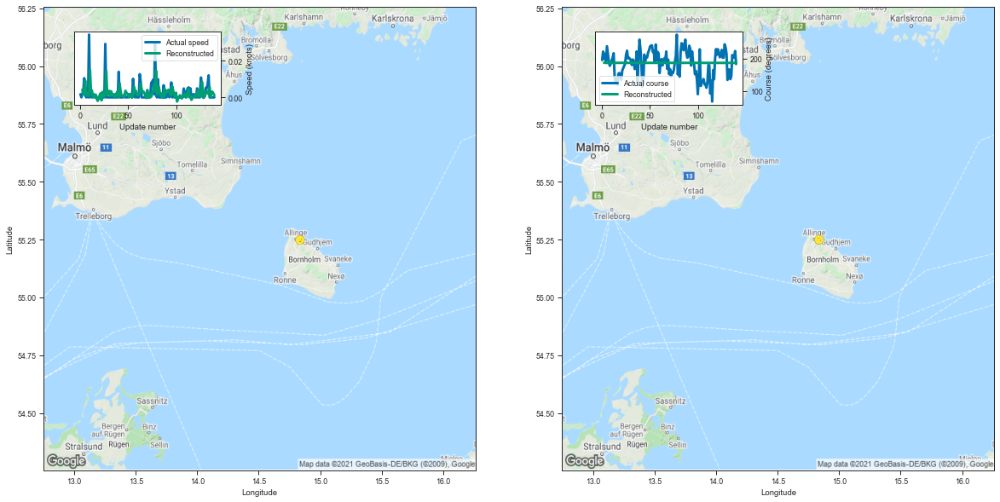

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.836472  55.248844  0.004223  186.762329         0.001752   
3    14.836612  55.249840  0.001502  186.552399         0.001118   
4    14.836828  55.250359  0.004424  186.358459         0.000841   
5    14.837819  55.249912  0.009174  186.496185         0.000933   
6    14.836766  55.248306  0.001439  186.438095         0.000877   
..         ...        ...       ...         ...              ...   
136  14.836285  55.249481 -0.000128  186.352966         0.000779   
137  14.837415  55.249283  0.003202  186.352692         0.000782   
138  14.836818  55.249638  0.002986  186.483093         0.000899   
139  14.837269  55.249298  0.002071  186.423370         0.000852   
140  14.836608  55.249222  0.001170  186.322235         0.000763   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001668     0.013001     93.558800  
3          0.001040     0.007396     98.395274  
4          0.000787     0.003942    

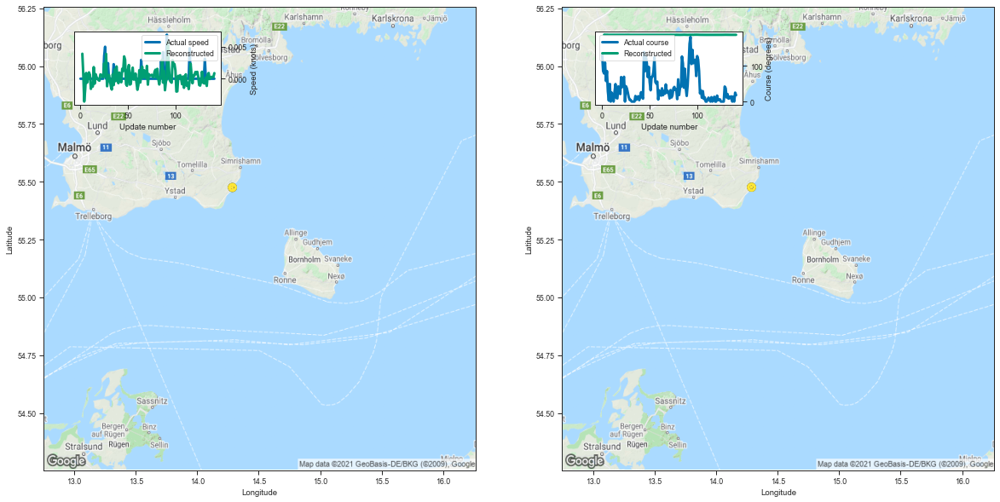

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.287866  55.476505  0.003906  186.809418         0.001381   
3    14.287539  55.477474  0.000662  187.012573         0.001359   
4    14.288628  55.476063 -0.003575  186.665298         0.000920   
5    14.287598  55.476532 -0.001681  186.842529         0.001048   
6    14.288212  55.476654  0.000899  186.641647         0.000862   
..         ...        ...       ...         ...              ...   
137  14.287102  55.477345  0.000195  186.526733         0.000731   
138  14.287895  55.476521  0.000294  186.547318         0.000743   
139  14.287365  55.476990  0.000249  186.468094         0.000688   
140  14.287733  55.476189  0.000256  186.539963         0.000735   
141  14.288052  55.476219  0.000870  186.538208         0.000744   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001327     0.007311     92.840521  
3          0.001215     0.017203     98.997864  
4          0.000851     0.005447    

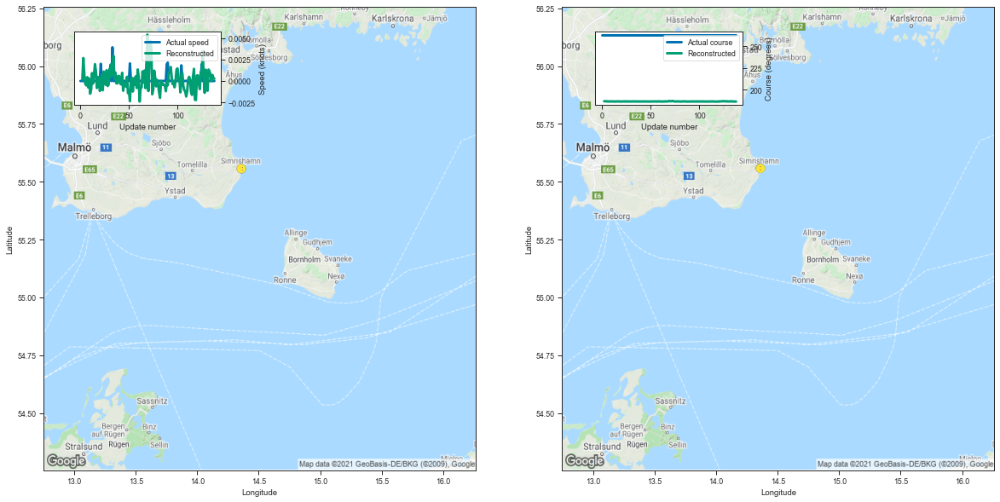

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.360053  55.558102  0.000163  186.734039         0.001372   
3    14.361333  55.557541  0.002668  186.866852         0.001224   
4    14.360271  55.558830  0.000680  186.651474         0.000936   
5    14.360941  55.558067 -0.000302  186.722672         0.000989   
6    14.360201  55.558376 -0.000514  186.484024         0.000761   
..         ...        ...       ...         ...              ...   
134  14.360429  55.558228  0.000719  186.544998         0.000807   
135  14.359949  55.558617 -0.000004  186.500381         0.000758   
136  14.360417  55.558285  0.000696  186.532791         0.000779   
137  14.360581  55.558399  0.000348  186.516312         0.000768   
138  14.360909  55.557632  0.000261  186.428741         0.000698   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001363     0.006351     90.984556  
3          0.001126     0.011503     97.618403  
4          0.000877     0.005679    

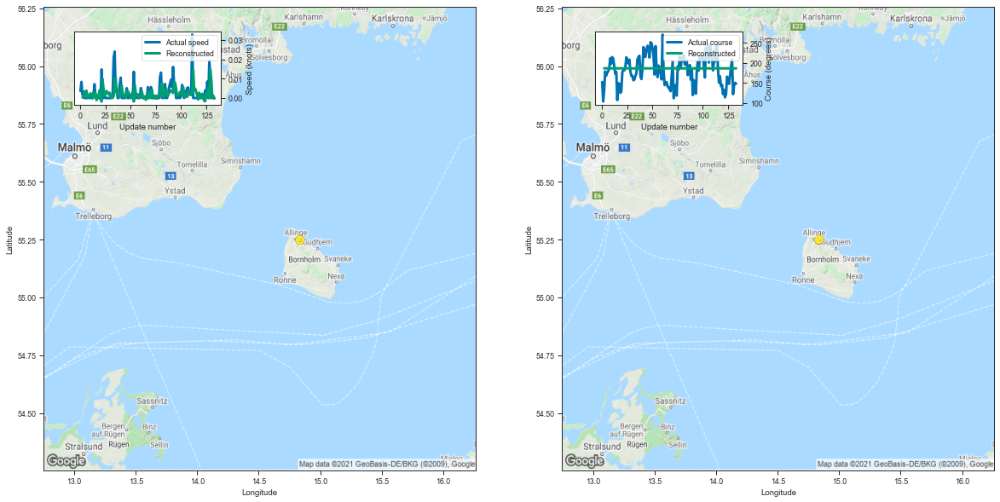

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.837067  55.248680  0.000272  186.636505         0.001545   
3    14.836602  55.249561  0.000748  186.434464         0.000972   
4    14.837938  55.248798  0.003447  186.657379         0.001126   
5    14.837440  55.248787  0.001338  186.345383         0.000814   
6    14.837837  55.249039  0.003811  186.705414         0.001137   
..         ...        ...       ...         ...              ...   
129  14.837992  55.250217  0.014657  186.729950         0.001195   
130  14.836717  55.250446  0.009344  186.501236         0.000958   
131  14.836155  55.250793  0.000184  186.356262         0.000794   
132  14.836329  55.249901  0.001124  186.526871         0.000937   
133  14.836482  55.249767 -0.000289  186.587021         0.001013   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001496     0.008295     92.871961  
3          0.000913     0.004852     98.306053  
4          0.001012     0.011103    

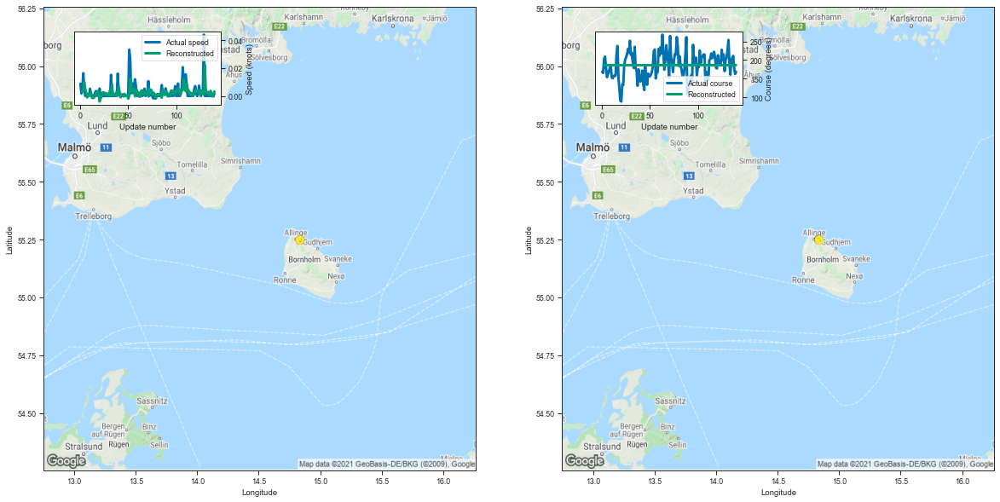

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.835169  55.249538  0.002955  186.748779         0.001735   
3    14.837129  55.249477  0.004203  186.477692         0.001033   
4    14.837080  55.249767  0.009907  186.419724         0.000895   
5    14.836963  55.250381  0.004976  186.530869         0.000970   
6    14.837455  55.248112  0.002239  186.495514         0.000927   
..         ...        ...       ...         ...              ...   
136  14.837270  55.249260  0.003592  186.564651         0.000999   
137  14.836426  55.250275  0.001876  186.549637         0.000982   
138  14.837426  55.249405  0.001395  186.533859         0.000969   
139  14.837027  55.249462 -0.000418  186.347107         0.000791   
140  14.837440  55.248505  0.003274  186.601715         0.001017   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001654     0.012349     93.405550  
3          0.000968     0.005670     98.155320  
4          0.000829     0.004968    

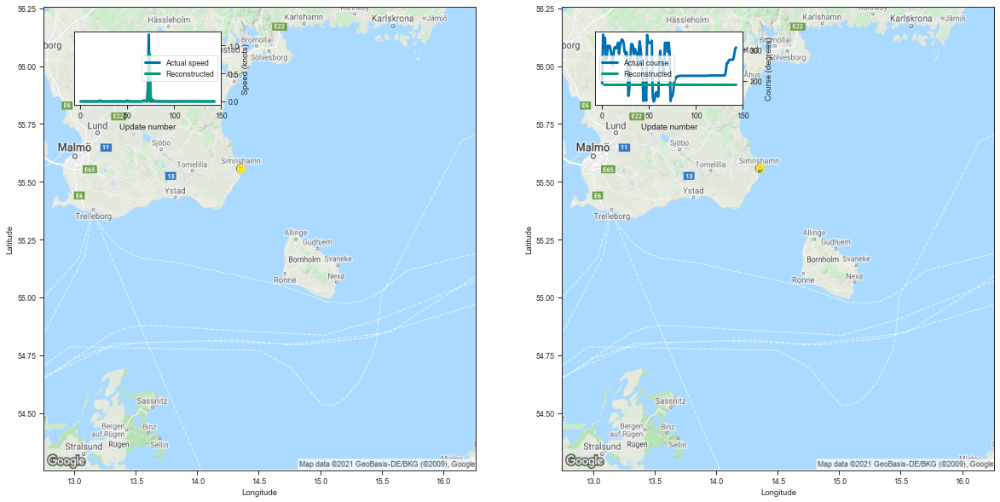

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.356761  55.557915  0.000849  186.656937         0.001235   
3    14.358151  55.558197  0.000587  186.525940         0.000856   
4    14.357953  55.558598  0.000019  186.551758         0.000825   
5    14.359147  55.558407 -0.001101  186.517960         0.000783   
6    14.358718  55.557468  0.000029  186.454788         0.000724   
..         ...        ...       ...         ...              ...   
139  14.360959  55.557663 -0.000590  186.587860         0.000822   
140  14.360692  55.558365 -0.001426  186.552612         0.000801   
141  14.360397  55.558361 -0.001129  186.420029         0.000694   
142  14.360596  55.557476  0.000158  186.525787         0.000770   
143  14.359982  55.557869  0.000383  186.735260         0.000964   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001232     0.004890     91.290948  
3          0.000820     0.003553     96.410849  
4          0.000773     0.004065    

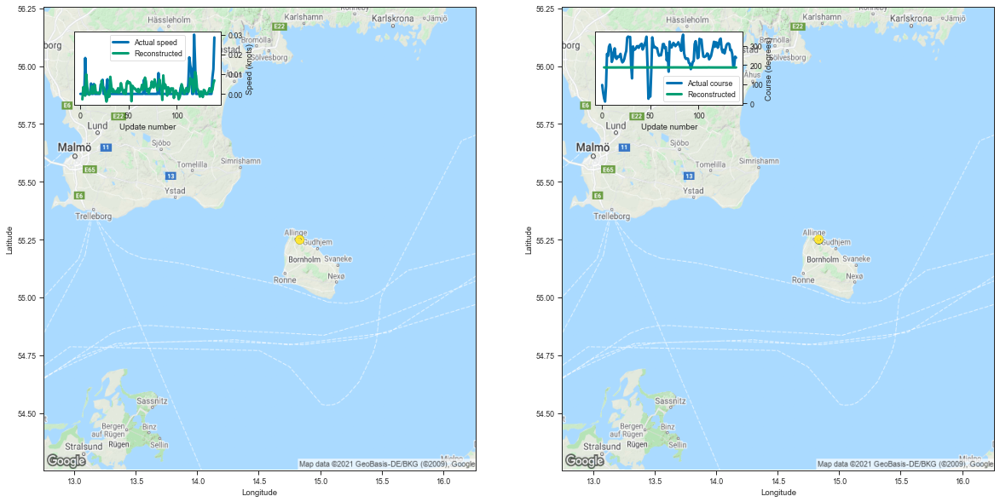

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.835880  55.249100 -0.002771  186.782776         0.001757   
3    14.835135  55.250256  0.003453  186.388855         0.000911   
4    14.835097  55.251026  0.001091  186.395401         0.000833   
5    14.835833  55.251022 -0.000883  186.474564         0.000900   
6    14.836226  55.250397  0.009836  186.330673         0.000786   
..         ...        ...       ...         ...              ...   
135  14.835387  55.251232  0.001256  186.492279         0.000914   
136  14.835532  55.250443  0.000998  186.407013         0.000840   
137  14.835771  55.250980  0.002056  186.384018         0.000814   
138  14.835711  55.251019  0.005383  186.469849         0.000892   
139  14.834693  55.250725  0.006836  186.469177         0.000898   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001665     0.014443     94.064301  
3          0.000858     0.004425     98.737578  
4          0.000768     0.004843    

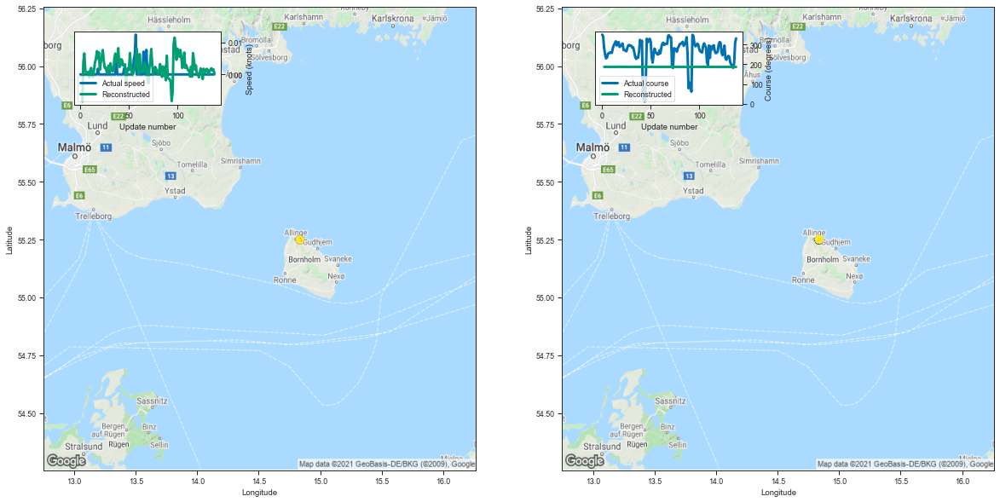

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.836139  55.248283 -0.008537  186.781097         0.001735   
3    14.837367  55.250225  0.003870  186.721695         0.001323   
4    14.836899  55.250137  0.006587  186.639633         0.001145   
5    14.836523  55.250648  0.001190  186.469360         0.000933   
6    14.836571  55.250000  0.000505  186.410492         0.000852   
..         ...        ...       ...         ...              ...   
134  14.837342  55.250702  0.001389  186.505600         0.000945   
135  14.837325  55.251011  0.001935  186.430298         0.000864   
136  14.837292  55.250717  0.001222  186.455093         0.000881   
137  14.836943  55.250431  0.001570  186.556183         0.000976   
138  14.837651  55.250473  0.000347  186.654037         0.001091   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001646     0.014295     94.297754  
3          0.001208     0.013796     99.229409  
4          0.001041     0.010876    

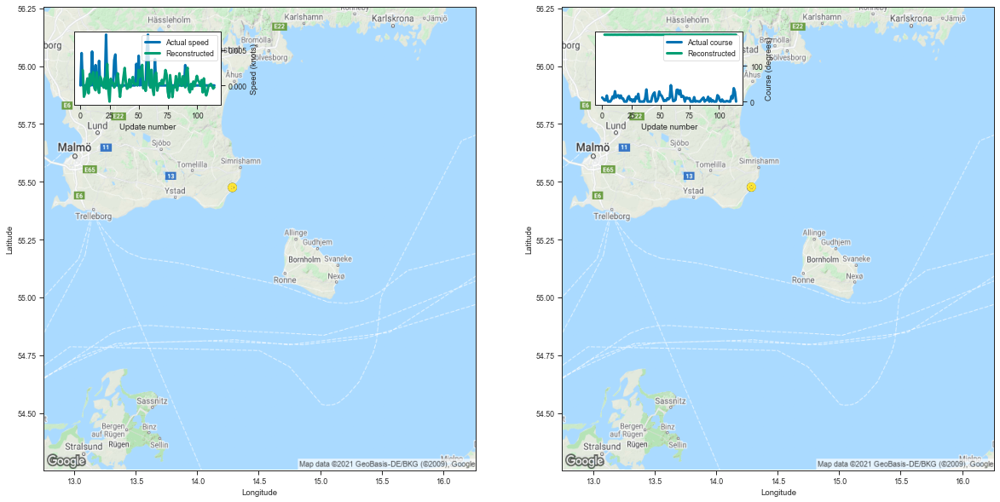

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.286106  55.476578  0.002140  186.655212         0.001149   
3    14.286863  55.477417 -0.001592  186.540421         0.000813   
4    14.287410  55.476971 -0.001113  186.603180         0.000821   
5    14.288224  55.476025 -0.000030  186.540024         0.000757   
6    14.287971  55.476025  0.000978  186.582611         0.000780   
..         ...        ...       ...         ...              ...   
111  14.287756  55.476151  0.000058  186.656998         0.000844   
112  14.287980  55.476139  0.000216  186.475693         0.000699   
113  14.286990  55.476700 -0.000075  186.466873         0.000685   
114  14.287366  55.477055 -0.000446  186.521378         0.000727   
115  14.287426  55.477062 -0.000257  186.500519         0.000712   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001123     0.004483     92.878875  
3          0.000765     0.003437     97.922731  
4          0.000755     0.004553    

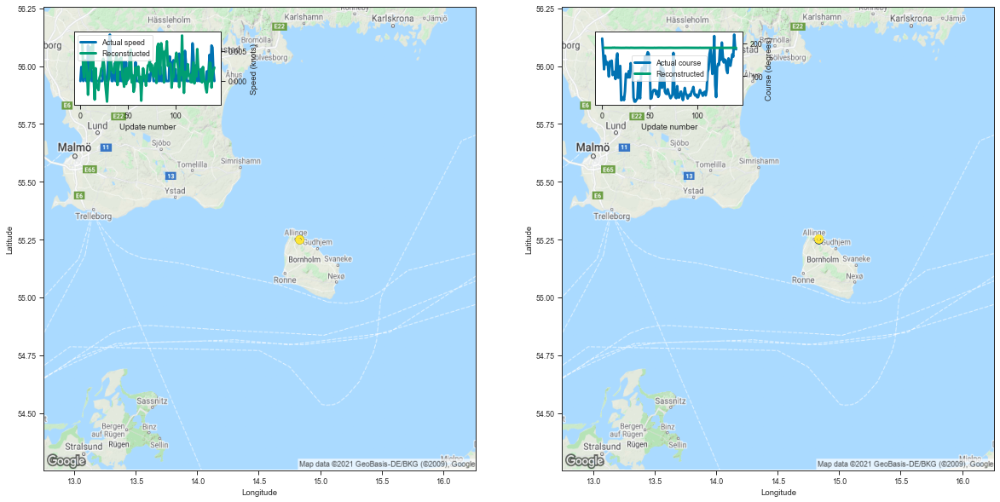

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.836158  55.249172  0.006025  186.599075         0.001519   
3    14.834781  55.251995  0.001655  186.400543         0.000933   
4    14.834499  55.251045  0.000634  186.458359         0.000915   
5    14.835045  55.251217  0.003426  186.423370         0.000863   
6    14.835526  55.250301  0.002882  186.457260         0.000886   
..         ...        ...       ...         ...              ...   
137  14.834963  55.250679  0.002975  186.540573         0.000973   
138  14.835365  55.250717 -0.001088  186.504013         0.000938   
139  14.834754  55.251575  0.000854  186.532227         0.000959   
140  14.834691  55.251354  0.001742  186.623718         0.001058   
141  14.835714  55.252041  0.002229  186.572113         0.001006   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001486     0.007347     92.176398  
3          0.000881     0.004305     98.244299  
4          0.000843     0.005546    

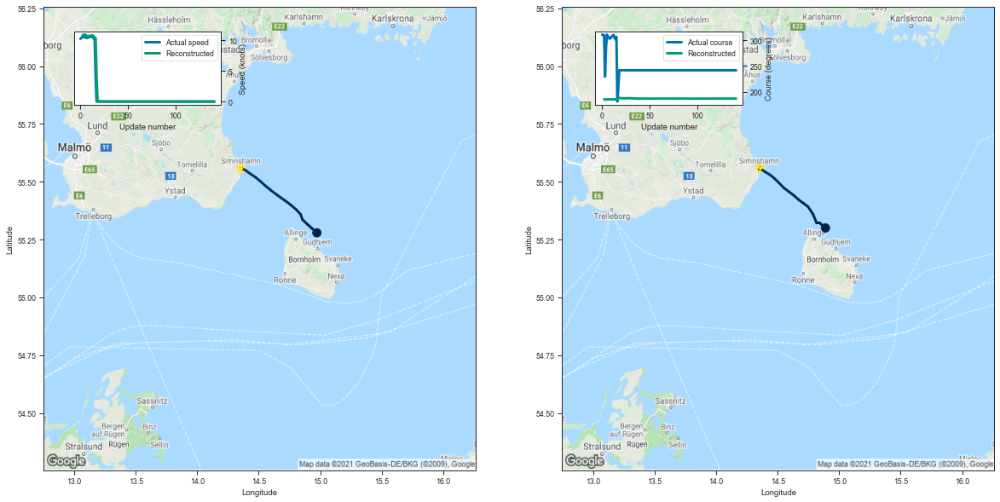

     Longitude   Latitude      Speed      Course  Longitude sigma  \
2    14.888784  55.300228  10.672869  185.243256         0.028611   
3    14.840808  55.322281  10.919540  184.856079         0.016219   
4    14.816572  55.321995  10.849754  184.914185         0.015407   
5    14.787898  55.359688  10.931637  184.617065         0.011352   
6    14.747607  55.391914  10.797588  185.378815         0.021669   
..         ...        ...        ...         ...              ...   
137  14.360489  55.557541   0.002253  186.565369         0.000801   
138  14.359991  55.557968   0.001057  186.522003         0.000770   
139  14.359694  55.558594  -0.000114  186.416275         0.000689   
140  14.360502  55.557774   0.001133  186.588547         0.000822   
141  14.359757  55.558250  -0.000250  186.420578         0.000695   

     Latitude sigma  Speed sigma  Course sigma  
2          0.017092     1.416347     92.393034  
3          0.010137     0.737654     95.746629  
4          0.009616     

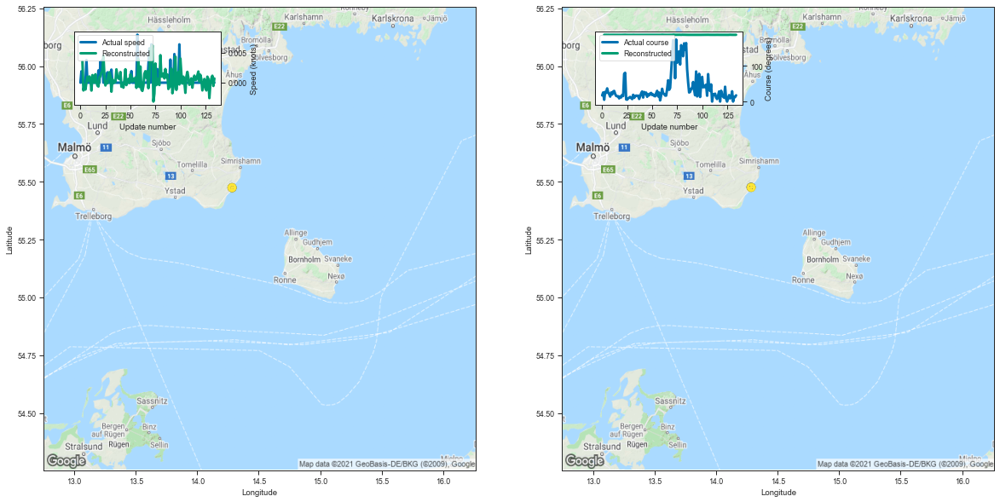

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.284388  55.475971  0.003564  186.691528         0.001187   
3    14.284732  55.475811 -0.001292  186.560089         0.000832   
4    14.285768  55.475380 -0.000312  186.716705         0.000928   
5    14.285717  55.475204 -0.001142  186.489655         0.000722   
6    14.285254  55.475498  0.000061  186.667694         0.000858   
..         ...        ...       ...         ...              ...   
130  14.284390  55.475891 -0.000196  186.567123         0.000766   
131  14.285460  55.475597  0.000679  186.480194         0.000700   
132  14.284737  55.475655  0.001155  186.512009         0.000716   
133  14.284963  55.476135 -0.000547  186.518158         0.000723   
134  14.285238  55.475368  0.000706  186.663681         0.000840   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001153     0.004984     93.087251  
3          0.000780     0.003676     97.993418  
4          0.000842     0.006726    

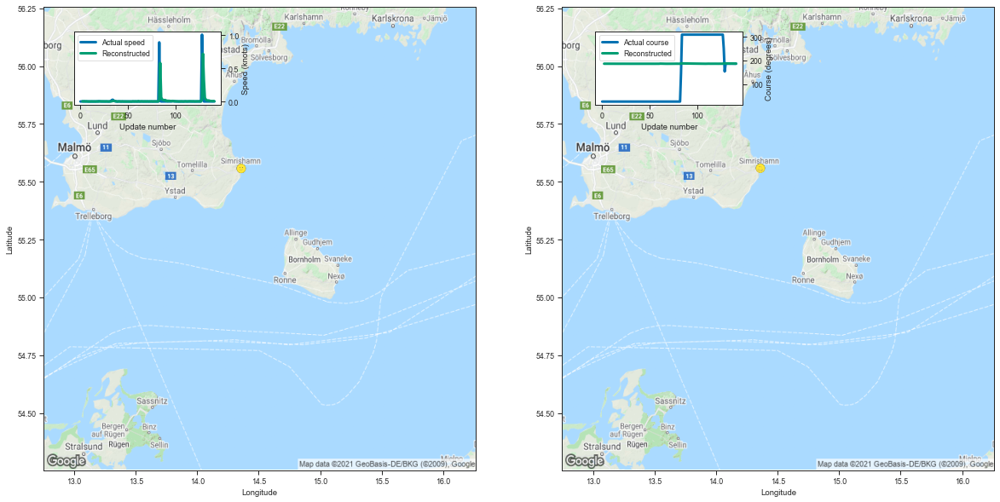

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.359925  55.558853  0.001782  186.668518         0.001248   
3    14.360081  55.558220  0.001863  186.679535         0.000992   
4    14.359212  55.559166  0.004207  186.863281         0.001125   
5    14.358841  55.559624  0.001204  186.676346         0.000930   
6    14.359243  55.558270  0.002639  186.649551         0.000888   
..         ...        ...       ...         ...              ...   
137  14.358890  55.560181  0.006503  187.382339         0.002104   
138  14.359679  55.559067  0.007044  187.183746         0.001697   
139  14.358706  55.559048  0.004738  187.020660         0.001395   
140  14.360430  55.558094  0.007497  187.213531         0.001661   
141  14.360147  55.558281  0.004110  187.019775         0.001365   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001236     0.005407     91.697341  
3          0.000926     0.006441     97.596922  
4          0.001018     0.012382    

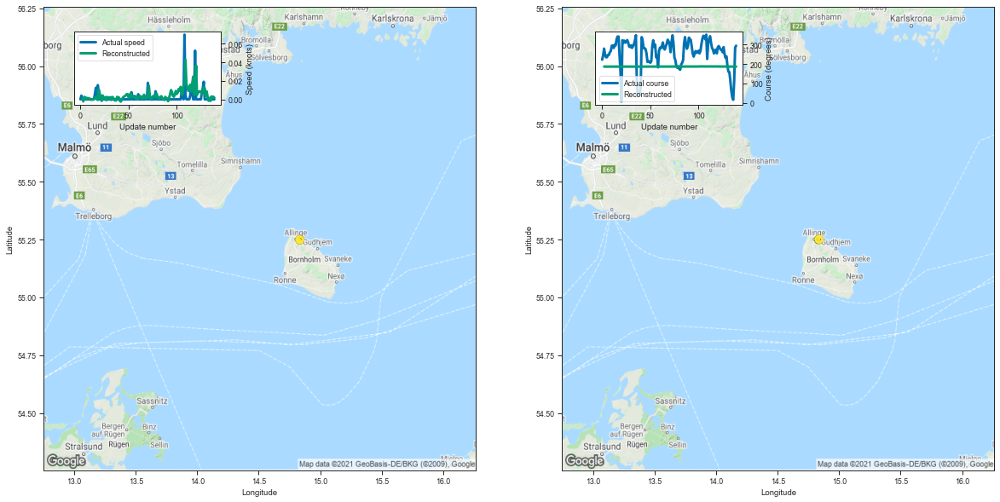

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.834390  55.250439  0.000895  186.675354         0.001598   
3    14.835744  55.250824 -0.002179  186.511124         0.001055   
4    14.834860  55.250694  0.002702  186.427567         0.000899   
5    14.834949  55.250492  0.000556  186.384506         0.000831   
6    14.835171  55.250278  0.001715  186.462036         0.000891   
..         ...        ...       ...         ...              ...   
135  14.834989  55.251194 -0.001654  186.536636         0.000942   
136  14.834844  55.250145  0.003067  186.496414         0.000906   
137  14.835165  55.251175  0.002499  186.728363         0.001148   
138  14.835999  55.251450  0.002764  186.727768         0.001190   
139  14.836226  55.251038  0.001725  186.609619         0.001070   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001540     0.009356     93.097406  
3          0.000986     0.006371     98.468810  
4          0.000834     0.005054    

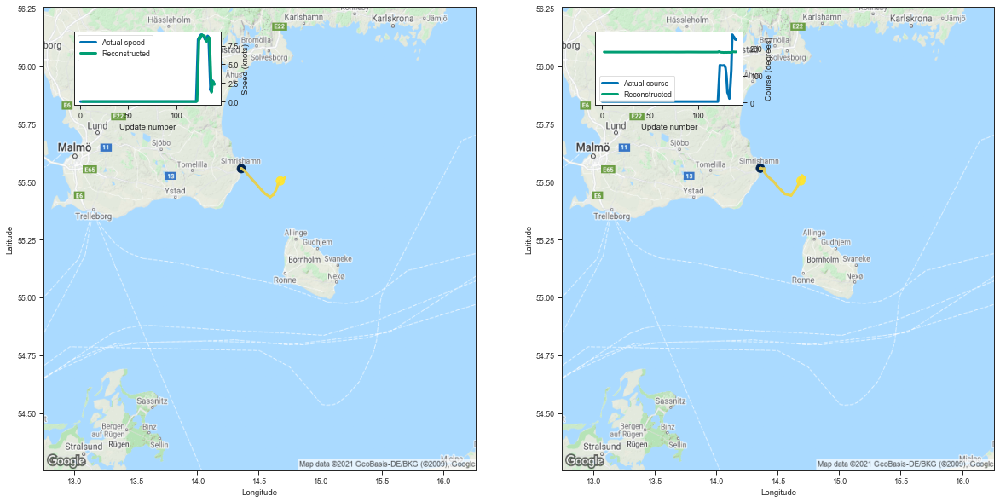

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.359613  55.558434  0.000421  186.937943         0.001600   
3    14.359786  55.558716  0.001757  186.504990         0.000836   
4    14.359598  55.558716  0.002770  186.514969         0.000781   
5    14.359483  55.558601  0.001406  186.477310         0.000737   
6    14.360060  55.558350  0.002769  186.611588         0.000841   
..         ...        ...       ...         ...              ...   
136  14.722830  55.516064  4.939296  186.949265         0.015669   
137  14.699299  55.527008  1.237609  187.722290         0.009992   
138  14.710953  55.508595  2.342898  187.294937         0.010203   
139  14.696257  55.504738  2.684860  187.088440         0.009089   
140  14.688881  55.503891  2.290060  187.451523         0.010991   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001527     0.013884     93.358124  
3          0.000802     0.003522     96.603273  
4          0.000732     0.003788    

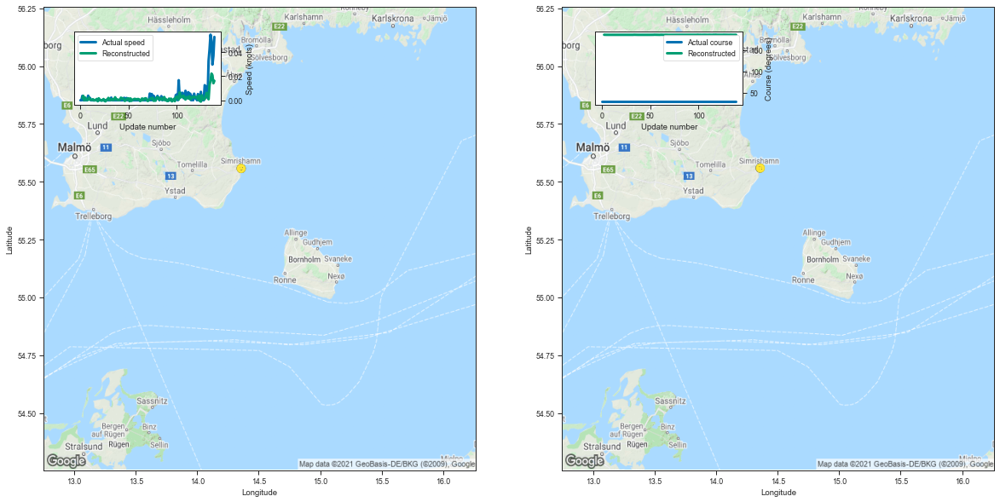

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.357815  55.559048  0.001851  186.606918         0.001145   
3    14.359204  55.558765  0.003629  186.496826         0.000816   
4    14.358450  55.559479 -0.000018  186.448639         0.000728   
5    14.359104  55.558811  0.002159  186.500900         0.000754   
6    14.358987  55.558411  0.000632  186.406509         0.000677   
..         ...        ...       ...         ...              ...   
135  14.359234  55.558624  0.016246  186.401398         0.000675   
136  14.359230  55.558479  0.022140  186.404602         0.000676   
137  14.359585  55.558582  0.020783  186.461777         0.000718   
138  14.359920  55.558060  0.014153  186.532700         0.000774   
139  14.359172  55.559040  0.016120  186.505890         0.000759   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001135     0.004240     91.909948  
3          0.000777     0.003324     96.948218  
4          0.000688     0.002902    

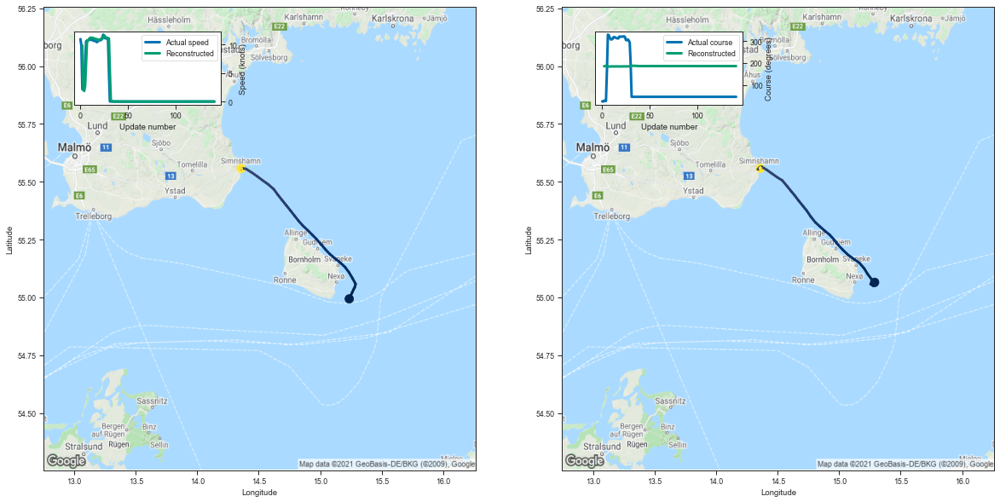

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.288754  55.065044  9.830991  185.709152         0.045228   
3    15.256138  55.057354  2.052069  186.933121         0.007721   
4    15.277743  55.049862  1.852838  187.005386         0.007022   
5    15.289473  55.052814  2.840733  186.557861         0.006744   
6    15.300459  55.051880  7.020498  185.816742         0.015438   
..         ...        ...       ...         ...              ...   
137  14.359169  55.558723 -0.001090  186.596634         0.000819   
138  14.359149  55.558601  0.000226  186.507278         0.000752   
139  14.358861  55.558941 -0.000845  186.406479         0.000673   
140  14.359009  55.558678  0.000461  186.534454         0.000768   
141  14.359511  55.558071 -0.000314  186.416779         0.000680   

     Latitude sigma  Speed sigma  Course sigma  
2          0.024203     2.925627     95.947730  
3          0.005302     0.747587     98.804870  
4          0.004830     0.829063    

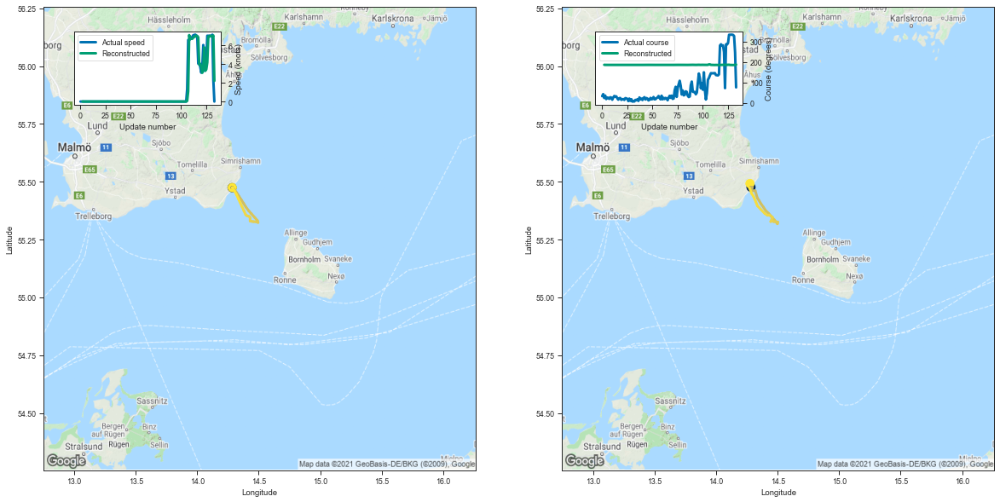

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.283628  55.476181  0.005108  187.018829         0.001679   
3    14.284247  55.475811 -0.001806  186.575546         0.000865   
4    14.284929  55.475567 -0.000876  186.701263         0.000916   
5    14.285140  55.475636 -0.002190  186.549911         0.000771   
6    14.284647  55.475655 -0.001589  186.492493         0.000712   
..         ...        ...       ...         ...              ...   
129  14.303092  55.437569  7.000909  185.845581         0.007895   
130  14.289661  55.448162  6.980183  185.892700         0.007735   
131  14.273651  55.470272  6.886257  186.123901         0.009353   
132  14.258063  55.485546  7.034661  186.460617         0.013832   
133  14.275500  55.492191  2.199222  187.914734         0.011751   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001575     0.015472     94.015328  
3          0.000818     0.003875     97.326754  
4          0.000835     0.006360    

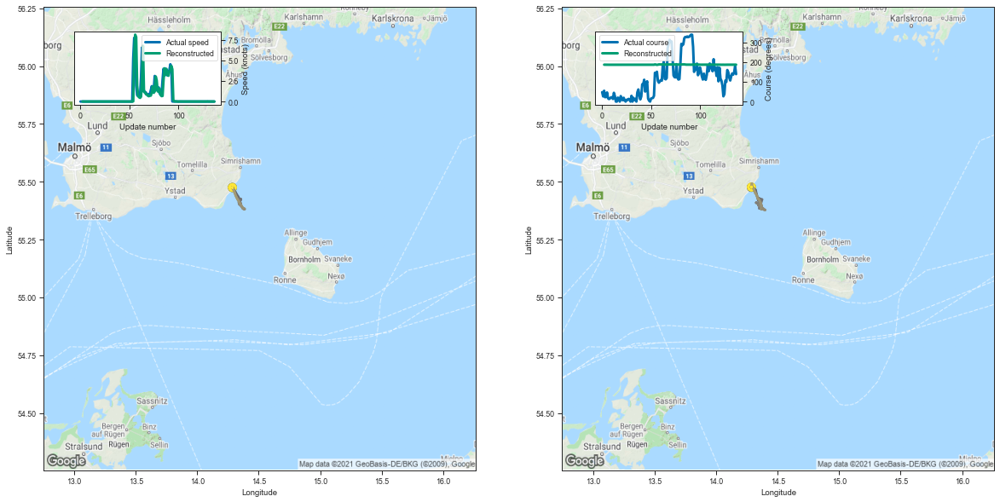

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.286792  55.475964  0.004913  186.817307         0.001367   
3    14.288013  55.476177  0.000374  186.679092         0.000957   
4    14.287321  55.476879 -0.000530  186.535690         0.000772   
5    14.287974  55.475742 -0.000498  186.480133         0.000709   
6    14.287571  55.476780 -0.000108  186.682266         0.000871   
..         ...        ...       ...         ...              ...   
133  14.288119  55.476421  0.000253  186.738373         0.000940   
134  14.288128  55.476795  0.000557  186.884705         0.001105   
135  14.288483  55.476341  0.001569  186.839340         0.001054   
136  14.287441  55.477150 -0.000444  186.833282         0.001048   
137  14.287106  55.476700  0.000877  186.843643         0.001060   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001306     0.007994     93.562719  
3          0.000887     0.005516     98.000144  
4          0.000719     0.003525    

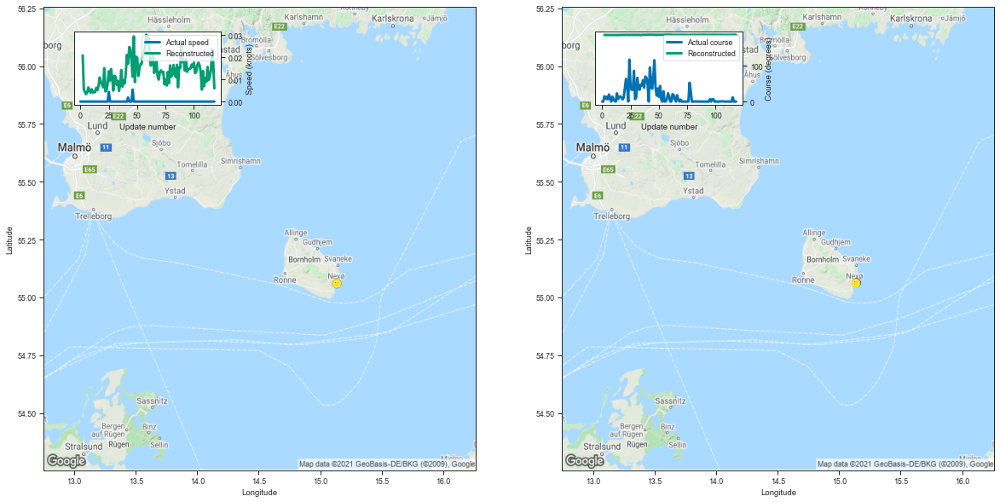

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.139420  55.062576  0.020952  186.850266         0.002272   
3    15.136174  55.061455  0.005472  186.674423         0.001424   
4    15.136655  55.060787  0.004323  186.619553         0.001239   
5    15.135853  55.061089  0.003361  186.502731         0.001075   
6    15.136739  55.060455  0.004169  186.532730         0.001093   
..         ...        ...       ...         ...              ...   
114  15.136672  55.061512  0.011322  186.994568         0.001838   
115  15.137358  55.060707  0.014194  187.064713         0.001998   
116  15.137023  55.060162  0.023610  187.313599         0.002643   
117  15.136373  55.060677  0.017412  187.318161         0.002756   
118  15.135944  55.061150  0.005978  186.753326         0.001528   

     Latitude sigma  Speed sigma  Course sigma  
2          0.002091     0.034849     95.639603  
3          0.001282     0.021368    101.229401  
4          0.001108     0.018314    

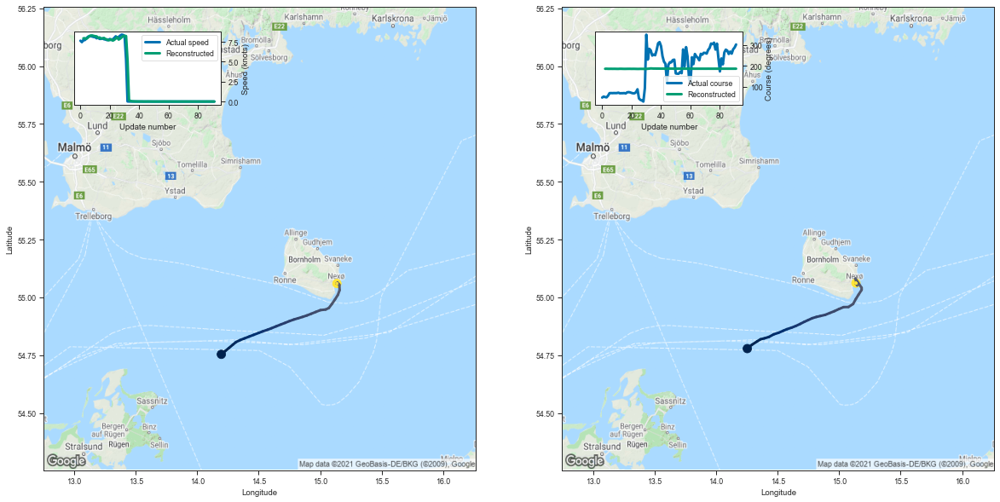

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.253442  54.778358  7.944908  185.960526         0.013667   
3   14.291589  54.795113  7.959781  186.160416         0.014130   
4   14.332480  54.809231  7.887397  185.782135         0.009586   
5   14.360812  54.818665  8.022005  185.755096         0.009691   
6   14.391883  54.822670  8.226519  185.890182         0.012062   
..        ...        ...       ...         ...              ...   
87  15.137075  55.061756 -0.001351  186.264526         0.000813   
88  15.137210  55.061581 -0.001306  186.263046         0.000810   
89  15.136963  55.061314 -0.001968  186.263092         0.000810   
90  15.136996  55.061493 -0.001129  186.316040         0.000856   
91  15.136589  55.061844 -0.001841  186.268341         0.000818   

    Latitude sigma  Speed sigma  Course sigma  
2         0.008377     0.546138     95.752234  
3         0.008211     1.065052    101.266053  
4         0.005861     0.462632    100.396402  
5  

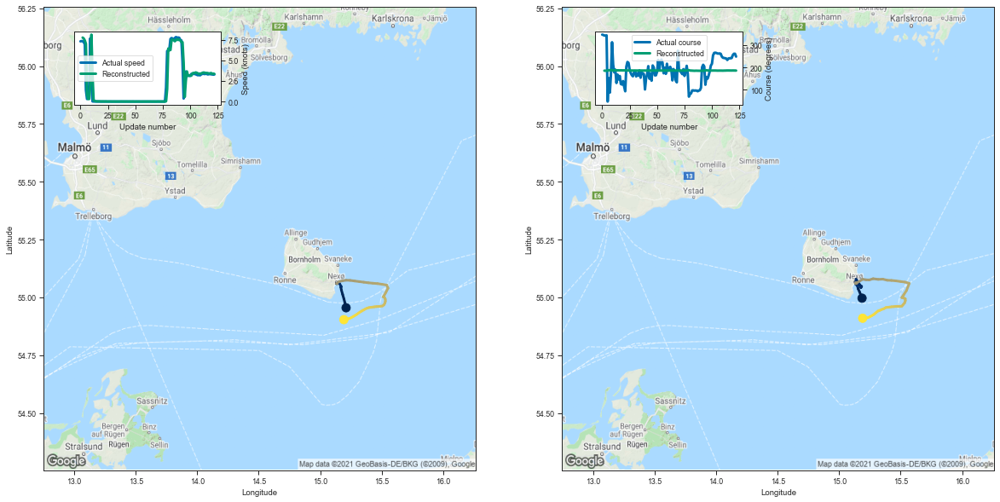

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.186312  54.996544  7.781810  185.718338         0.021236   
3    15.167011  55.022484  7.668950  185.539108         0.013767   
4    15.154376  55.037460  7.427183  185.182739         0.008234   
5    15.147374  55.057987  7.028868  186.182938         0.018205   
6    15.183190  55.047394  0.961614  187.758804         0.009889   
..         ...        ...       ...         ...              ...   
118  15.251364  54.916630  3.428983  186.369537         0.006549   
119  15.236561  54.912598  3.469409  186.546219         0.007779   
120  15.220742  54.911095  3.372654  186.425720         0.006689   
121  15.207597  54.909832  3.394871  186.365509         0.006164   
122  15.191324  54.909714  3.362095  186.157623         0.004827   

     Latitude sigma  Speed sigma  Course sigma  
2          0.012865     1.222093     93.469596  
3          0.008480     0.864653     97.196161  
4          0.005417     0.294110    

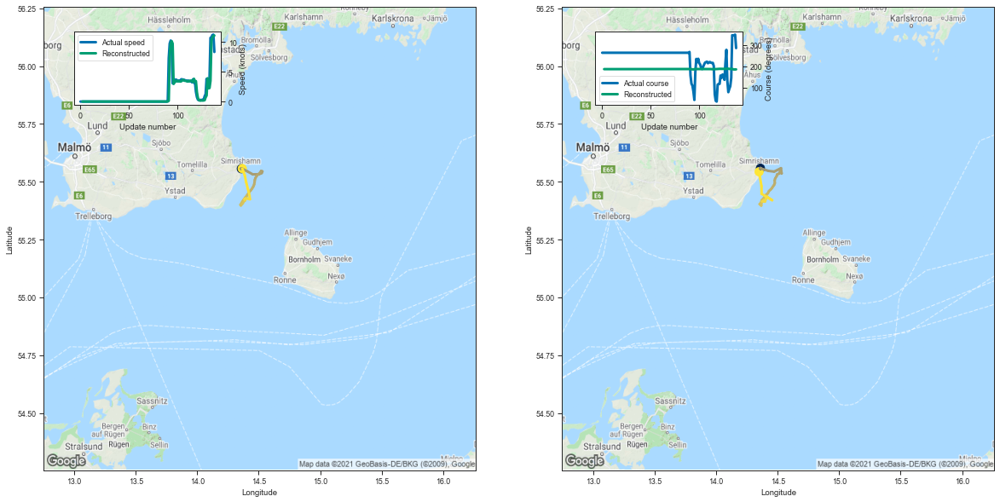

     Longitude   Latitude      Speed      Course  Longitude sigma  \
2    14.360112  55.558212   0.000976  186.607819         0.001181   
3    14.360863  55.558064   0.000642  186.678360         0.001011   
4    14.360622  55.557995  -0.000585  186.540237         0.000827   
5    14.360840  55.557854  -0.000911  186.467102         0.000743   
6    14.360998  55.557999   0.001508  186.874649         0.001119   
..         ...        ...        ...         ...              ...   
134  14.455743  55.420040   3.482469  187.804276         0.021325   
135  14.369778  55.447582  10.258253  185.505066         0.019346   
136  14.368748  55.480877  10.726219  185.159561         0.013914   
137  14.358720  55.512283  11.000654  185.272888         0.016285   
138  14.349388  55.543217  11.084446  185.428436         0.019472   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001184     0.003993     90.954820  
3          0.000949     0.006104     96.935243  
4          0.000780     

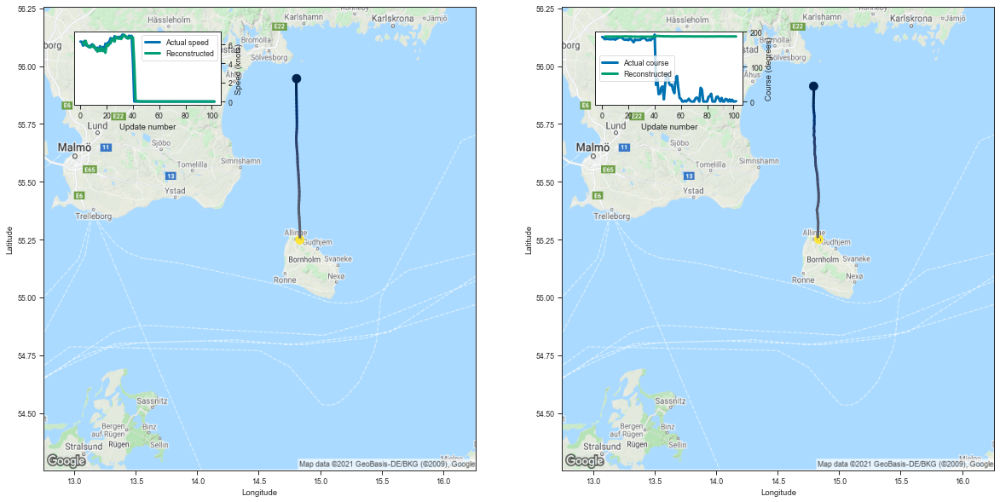

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.792690  55.913197  6.238863  185.834045         0.012356   
3    14.794522  55.892181  5.978880  186.048950         0.010853   
4    14.793986  55.875320  6.376865  186.072083         0.012330   
5    14.792626  55.860687  5.883652  186.029602         0.009939   
6    14.792030  55.840168  5.881319  186.024368         0.009656   
..         ...        ...       ...         ...              ...   
98   14.835555  55.250233  0.001812  186.560745         0.000954   
99   14.834771  55.250259 -0.002571  186.519318         0.000916   
100  14.835398  55.250385 -0.000297  186.377472         0.000792   
101  14.835458  55.250530 -0.001760  186.420334         0.000816   
102  14.834487  55.250919 -0.000880  186.384430         0.000791   

     Latitude sigma  Speed sigma  Course sigma  
2          0.009094     0.307544     84.310684  
3          0.007609     0.543636     90.788850  
4          0.008366     0.760900    

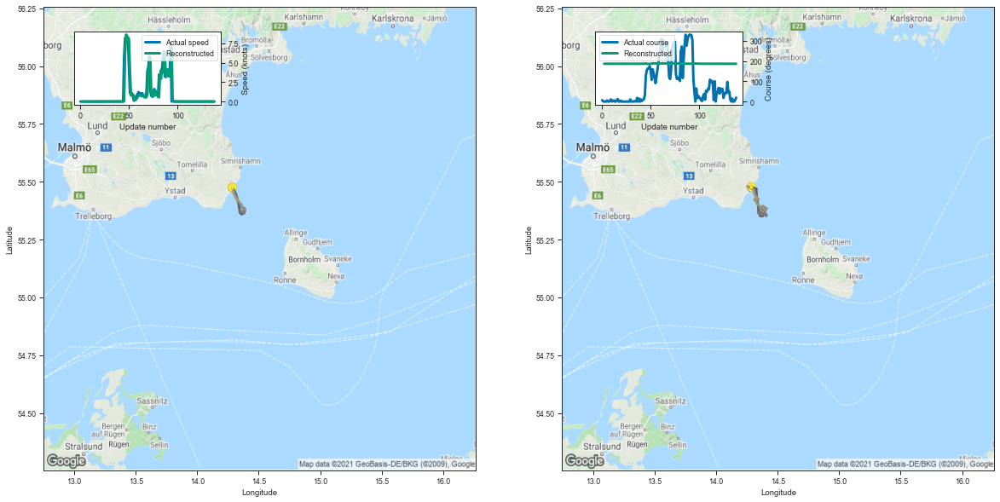

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.286583  55.476341  0.002874  186.650894         0.001139   
3    14.286556  55.476913 -0.000436  186.531876         0.000804   
4    14.287469  55.476822 -0.000933  186.485245         0.000722   
5    14.287468  55.476673 -0.000341  186.541946         0.000752   
6    14.287064  55.477150 -0.000369  186.665878         0.000849   
..         ...        ...       ...         ...              ...   
134  14.288228  55.476303  0.000183  186.461334         0.000678   
135  14.288381  55.476883 -0.000559  186.495392         0.000705   
136  14.287900  55.476982 -0.000693  186.463211         0.000680   
137  14.287968  55.476582  0.000302  186.461075         0.000678   
138  14.287815  55.477089 -0.000438  186.482986         0.000695   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001112     0.004446     93.028930  
3          0.000756     0.003349     97.997788  
4          0.000673     0.002964    

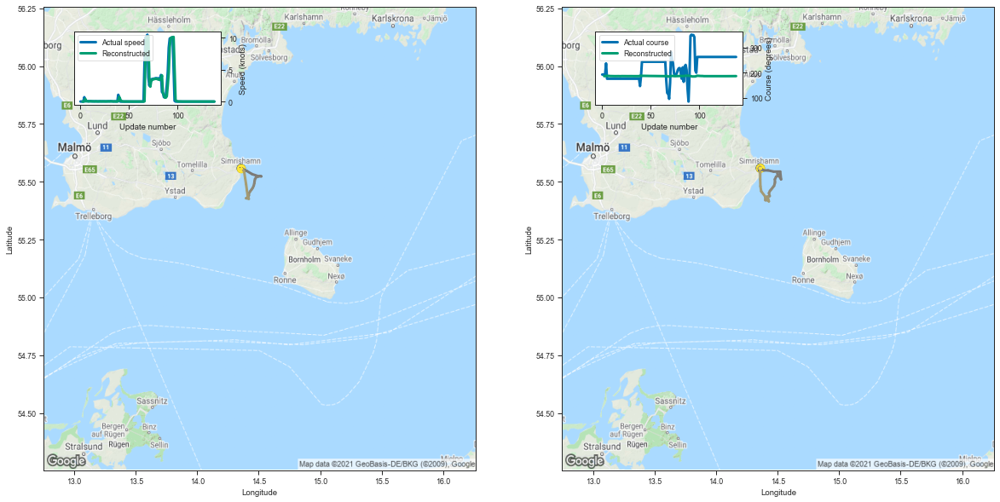

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.359242  55.558918  0.004358  186.637253         0.001216   
3    14.359107  55.558716  0.000728  186.602158         0.000932   
4    14.360497  55.559483  0.017440  187.957962         0.003509   
5    14.350726  55.554043  0.429195  187.589737         0.003819   
6    14.362371  55.554756  0.070208  187.397049         0.002330   
..         ...        ...       ...         ...              ...   
134  14.360629  55.558060 -0.000759  186.444305         0.000722   
135  14.360874  55.557800 -0.000292  186.564194         0.000804   
136  14.361011  55.557377 -0.000639  186.478271         0.000737   
137  14.360584  55.558220  0.000407  186.728378         0.000956   
138  14.360945  55.557880  0.001596  186.773132         0.001017   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001211     0.004436     91.172340  
3          0.000883     0.004566     96.611946  
4          0.002739     0.435183    

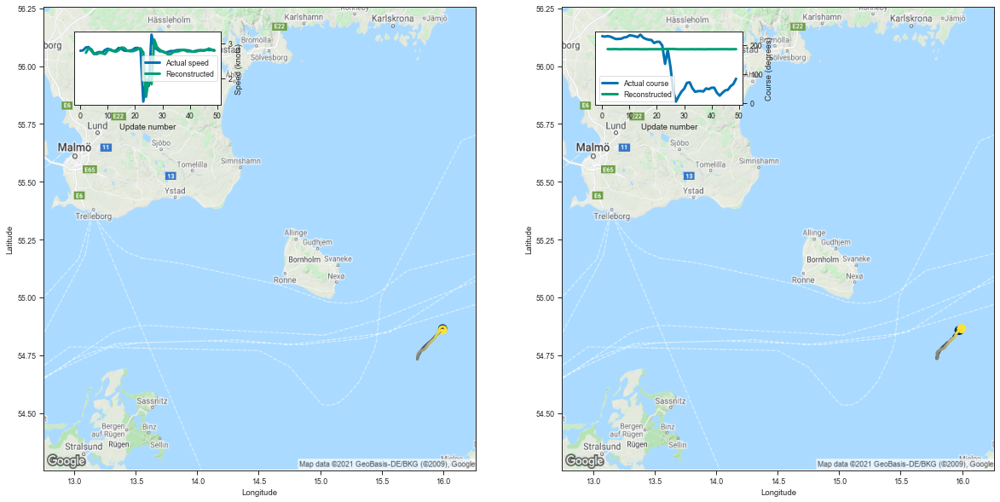

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.975454  54.857071  2.729095  186.178299         0.009681   
3   15.964656  54.851170  2.860053  185.763794         0.005223   
4   15.957661  54.843914  2.832314  186.119202         0.006749   
5   15.945999  54.840099  2.703874  186.251923         0.007463   
6   15.934306  54.832973  2.687977  185.788330         0.004495   
7   15.929886  54.827030  2.729050  185.629822         0.003538   
8   15.921288  54.821293  2.713632  186.085617         0.005490   
9   15.912314  54.818668  2.690404  185.931488         0.004861   
10  15.903288  54.812202  2.794183  185.798935         0.004255   
11  15.889027  54.806702  2.825589  185.836899         0.004331   
12  15.880749  54.804413  2.782793  185.947693         0.004765   
13  15.868301  54.798042  2.758611  185.899231         0.004481   
14  15.860890  54.793388  2.801263  185.606720         0.003294   
15  15.848277  54.788864  2.877397  185.675400         0.00345

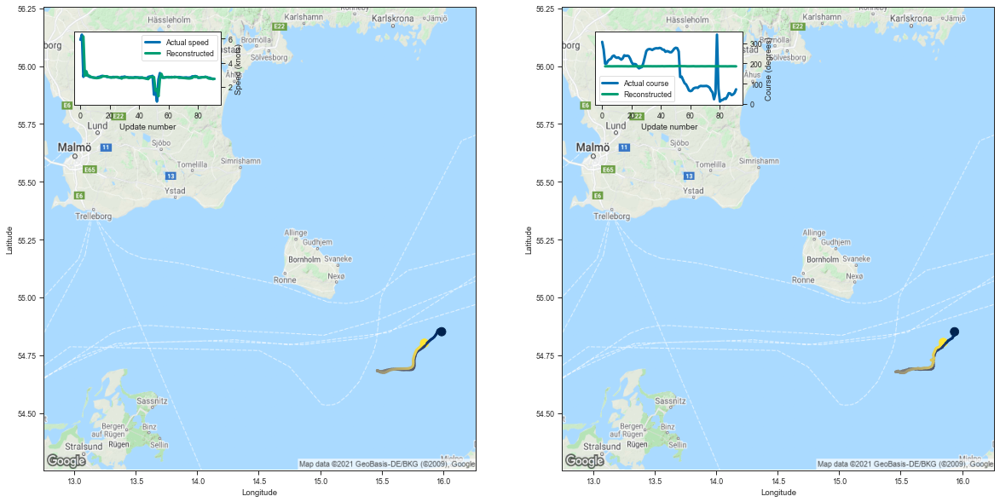

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.938395  54.851425  6.179768  185.698608         0.021609   
3   15.944800  54.855511  2.926779  186.043777         0.007390   
4   15.941020  54.844242  3.294205  185.818985         0.006219   
5   15.938219  54.835567  2.919371  186.042618         0.006348   
6   15.927040  54.830830  2.927334  185.755829         0.004633   
..        ...        ...       ...         ...              ...   
87  15.806114  54.783989  2.704556  185.929489         0.003923   
88  15.817419  54.788452  2.679212  185.995850         0.004355   
89  15.826648  54.795231  2.692545  185.858734         0.003881   
90  15.836236  54.800179  2.641639  185.815613         0.003566   
91  15.846482  54.805252  2.666504  185.620300         0.002935   

    Latitude sigma  Speed sigma  Course sigma  
2         0.012823     1.212353     92.868917  
3         0.004960     0.380890     97.136396  
4         0.004158     0.297928     98.532112  
5  

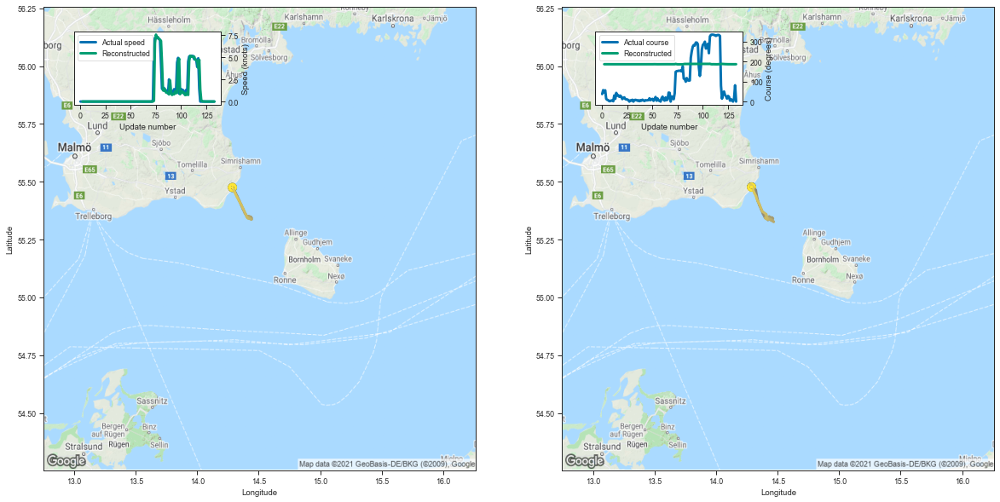

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.287895  55.477551  0.001706  186.656189         0.001158   
3    14.287748  55.476944 -0.001838  186.694946         0.000969   
4    14.288837  55.475880 -0.002033  186.519882         0.000764   
5    14.287571  55.476063 -0.002316  186.624832         0.000822   
6    14.287966  55.475998 -0.000921  186.476166         0.000702   
..         ...        ...       ...         ...              ...   
129  14.287574  55.476646  0.001000  186.468063         0.000689   
130  14.286843  55.477402 -0.000561  186.542816         0.000741   
131  14.288319  55.476162  0.000362  186.470871         0.000688   
132  14.288357  55.476250  0.002252  186.767975         0.000939   
133  14.288305  55.476673  0.001129  186.698456         0.000904   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001131     0.004298     92.615110  
3          0.000895     0.005857     98.217452  
4          0.000712     0.003261    

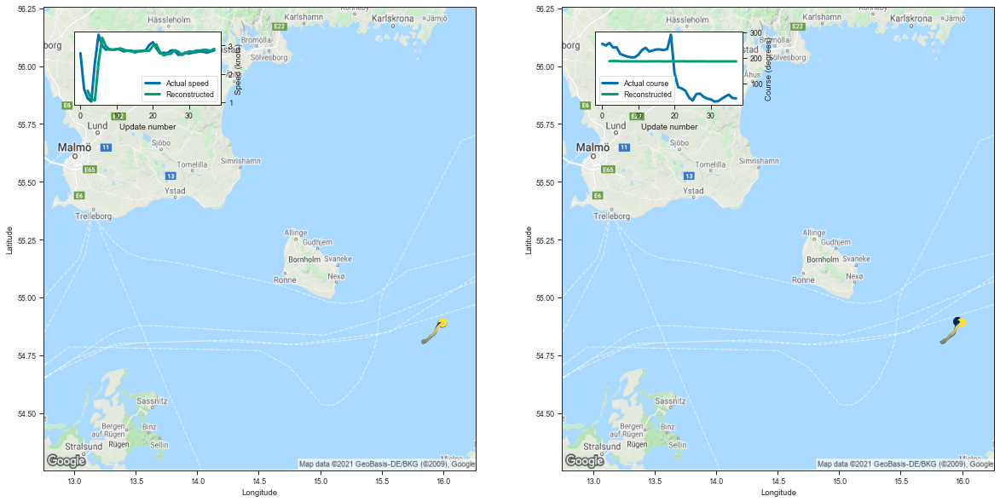

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.964214  54.895424  1.403455  186.701614         0.010380   
3   15.972884  54.892559  1.108990  186.993301         0.009653   
4   15.964831  54.892212  1.067730  186.847427         0.007737   
5   15.966110  54.887032  2.388042  186.161957         0.006435   
6   15.955159  54.881702  3.271837  185.777328         0.005848   
7   15.950549  54.870255  2.977245  185.724106         0.004629   
8   15.945781  54.861652  2.861662  185.677231         0.004030   
9   15.940680  54.853409  2.852725  185.835510         0.004631   
10  15.936215  54.846806  2.859250  185.505203         0.003292   
11  15.927400  54.840305  2.896837  185.556503         0.003313   
12  15.916747  54.836586  2.852176  185.732330         0.003943   
13  15.904645  54.832291  2.802309  185.721069         0.003831   
14  15.895118  54.827568  2.825973  185.764694         0.004006   
15  15.885326  54.822563  2.747334  186.165268         0.00592

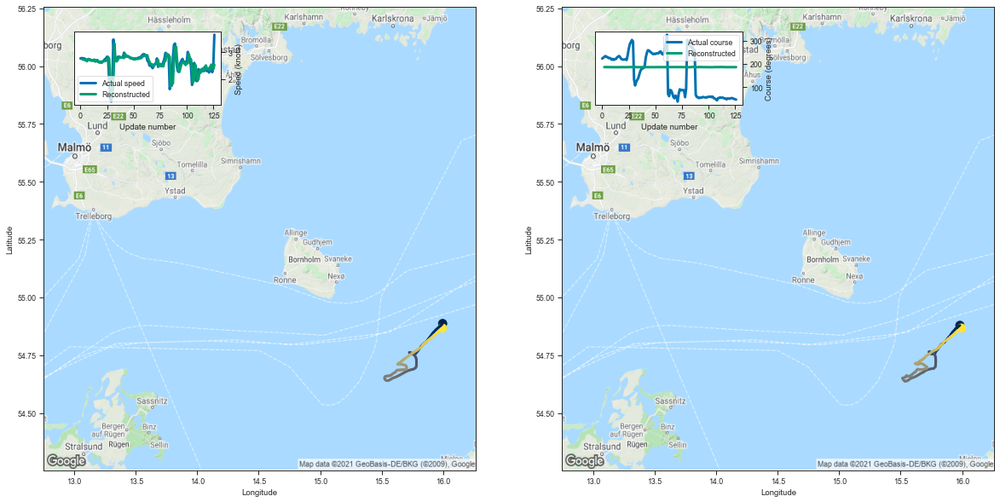

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.981874  54.878849  2.724897  186.170532         0.009693   
3    15.970091  54.874481  2.733261  186.116180         0.007393   
4    15.959080  54.868729  2.707229  186.181030         0.007280   
5    15.947273  54.865093  2.720985  185.995010         0.005886   
6    15.937787  54.858021  2.663246  186.109375         0.006161   
..         ...        ...       ...         ...              ...   
122  15.956080  54.851246  2.349967  185.898193         0.004040   
123  15.967388  54.855125  2.535010  185.733002         0.003587   
124  15.976253  54.858952  2.524229  185.951294         0.004540   
125  15.985079  54.862225  2.371045  185.959412         0.004441   
126  15.994094  54.867043  2.530384  186.039215         0.005174   

     Latitude sigma  Speed sigma  Course sigma  
2          0.006666     0.420268     92.635416  
3          0.004986     0.414593     97.335619  
4          0.004803     0.508143    

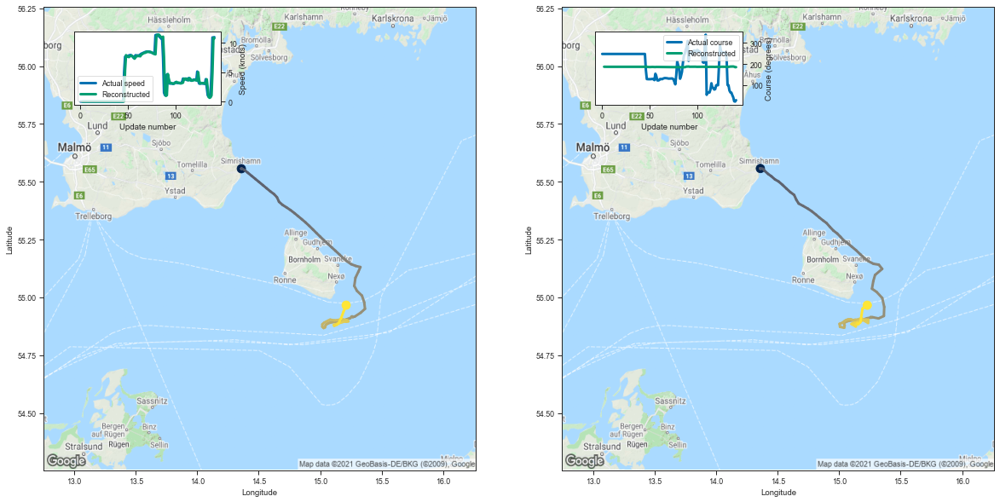

     Longitude   Latitude      Speed      Course  Longitude sigma  \
2    14.359681  55.557270  -0.001029  186.715240         0.001312   
3    14.360064  55.557793  -0.004053  186.515793         0.000852   
4    14.360079  55.557579  -0.002684  186.501602         0.000784   
5    14.360078  55.557716   0.000891  186.491882         0.000760   
6    14.359896  55.557808   0.000130  186.505569         0.000760   
..         ...        ...        ...         ...              ...   
137  15.149605  54.887978   0.726477  187.482758         0.006350   
138  15.155616  54.884052   1.046350  187.973236         0.011915   
139  15.172854  54.892349   4.947344  186.925552         0.021273   
140  15.190692  54.951889  10.853184  184.736038         0.017682   
141  15.228881  54.966053  10.739153  184.871246         0.018156   

     Latitude sigma  Speed sigma  Course sigma  
2          0.001293     0.005770     91.564425  
3          0.000817     0.003315     96.228686  
4          0.000740     

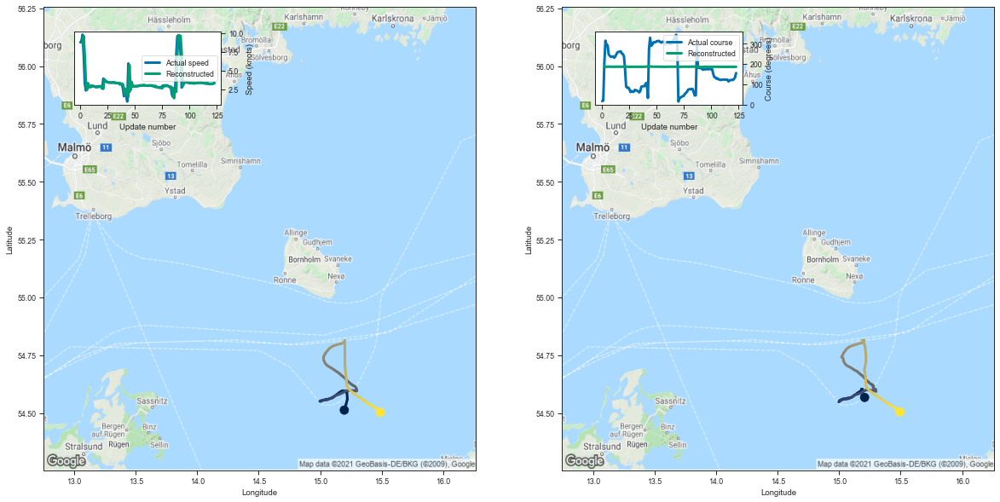

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.207193  54.567154  8.594040  185.669617         0.025872   
3    15.202019  54.567368  9.597250  185.641571         0.030572   
4    15.181313  54.603348  6.962175  186.109787         0.018838   
5    15.190330  54.602703  3.552921  186.406860         0.006930   
6    15.189413  54.598663  2.419072  186.860031         0.006778   
..         ...        ...       ...         ...              ...   
119  15.444402  54.524796  3.247781  186.112183         0.004650   
120  15.456747  54.520996  3.261120  185.713120         0.003176   
121  15.468498  54.517685  3.237390  185.956543         0.003912   
122  15.481389  54.511559  3.254063  186.143188         0.004898   
123  15.494072  54.504875  3.312056  185.744568         0.003447   

     Latitude sigma  Speed sigma  Course sigma  
2          0.014289     1.638860     97.664735  
3          0.015924     2.431433    101.755677  
4          0.010534     1.808349    

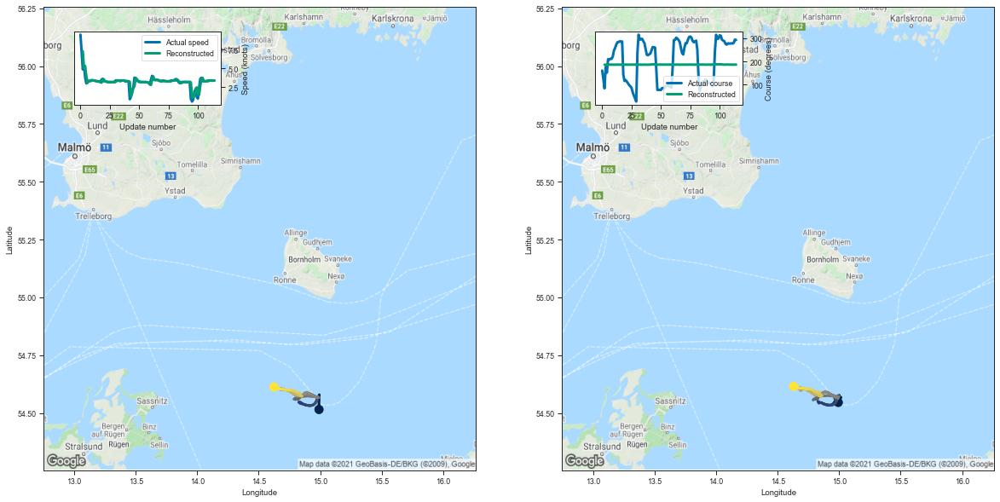

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.992969  54.545589  7.308670  186.131088         0.022674   
3    15.014886  54.567318  5.075694  186.012314         0.007509   
4    15.005055  54.570583  5.334329  185.932449         0.006979   
5    15.000997  54.576225  3.971723  186.129440         0.004882   
6    14.981367  54.572067  3.065265  186.433746         0.004619   
..         ...        ...       ...         ...              ...   
110  14.688905  54.607891  3.401792  186.298553         0.003915   
111  14.672170  54.608303  3.393619  186.312683         0.003836   
112  14.658422  54.609444  3.408401  186.258347         0.003610   
113  14.645511  54.610214  3.372013  186.391617         0.004016   
114  14.630126  54.614914  3.401171  186.348389         0.003888   

     Latitude sigma  Speed sigma  Course sigma  
2          0.012820     1.572127     97.731741  
3          0.004887     0.365959     99.734437  
4          0.004494     0.374791    

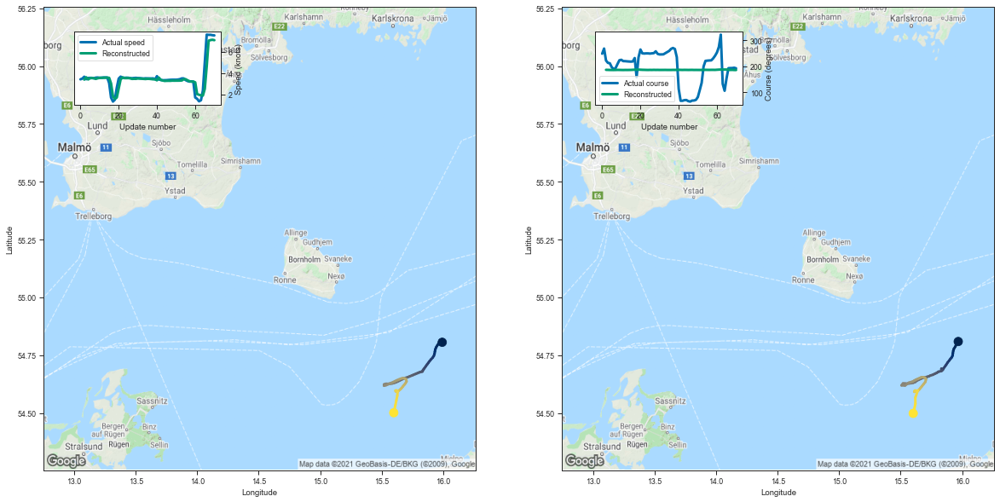

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.968437  54.809029  3.398836  186.035126         0.010807   
3   15.953274  54.797695  3.618854  185.795944         0.007404   
4   15.945293  54.787636  3.414755  185.521683         0.004602   
5   15.933158  54.777756  3.523423  185.430588         0.004028   
6   15.927726  54.768303  3.544706  185.339890         0.003544   
..        ...        ...       ...         ...              ...   
66  15.639765  54.597065  4.641285  186.381683         0.013678   
67  15.619388  54.565868  7.036795  185.582031         0.014717   
68  15.620250  54.539742  7.097742  185.868668         0.019239   
69  15.611572  54.517902  7.125362  185.354767         0.011913   
70  15.602420  54.498188  7.086611  185.312119         0.010486   

    Latitude sigma  Speed sigma  Course sigma  
2         0.007214     0.497609     93.510705  
3         0.004935     0.349799     97.420541  
4         0.003189     0.122536     98.130190  
5  

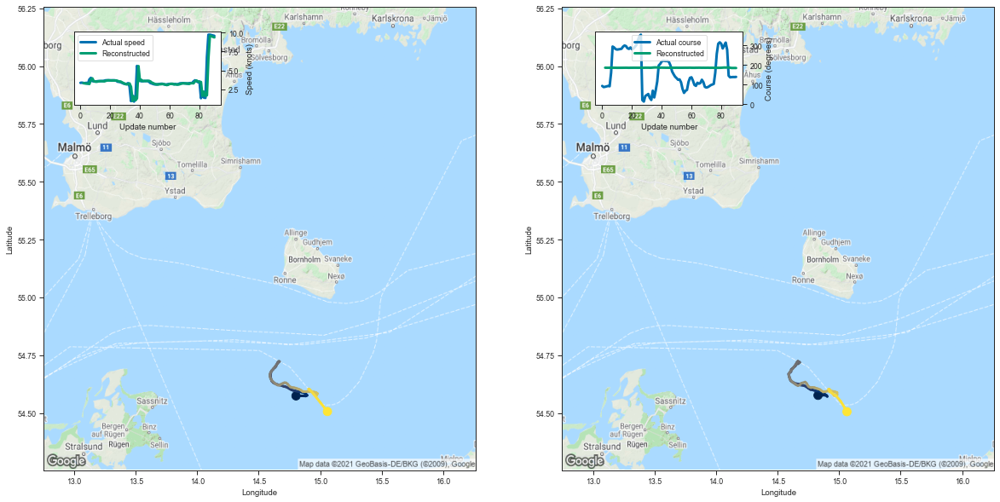

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.828696  54.576359  3.323068  186.545700         0.006846   
3   14.846672  54.576717  3.288654  186.314850         0.004416   
4   14.865424  54.576797  3.257690  186.288956         0.004009   
5   14.884507  54.576744  3.293217  186.393066         0.004447   
6   14.898989  54.575668  3.212559  186.277695         0.003911   
..        ...        ...       ...         ...              ...   
86  14.922552  54.592144  6.575158  186.320862         0.016694   
87  14.974681  54.574646  9.550413  185.248917         0.015635   
88  15.011939  54.551323  9.528660  185.231094         0.015178   
89  15.039133  54.527943  9.429241  185.317825         0.016145   
90  15.063734  54.505547  9.356600  185.006516         0.011817   

    Latitude sigma  Speed sigma  Course sigma  
2         0.004768     0.248266     96.815355  
3         0.003106     0.144251    100.732522  
4         0.002811     0.142547    102.414236  
5  

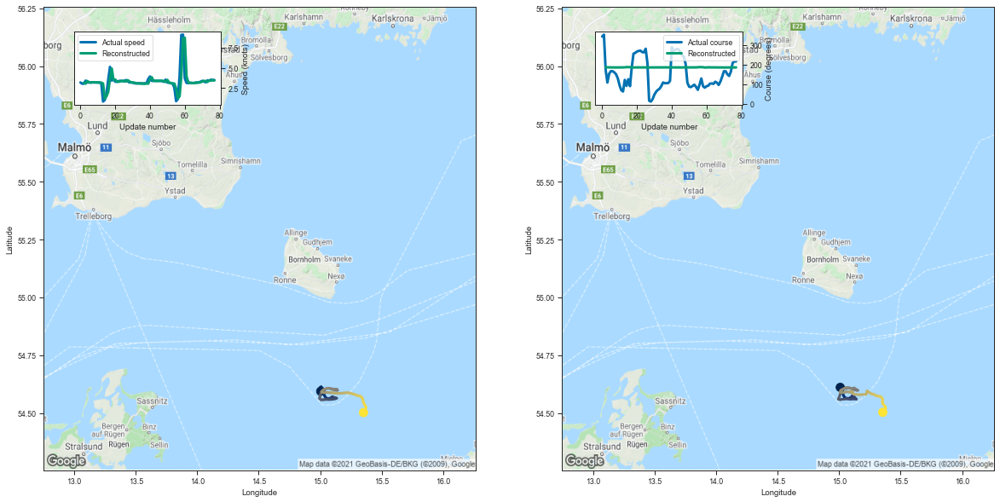

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.009362  54.610752  3.170962  186.398407         0.006583   
3   15.002593  54.605606  3.049867  186.549408         0.005658   
4   15.024006  54.612415  3.376773  186.386398         0.005199   
5   15.023555  54.602600  3.216540  186.304123         0.004474   
6   15.027761  54.593418  3.194534  186.263031         0.004164   
..        ...        ...       ...         ...              ...   
73  15.366087  54.533302  3.259821  186.090057         0.004222   
74  15.375939  54.526867  3.444623  185.957672         0.004041   
75  15.378290  54.517975  3.420236  186.156204         0.004910   
76  15.366531  54.509869  3.492607  185.986771         0.004314   
77  15.354544  54.502819  3.443273  186.045090         0.004392   

    Latitude sigma  Speed sigma  Course sigma  
2         0.004704     0.209576     95.336611  
3         0.003873     0.334398    101.587011  
4         0.003560     0.300831    102.487128  
5  

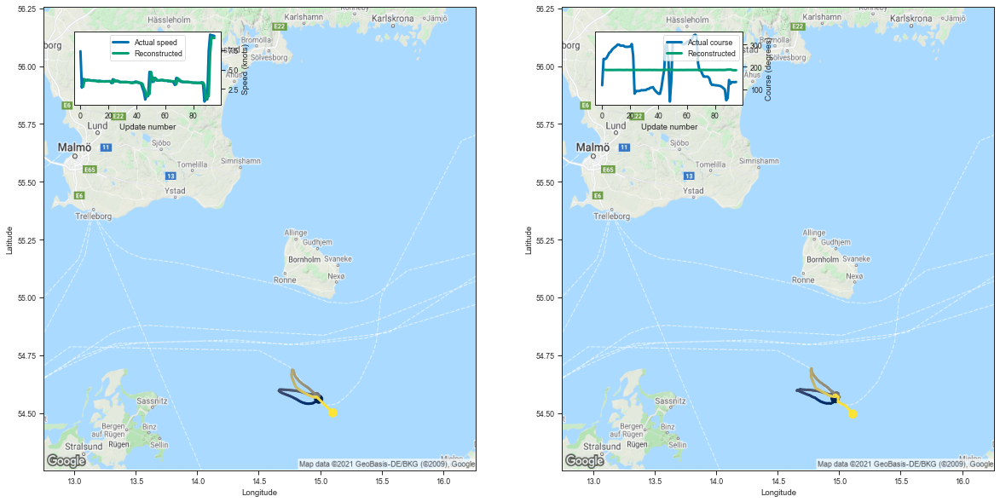

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   14.967410  54.562000  2.793177  186.925537         0.009721   
3   14.964156  54.549671  3.757139  186.137634         0.005046   
4   14.950580  54.546299  3.569161  186.082336         0.003955   
5   14.933860  54.541077  3.608537  186.237411         0.004484   
6   14.917414  54.541870  3.653149  186.225662         0.004503   
..        ...        ...       ...         ...              ...   
91  14.992455  54.569611  1.560585  188.337967         0.019991   
92  14.991235  54.548271  7.093464  186.382660         0.022385   
93  15.049171  54.532475  9.196758  185.292282         0.015546   
94  15.081166  54.515305  9.106497  185.201324         0.013327   
95  15.110656  54.495529  9.059597  185.305206         0.014605   

    Latitude sigma  Speed sigma  Course sigma  
2         0.006540     0.588808     96.555537  
3         0.003513     0.155738     99.279814  
4         0.002771     0.113374    101.595572  
5  

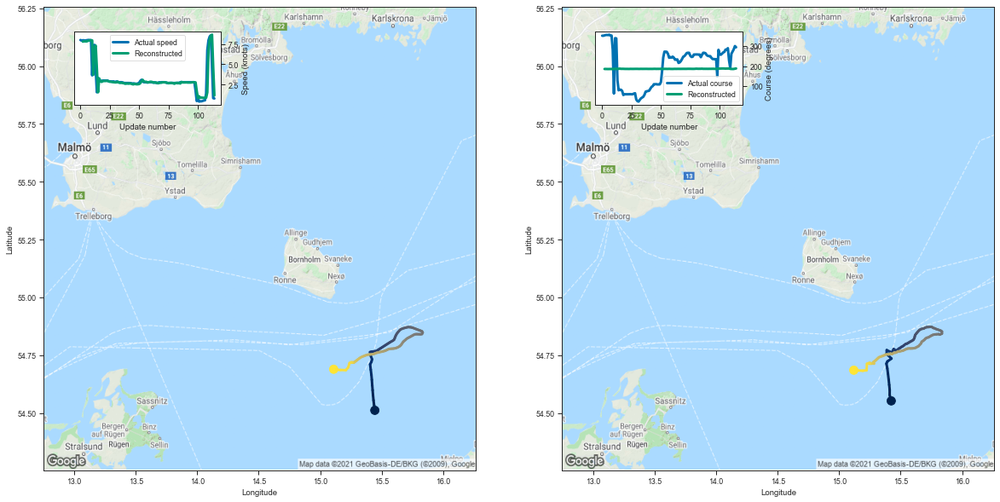

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.423550  54.552349  7.797407  185.512405         0.020517   
3    15.410780  54.577904  7.825883  185.504562         0.016676   
4    15.411199  54.599720  7.838391  185.299683         0.013109   
5    15.407248  54.621555  7.815127  185.162842         0.010875   
6    15.402847  54.644249  7.865549  185.337799         0.012842   
..         ...        ...       ...         ...              ...   
110  15.223060  54.684681  7.975932  185.553055         0.015386   
111  15.192257  54.682644  8.478028  185.385330         0.014426   
112  15.148481  54.683941  8.656603  185.548187         0.017238   
113  15.104313  54.692184  4.684276  186.862930         0.014850   
114  15.119425  54.685081  1.163146  187.982346         0.013721   

     Latitude sigma  Speed sigma  Course sigma  
2          0.011969     1.021634     95.416219  
3          0.009495     1.163024     99.967675  
4          0.007675     0.788889    

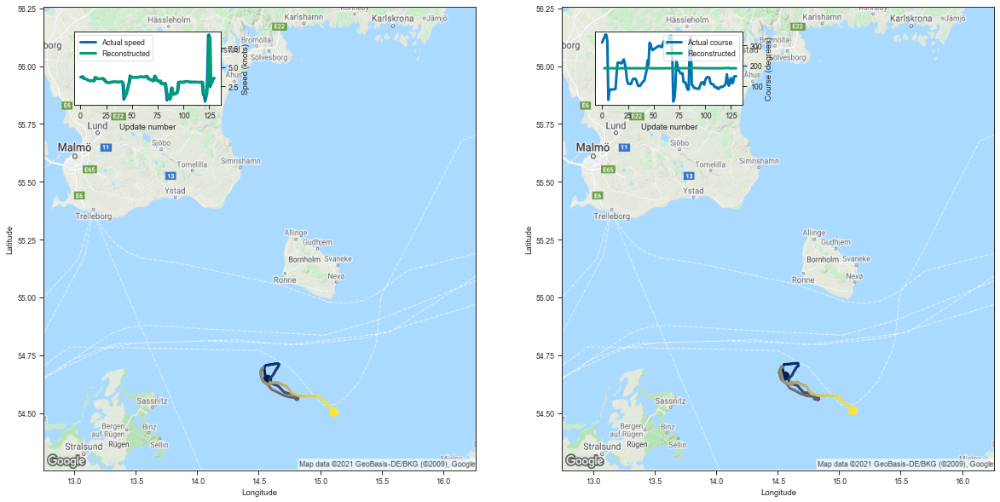

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.560261  54.659760  3.832951  186.536072         0.006994   
3    14.549569  54.671059  3.754299  186.549988         0.005578   
4    14.543604  54.682716  3.513587  186.478317         0.004550   
5    14.540191  54.693882  3.482108  186.603302         0.004964   
6    14.540688  54.697948  3.463699  186.669785         0.005312   
..         ...        ...       ...         ...              ...   
126  15.083763  54.525436  8.918159  185.829391         0.023496   
127  15.093991  54.526516  2.834519  186.825668         0.007223   
128  15.102439  54.525711  2.995889  186.575211         0.005812   
129  15.104621  54.516850  3.485551  186.464615         0.006106   
130  15.112580  54.509144  3.557667  186.206726         0.004824   

     Latitude sigma  Speed sigma  Course sigma  
2          0.004820     0.224859     95.944070  
3          0.003794     0.243944    100.637014  
4          0.003156     0.168945    

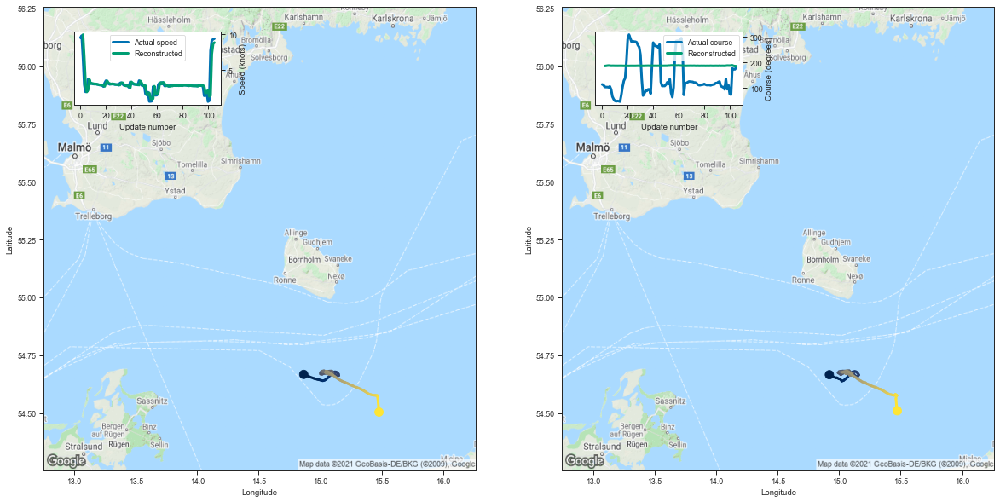

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.920703  54.665398  9.969406  185.480957         0.027673   
3    14.971125  54.652035  6.813132  186.060593         0.014423   
4    14.982691  54.652309  3.061213  186.863480         0.007635   
5    14.997843  54.647717  1.911849  187.342590         0.008125   
6    15.006207  54.647453  2.178853  187.070221         0.006866   
..         ...        ...       ...         ...              ...   
101  15.456954  54.580845  1.305665  187.548767         0.011179   
102  15.464867  54.577271  1.414947  188.318970         0.024550   
103  15.461910  54.561272  7.259920  186.024765         0.024107   
104  15.466616  54.530430  8.680088  185.283264         0.017525   
105  15.472825  54.509480  8.852085  185.014679         0.013706   

     Latitude sigma  Speed sigma  Course sigma  
2          0.015202     1.570691     97.293938  
3          0.008388     1.218134    100.885697  
4          0.004970     0.769972    

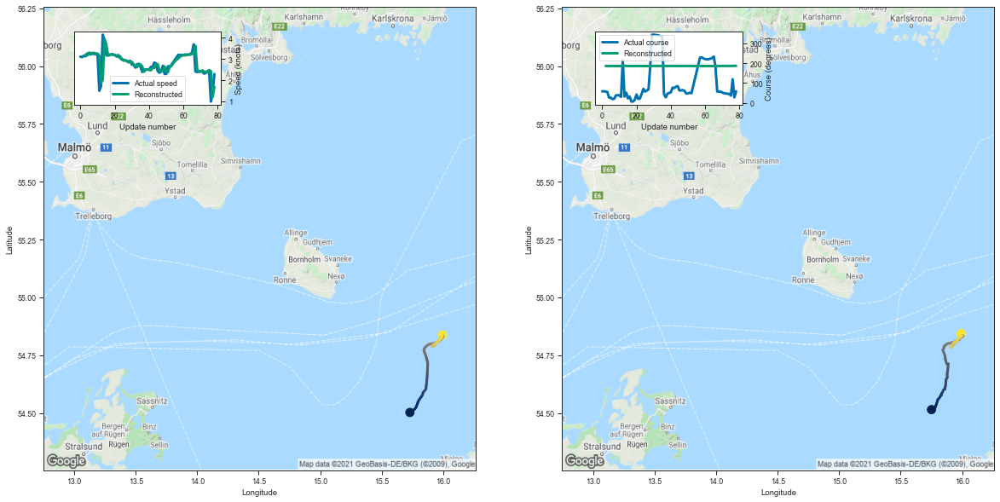

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.751011  54.514404  3.124938  185.888809         0.006236   
3   15.766388  54.518108  3.201361  185.930420         0.005387   
4   15.781966  54.524178  3.174004  185.765396         0.004345   
5   15.787159  54.533241  3.302862  185.606674         0.003703   
6   15.791954  54.539520  3.280148  185.773209         0.004265   
..        ...        ...       ...         ...              ...   
74  15.978373  54.826096  2.422404  186.001572         0.004767   
75  15.986885  54.829388  2.475088  185.958817         0.004620   
76  15.994509  54.835533  2.424501  186.282196         0.006439   
77  15.979326  54.836349  1.202038  186.909470         0.007933   
78  15.991336  54.843403  1.684575  186.479553         0.006267   

    Latitude sigma  Speed sigma  Course sigma  
2         0.004364     0.154063     96.089975  
3         0.003650     0.231717    101.296961  
4         0.002981     0.144633    101.836045  
5  

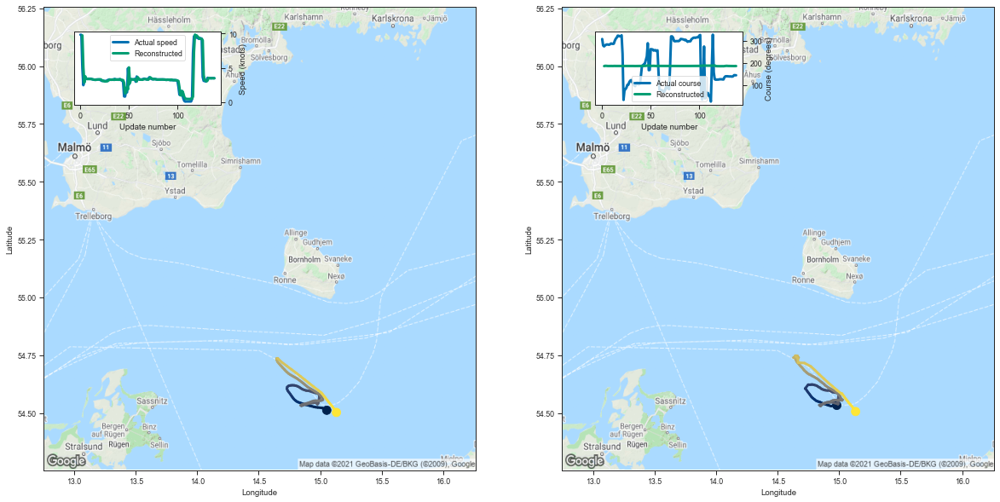

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.981000  54.532848  9.714683  185.740570         0.034711   
3    14.965676  54.534245  5.086379  186.925278         0.018762   
4    14.952245  54.532162  2.830737  186.928528         0.008107   
5    14.935605  54.529491  3.751958  186.425262         0.006304   
6    14.916752  54.532642  3.382799  186.163895         0.003989   
..         ...        ...       ...         ...              ...   
134  15.091530  54.536377  3.478883  186.310471         0.004920   
135  15.101855  54.529854  3.462998  186.241974         0.004681   
136  15.113466  54.521809  3.484734  185.936539         0.003471   
137  15.124367  54.514053  3.472646  186.180038         0.004313   
138  15.133896  54.506302  3.471459  185.990067         0.003653   

     Latitude sigma  Speed sigma  Course sigma  
2          0.018464     2.169516     98.485331  
3          0.010551     2.184495    102.915526  
4          0.005253     0.675686    

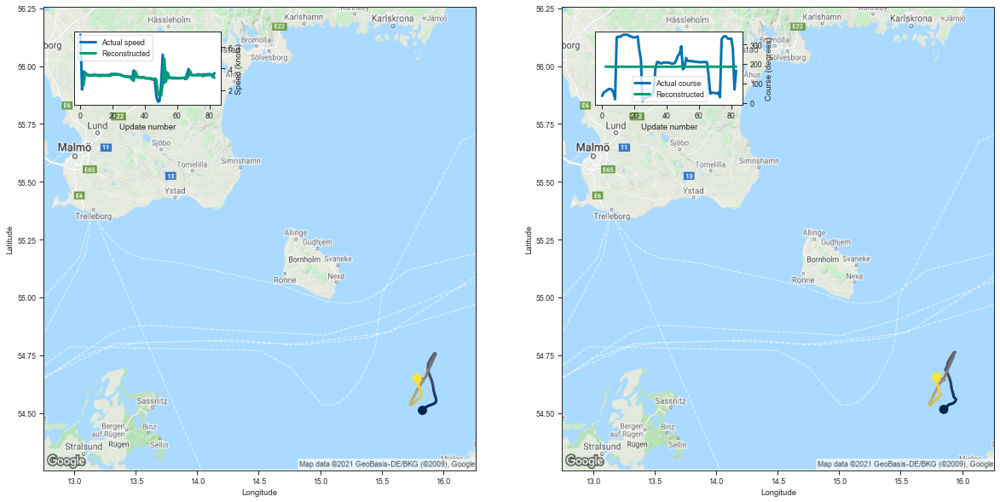

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.850817  54.515545  2.467104  186.934128         0.016071   
3   15.878739  54.527092  3.638144  185.694733         0.005966   
4   15.885007  54.532818  3.473492  185.623932         0.004587   
5   15.897406  54.537746  3.328910  185.737152         0.004722   
6   15.912254  54.538906  3.348627  185.702164         0.004606   
..        ...        ...       ...         ...              ...   
79  15.792391  54.627209  3.381739  185.570297         0.003685   
80  15.783648  54.635468  3.410286  185.691177         0.004145   
81  15.774985  54.642868  3.432436  185.441849         0.003240   
82  15.766768  54.647377  3.389925  185.844482         0.004665   
83  15.794918  54.656464  3.148428  185.858582         0.004465   

    Latitude sigma  Speed sigma  Course sigma  
2         0.009798     1.427843     97.764405  
3         0.004007     0.180963     98.653374  
4         0.003118     0.148174    101.561587  
5  

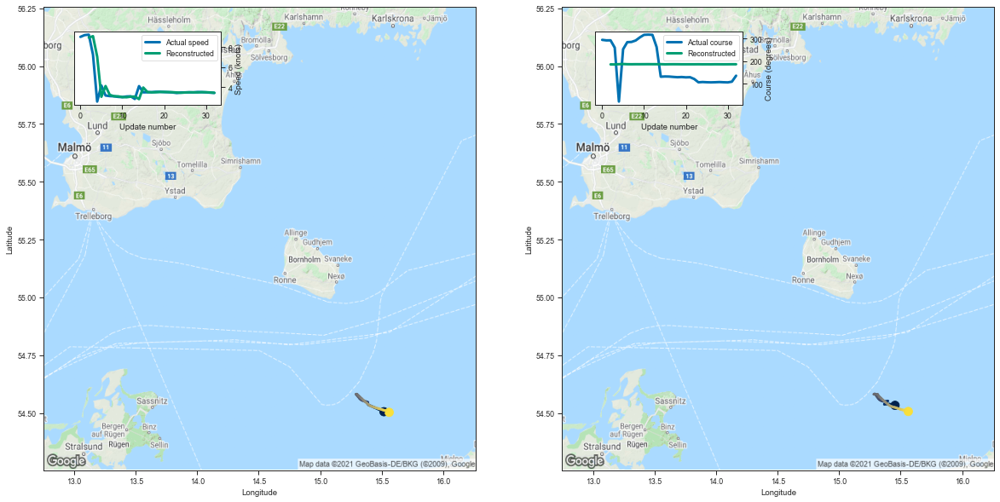

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.454708  54.533009  8.947280  185.368683         0.027462   
3   15.408919  54.538380  9.085220  185.134079         0.018253   
4   15.367698  54.537785  7.043885  186.338791         0.026339   
5   15.395467  54.551926  3.039367  186.921097         0.011001   
6   15.376496  54.549984  4.110069  186.135284         0.007263   
7   15.357669  54.550640  3.231264  185.919769         0.003892   
8   15.342715  54.553127  3.090705  186.145203         0.004304   
9   15.328629  54.557259  3.082182  186.101822         0.004095   
10  15.318682  54.562328  3.008673  186.188171         0.004285   
11  15.309780  54.569225  2.990843  186.310059         0.004824   
12  15.299006  54.576946  3.051210  186.154694         0.004255   
13  15.289757  54.582466  3.056346  186.196854         0.004353   
14  15.282416  54.580883  2.804768  186.264084         0.004225   
15  15.312111  54.581120  3.960209  185.716492         0.00373

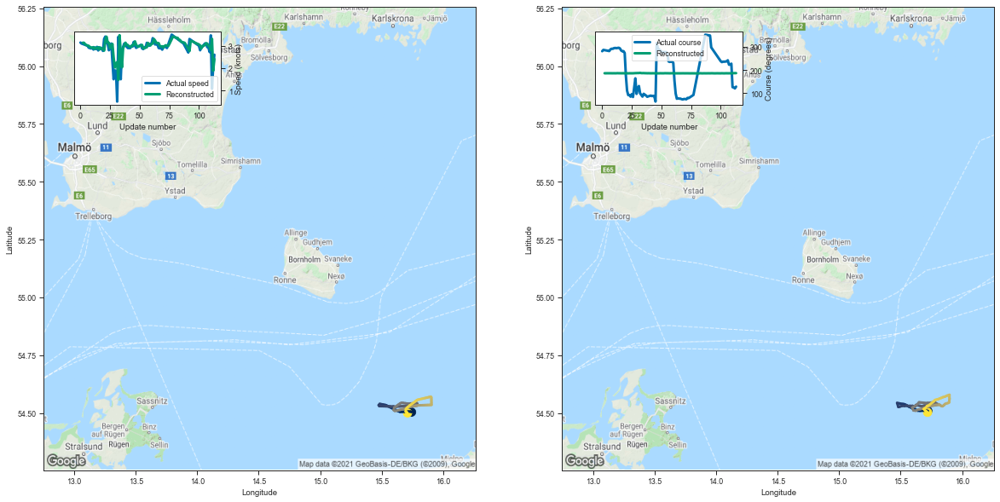

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    15.721107  54.508987  3.137437  186.074478         0.007616   
3    15.707298  54.509930  3.133931  185.959488         0.005399   
4    15.690207  54.510468  3.070325  186.112534         0.005674   
5    15.672939  54.510056  3.034241  186.104065         0.005463   
6    15.657399  54.509563  3.013759  186.102554         0.005281   
..         ...        ...       ...         ...              ...   
109  15.694957  54.518307  2.974529  186.031219         0.004764   
110  15.687973  54.516731  2.813618  186.075790         0.004732   
111  15.708399  54.504463  3.312563  186.528458         0.008814   
112  15.703542  54.509235  1.879525  186.648315         0.006649   
113  15.719256  54.502895  2.405761  186.548035         0.007026   

     Latitude sigma  Speed sigma  Course sigma  
2          0.005156     0.254509     96.381541  
3          0.003647     0.207996    100.711342  
4          0.003746     0.318513    

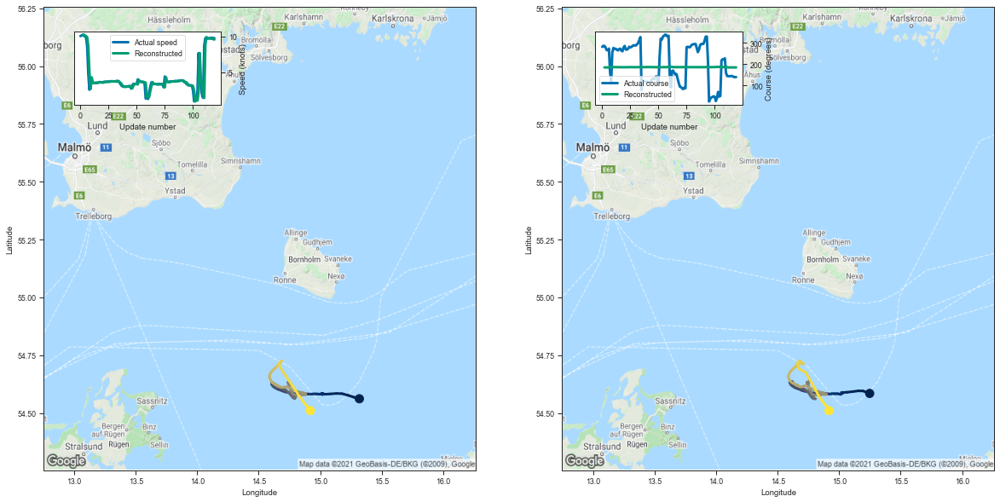

     Longitude   Latitude      Speed      Course  Longitude sigma  \
2    15.248217  54.584480  10.205994  184.990005         0.024309   
3    15.194224  54.595188  10.268713  185.163467         0.023266   
4    15.156129  54.595589  10.165619  185.190170         0.021732   
5    15.112324  54.592510  10.065762  184.916992         0.015332   
6    15.066076  54.589703   9.898416  184.883606         0.013087   
..         ...        ...        ...         ...              ...   
115  14.804527  54.602654   9.751081  185.090256         0.012068   
116  14.828188  54.579601   9.704971  184.937836         0.010281   
117  14.857390  54.555801   9.693735  184.978745         0.010764   
118  14.887993  54.534023   9.633429  185.215485         0.013613   
119  14.918343  54.509998   9.585342  185.048813         0.011765   

     Latitude sigma  Speed sigma  Course sigma  
2          0.013698     1.029614     95.799652  
3          0.012584     1.543509    100.818506  
4          0.011700     

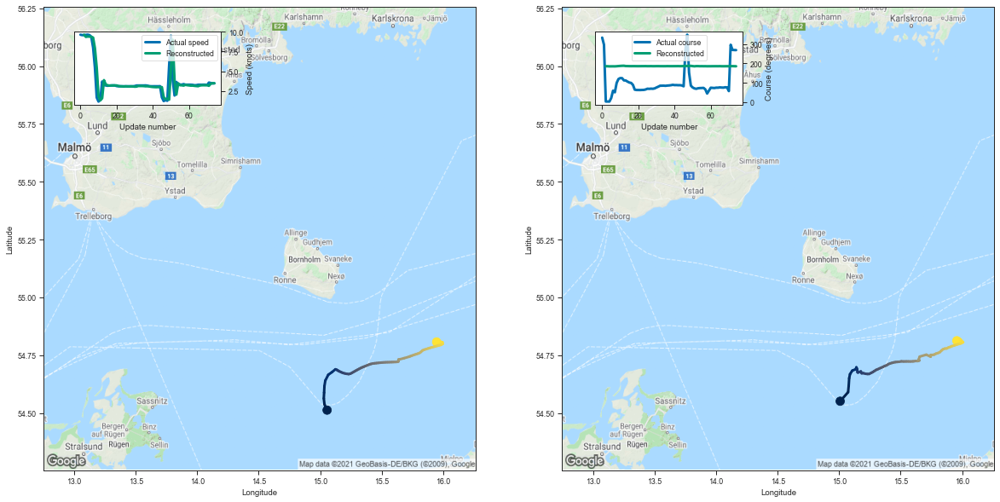

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.008551  54.550819  9.634594  185.601852         0.030287   
3   15.073061  54.589943  9.355694  185.487061         0.021280   
4   15.077913  54.617573  9.399137  184.876617         0.011252   
5   15.081809  54.650234  9.388252  184.969879         0.011691   
6   15.088357  54.667652  9.374540  185.062119         0.012692   
..        ...        ...       ...         ...              ...   
70  15.994011  54.801365  3.240921  185.517609         0.003930   
71  16.007908  54.805672  3.157725  186.012024         0.006372   
72  15.985235  54.818974  3.429802  186.042572         0.008112   
73  15.970751  54.815308  3.489340  185.669937         0.005655   
74  15.956705  54.812386  3.477475  185.349716         0.003720   

    Latitude sigma  Speed sigma  Course sigma  
2         0.016464     1.749736     97.606512  
3         0.011501     1.602684    101.523844  
4         0.006631     0.446006    100.002051  
5  

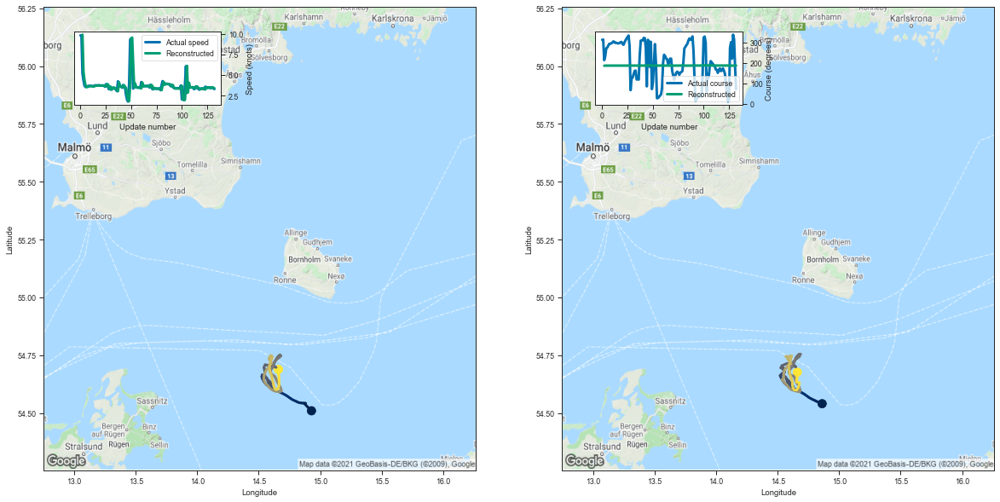

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.861800  54.540077  9.887550  185.701874         0.032220   
3    14.879910  54.544575  5.402563  186.146957         0.009044   
4    14.873367  54.543503  4.378276  186.550934         0.008505   
5    14.848100  54.545494  3.759926  186.198181         0.004675   
6    14.833624  54.546272  3.520075  186.363388         0.004764   
..         ...        ...       ...         ...              ...   
128  14.654636  54.647060  3.458876  186.432037         0.004329   
129  14.660243  54.648781  3.428646  186.300766         0.003815   
130  14.655566  54.667511  3.514406  186.263382         0.003723   
131  14.651140  54.675724  3.469234  186.161652         0.003292   
132  14.659876  54.676575  3.401157  186.548477         0.004667   

     Latitude sigma  Speed sigma  Course sigma  
2          0.017275     1.897129     98.348680  
3          0.005668     0.498876     99.981077  
4          0.005343     0.716175    

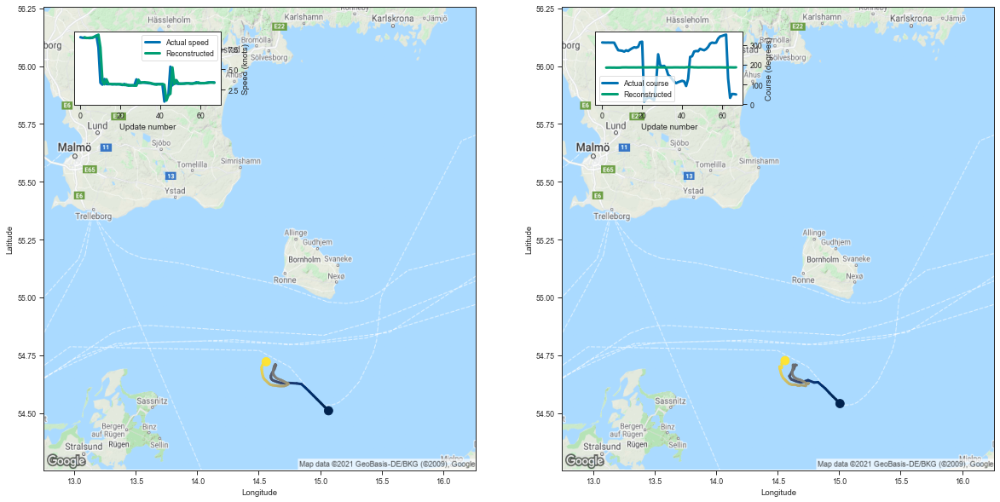

    Longitude   Latitude     Speed      Course  Longitude sigma  \
2   15.006926  54.540638  8.954523  185.263687         0.017194   
3   14.974457  54.558460  8.861053  185.566345         0.017918   
4   14.949143  54.571518  8.874424  185.670288         0.019160   
5   14.921156  54.586689  8.908247  185.376007         0.014133   
6   14.886865  54.606258  8.911356  185.561371         0.016025   
..        ...        ...       ...         ...              ...   
63  14.515173  54.700459  3.317031  186.361603         0.003494   
64  14.533365  54.695312  3.351162  186.824402         0.005646   
65  14.533400  54.714527  3.391534  186.569748         0.004545   
66  14.543760  54.719452  3.388874  186.371445         0.003703   
67  14.560320  54.726540  3.349324  186.814957         0.005614   

    Latitude sigma  Speed sigma  Course sigma  
2         0.010172     0.630028     95.649946  
3         0.009991     1.267183    101.414397  
4         0.010568     1.522441    102.266927  
5  

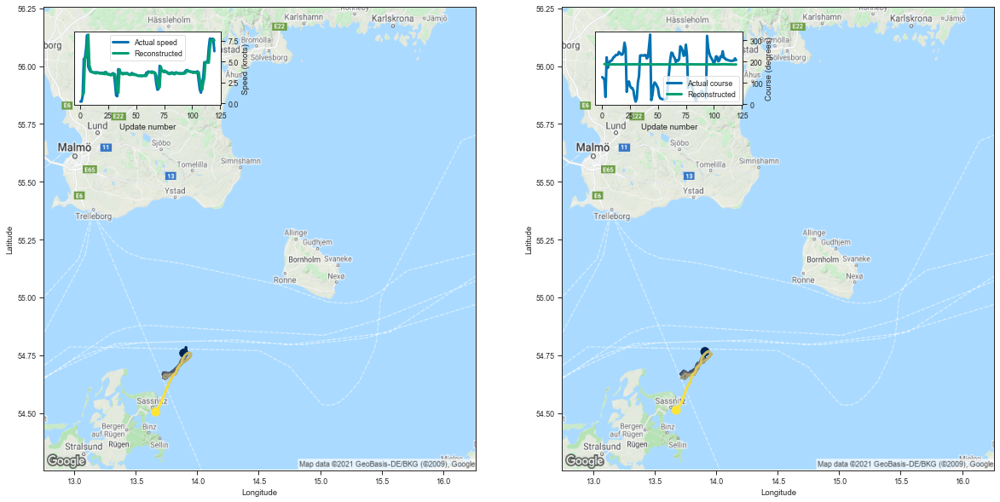

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    13.909627  54.765160  0.960348  188.590073         0.011770   
3    13.890222  54.763191  1.253367  188.960037         0.016125   
4    13.922991  54.768978  5.332690  187.029282         0.010905   
5    13.916159  54.763897  5.491114  186.970032         0.010235   
6    13.911188  54.773472  6.506329  186.575089         0.009583   
..         ...        ...       ...         ...              ...   
116  13.745454  54.585117  6.625880  186.715683         0.010632   
117  13.733533  54.568275  7.531487  186.668884         0.013331   
118  13.719955  54.546780  7.552602  186.438095         0.010648   
119  13.698694  54.528721  7.544886  186.477432         0.010841   
120  13.675113  54.512131  7.528719  186.906372         0.016282   

     Latitude sigma  Speed sigma  Course sigma  
2          0.007547     1.320882     99.723730  
3          0.009150     2.785204    105.295005  
4          0.006692     0.852455    

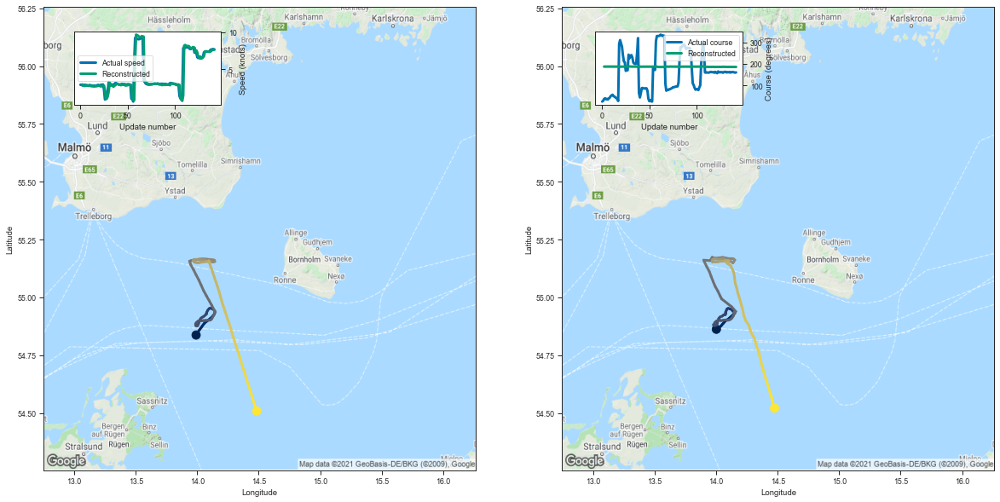

     Longitude   Latitude     Speed      Course  Longitude sigma  \
2    14.002113  54.862087  2.924435  187.395752         0.007933   
3    14.008430  54.863186  2.725410  187.218201         0.005293   
4    14.021945  54.867752  2.720573  187.444321         0.006332   
5    14.029948  54.872341  2.708095  187.373520         0.005960   
6    14.040796  54.876602  2.797388  187.194992         0.005150   
..         ...        ...       ...         ...              ...   
138  14.430449  54.601608  7.395794  186.141235         0.012070   
139  14.443745  54.579655  7.593635  185.696335         0.008334   
140  14.452765  54.563911  7.586161  185.798340         0.009087   
141  14.463250  54.541721  7.632111  185.848892         0.009734   
142  14.475027  54.520817  7.636709  185.807755         0.009504   

     Latitude sigma  Speed sigma  Course sigma  
2          0.005243     0.428072     97.210769  
3          0.003529     0.251399    100.582823  
4          0.004032     0.502307    

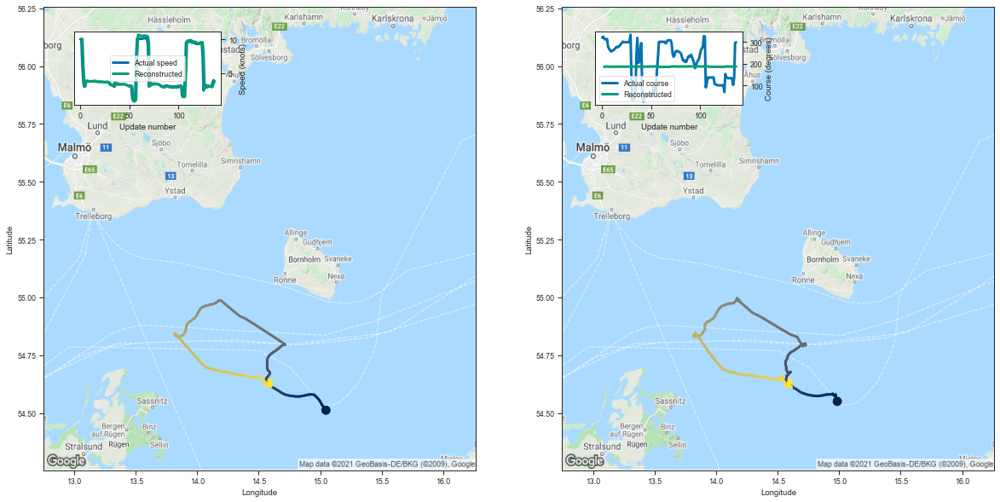

In [ ]:
# Focus on the overall n=100 best reconstructions
data = summary_models.run_evaluation_get_n(n=100, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(100): 
    tracks = plot_actual_reconstructed(idx)
    print(list(tracks["Reconstructed trajectory"]["Speed"])[:4])
df_n